# SignSetu Dataset EDA

This notebook analyzes video files in the SignSetu dataset to extract video metadata, analyze sequence length distributions, and perform landmark detection using MediaPipe.

## Environment Setup

### For Local Conda Environment:
**⚠️ Important: MediaPipe requires Python 3.8-3.11 (not 3.12+)**

1. Create a conda environment with compatible Python version:
   ```bash
   conda create -n signsetu python=3.10
   conda activate signsetu
   ```

2. Install required packages:
   ```bash
   conda install -c conda-forge opencv matplotlib numpy pandas seaborn scikit-learn jupyter ipykernel
   pip install mediapipe
   ```

3. If you encounter MediaPipe installation issues, try specific versions:
   ```bash
   pip install mediapipe==0.10.7
   # or
   pip install mediapipe==0.10.3
   ```

4. Ensure the dataset is in the same workspace directory as this notebook

**Troubleshooting:**
- If MediaPipe fails to import, check your Python version with `python --version`
- MediaPipe 0.10.7 is known to work well with Python 3.10
- For Python 3.11, try MediaPipe 0.10.3

### For Google Colab:
- The notebook will automatically handle package installation and dataset download
- Google Colab typically uses Python 3.10, which is compatible with MediaPipe


In [70]:
import os
import sys

# Check if running in Google Colab
def is_colab():
    try:
        import google.colab
        return True
    except ImportError:
        return False

# Environment setup and information
if is_colab():
    print("🚀 Running in Google Colab environment")
    from google.colab import userdata
    
    # Set Kaggle API credentials from Colab secrets
    os.environ['KAGGLE_USERNAME'] = userdata.get('KAGGLE_USERNAME')
    os.environ['KAGGLE_KEY'] = userdata.get('KAGGLE_KEY')
    
    # Create the .kaggle directory
    !mkdir -p ~/.kaggle
    
    # Write the kaggle.json file
    !echo '{ "username": "'$KAGGLE_USERNAME'", "key": "'$KAGGLE_KEY'" }' > ~/.kaggle/kaggle.json
    
    # Set the file permissions
    !chmod 600 ~/.kaggle/kaggle.json
else:
    print("💻 Running in local conda environment")
    print("📁 Dataset should be available in: SignSetu Dataset/Character/")
    print("📦 Required packages: mediapipe, opencv-python, matplotlib, numpy")
    print("🔧 Make sure these are installed in your conda environment")

💻 Running in local conda environment
📁 Dataset should be available in: SignSetu Dataset/Character/
📦 Required packages: mediapipe, opencv-python, matplotlib, numpy
🔧 Make sure these are installed in your conda environment


In [71]:
# Verify dataset path exists (for local environment)
if not is_colab():
    dataset_path = 'SignSetu Dataset/Character'
    if os.path.exists(dataset_path):
        print(f"✅ Dataset found at: {dataset_path}")
        # List the contents to verify
        contents = os.listdir(dataset_path)
        print(f"📂 Contents: {contents}")
    else:
        print(f"❌ Dataset not found at: {dataset_path}")
        print("Please ensure the SignSetu Dataset folder is in the same directory as this notebook")
        print("Expected structure: SignSetu Dataset/Character/Goa Board of Education/")
else:
    print("Running in Colab - dataset will be downloaded automatically")


✅ Dataset found at: SignSetu Dataset/Character
📂 Contents: ['Goa Board of Education']


In [72]:
# Check Python version and all required packages
import sys
import os

print(f"🐍 Python version: {sys.version}")
print(f"📍 Python executable: {sys.executable}")
print(f"📂 Current working directory: {os.getcwd()}")

# Check if we're in a conda environment
conda_env = os.environ.get('CONDA_DEFAULT_ENV', 'Not in conda environment')
print(f"🌍 Conda environment: {conda_env}")

python_version = sys.version_info

# Check if Python version is compatible with MediaPipe
if python_version.major == 3 and 8 <= python_version.minor <= 11:
    print("✅ Python version is compatible with MediaPipe")
else:
    print("❌ Python version may not be compatible with MediaPipe")
    print("   MediaPipe requires Python 3.8-3.11")
    print("   Please create a new conda environment with: conda create -n signsetu python=3.10")

# Check all required packages
required_packages = {
    'pandas': 'pandas',
    'numpy': 'numpy', 
    'matplotlib': 'matplotlib.pyplot',
    'seaborn': 'seaborn',
    'opencv': 'cv2',
    'mediapipe': 'mediapipe',
    'sklearn': 'sklearn',
    'hdbscan': 'hdbscan'
}

print("\n📦 Checking required packages:")
all_packages_ok = True

for package_name, import_name in required_packages.items():
    try:
        if package_name == 'matplotlib':
            import matplotlib.pyplot as plt
        elif package_name == 'opencv':
            import cv2
        else:
            __import__(import_name)
        print(f"✅ {package_name}: OK")
    except ImportError as e:
        print(f"❌ {package_name}: MISSING - {e}")
        all_packages_ok = False

if all_packages_ok:
    print("\n🎉 All packages are available!")
else:
    print("\n⚠️  Some packages are missing. Please run:")
    print("conda activate signsetu")
    print("conda install -c conda-forge pandas matplotlib numpy opencv seaborn scikit-learn jupyter ipykernel")
    print("pip install mediapipe hdbscan")
    print("python -m ipykernel install --user --name signsetu --display-name 'Python (signsetu)'")


🐍 Python version: 3.10.18 | packaged by Anaconda, Inc. | (main, Jun  5 2025, 13:08:55) [MSC v.1929 64 bit (AMD64)]
📍 Python executable: c:\Users\user\anaconda3\envs\signsetu\python.exe
📂 Current working directory: c:\Users\user\Downloads\jupyter
🌍 Conda environment: signsetu
✅ Python version is compatible with MediaPipe

📦 Checking required packages:
✅ pandas: OK
✅ numpy: OK
✅ matplotlib: OK
✅ seaborn: OK
✅ opencv: OK
✅ mediapipe: OK
✅ sklearn: OK
✅ hdbscan: OK

🎉 All packages are available!


In [73]:
# Check if running in Google Colab
def is_colab():
    try:
        import google.colab
        return True
    except ImportError:
        return False

# Only download dataset if running in Colab
if is_colab():
    !kaggle datasets download -d abhishek1102/signsetu-dataset
else:
    print("Running in local environment - using local dataset")

Running in local environment - using local dataset


In [74]:
# Only unzip dataset if running in Colab
if is_colab():
    !unzip -o signsetu-dataset.zip
else:
    print("Running in local environment - dataset already available")

Running in local environment - dataset already available


# Task
Analyze video files in the signsetu dataset to extract video durations and frame counts for each sign class, create histograms showing sequence length distributions, and calculate percentiles (25th, 50th, 75th, 95th) for both duration and frame count.

## List video files and their extensions

### Subtask:
Traverse the directories to find all video files and list their extensions.


**Reasoning**:
Traverse the directories to find all video files and list their extensions.



In [75]:
import os

# Define the root directory where the video files are located
# Use different paths for Colab vs local environment
if is_colab():
    root_dir = '/content/Character'
else:
    # For local environment, use the dataset in the same workspace
    root_dir = 'SignSetu Dataset/Character'

# Initialize an empty list to store the paths of the video files found
video_files = []

# Use os.walk() to traverse the root directory and its subdirectories
for dirpath, dirnames, filenames in os.walk(root_dir):
    for filename in filenames:
        # Check if the file extension indicates a video file (e.g., .mp4)
        if filename.lower().endswith('.mp4'):
            # If the file is a video, append its full path to the list
            video_files.append(os.path.join(dirpath, filename))

# Print the total number of video files found and list a few examples
print(f"Total number of video files found: {len(video_files)}")
print("Examples of video file paths:")
for i in range(min(5, len(video_files))):
    print(video_files[i])

Total number of video files found: 26
Examples of video file paths:
SignSetu Dataset/Character\Goa Board of Education\A.mp4
SignSetu Dataset/Character\Goa Board of Education\B.mp4
SignSetu Dataset/Character\Goa Board of Education\C.mp4
SignSetu Dataset/Character\Goa Board of Education\D.mp4
SignSetu Dataset/Character\Goa Board of Education\E.mp4


## Extract video metadata

### Subtask:
For each video file, extract its duration and frame count.


**Reasoning**:
Extract duration and frame count for each video file using OpenCV.



In [76]:
import cv2

# Initialize empty lists to store video durations and frame counts
video_durations = []
video_frame_counts = []

# Iterate through the list of video file paths
for video_file in video_files:
    # Use cv2.VideoCapture() to open the video file
    cap = cv2.VideoCapture(video_file)

    # Check if the video was opened successfully
    if not cap.isOpened():
        print(f"Error: Could not open video file {video_file}")
        continue

    # Get the frame rate (frames per second)
    fps = cap.get(cv2.CAP_PROP_FPS)

    # Get the total number of frames
    frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

    # Calculate the duration in seconds, handling division by zero
    duration = frame_count / fps if fps > 0 else 0

    # Append the calculated duration and the total frame count to their respective lists
    video_durations.append(duration)
    video_frame_counts.append(frame_count)

    # Release the video capture object
    cap.release()

# After processing all video files, print the number of videos for which metadata was successfully extracted
print(f"Successfully extracted metadata for {len(video_durations)} videos.")

# Display the first few extracted durations and frame counts as a verification step
print("First 5 extracted durations (seconds):")
print(video_durations[:5])
print("First 5 extracted frame counts:")
print(video_frame_counts[:5])

Successfully extracted metadata for 26 videos.
First 5 extracted durations (seconds):
[7.24, 7.24, 7.24, 7.24, 7.24]
First 5 extracted frame counts:
[181, 181, 181, 181, 181]


## Analyze sequence length distribution

### Subtask:
Calculate percentiles (25th, 50th, 75th, 95th) for duration and frame count.


**Reasoning**:
Calculate the percentiles for both duration and frame count using numpy and print the results.



In [77]:
import numpy as np

# Calculate percentiles for video durations
duration_percentiles = np.percentile(video_durations, [25, 50, 75, 95])

# Calculate percentiles for video frame counts
frame_count_percentiles = np.percentile(video_frame_counts, [25, 50, 75, 95])

# Print the calculated percentiles
print("Duration Percentiles (25th, 50th, 75th, 95th):")
print(duration_percentiles)

print("\nFrame Count Percentiles (25th, 50th, 75th, 95th):")
print(frame_count_percentiles)

Duration Percentiles (25th, 50th, 75th, 95th):
[7.04 7.04 7.04 7.24]

Frame Count Percentiles (25th, 50th, 75th, 95th):
[176. 176. 176. 181.]


## Visualize sequence length distribution

### Subtask:
Create histograms to show the distribution of video durations and frame counts.


**Reasoning**:
Create and display histograms for video durations and frame counts.



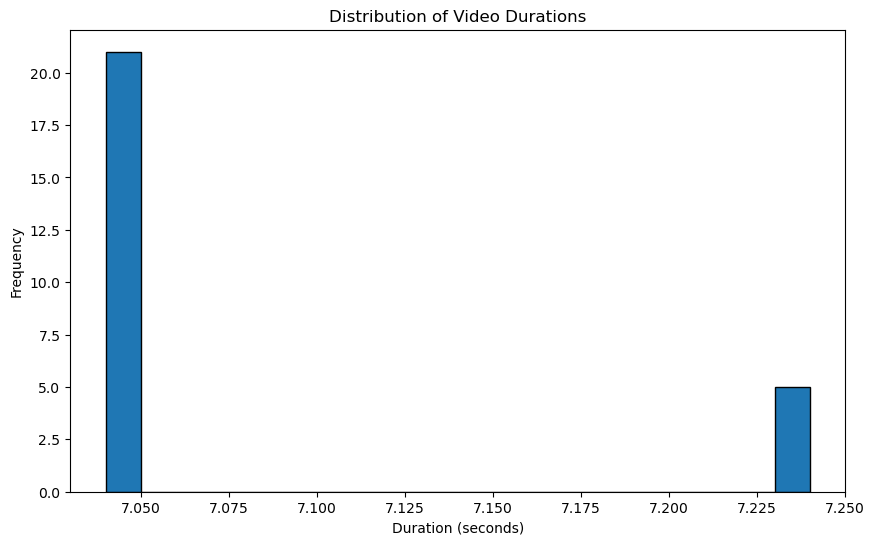

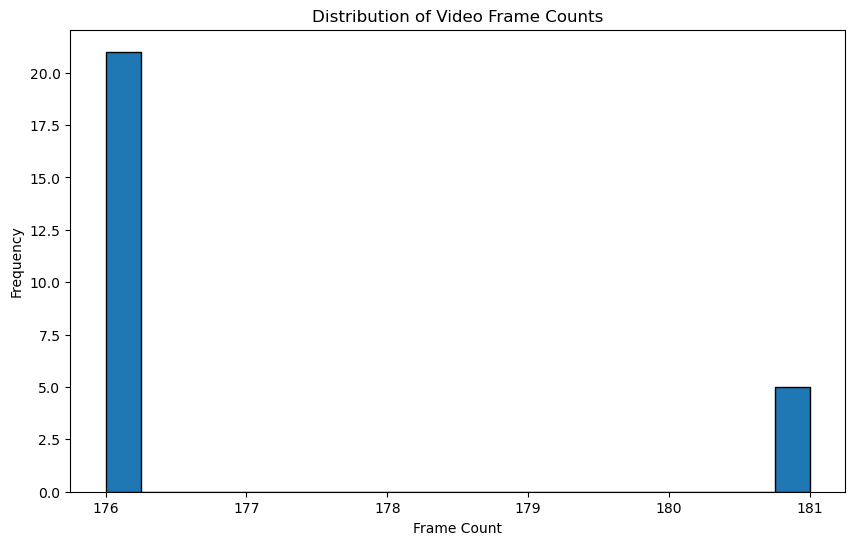

In [78]:
import matplotlib.pyplot as plt

# Create a histogram of the video_durations list
plt.figure(figsize=(10, 6))
plt.hist(video_durations, bins=20, edgecolor='black')
plt.xlabel('Duration (seconds)')
plt.ylabel('Frequency')
plt.title('Distribution of Video Durations')
plt.show()

# Create a histogram of the video_frame_counts list
plt.figure(figsize=(10, 6))
plt.hist(video_frame_counts, bins=20, edgecolor='black')
plt.xlabel('Frame Count')
plt.ylabel('Frequency')
plt.title('Distribution of Video Frame Counts')
plt.show()

# Task
Analyze video files to check for FPS consistency and extract and analyze landmark confidence scores using MediaPipe.

## Install necessary libraries

### Subtask:
Install MediaPipe and any other required libraries.


**Reasoning**:
Install the necessary libraries for the subtask.



In [79]:
# Only install packages if running in Colab
if is_colab():
    !pip install mediapipe opencv-python
else:
    print("Running in local environment - assuming packages are already installed in conda environment")
    print("Required packages: mediapipe, opencv-python, matplotlib, numpy")
    print("")
    print("If you encounter MediaPipe issues, try:")
    print("  pip install mediapipe==0.10.7")
    print("  or")
    print("  pip install mediapipe==0.10.3")

Running in local environment - assuming packages are already installed in conda environment
Required packages: mediapipe, opencv-python, matplotlib, numpy

If you encounter MediaPipe issues, try:
  pip install mediapipe==0.10.7
  or
  pip install mediapipe==0.10.3


## Check fps consistency

### Subtask:
Iterate through the video files, extract the frame rate for each, and analyze their consistency.


**Reasoning**:
Iterate through the video files, extract the frame rate for each, and analyze their consistency.



In [80]:
# Initialize an empty list to store the frame rates
frame_rates = []

# Iterate through the list of video file paths
for video_file in video_files:
    # Open the video file
    cap = cv2.VideoCapture(video_file)

    # Check if the video was opened successfully
    if not cap.isOpened():
        print(f"Error: Could not open video file {video_file}")
        continue

    # Get the frame rate
    fps = cap.get(cv2.CAP_PROP_FPS)

    # Append the frame rate to the list
    frame_rates.append(fps)

    # Release the video capture object
    cap.release()

# Analyze the consistency of the frame rates
print(f"Extracted frame rates for {len(frame_rates)} videos.")
if len(frame_rates) > 0:
    min_fps = min(frame_rates)
    max_fps = max(frame_rates)
    avg_fps = sum(frame_rates) / len(frame_rates)

    print(f"Minimum frame rate: {min_fps}")
    print(f"Maximum frame rate: {max_fps}")
    print(f"Average frame rate: {avg_fps}")

    if min_fps == max_fps:
        print("All video files have a consistent frame rate.")
    else:
        print("Video files have inconsistent frame rates.")

Extracted frame rates for 26 videos.
Minimum frame rate: 25.0
Maximum frame rate: 25.0
Average frame rate: 25.0
All video files have a consistent frame rate.


## Extract landmark confidence scores

### Subtask:
From the MediaPipe output, extract the confidence scores for each landmark across all frames.

**Reasoning**:
Iterate through the processed landmark data to extract and store the confidence scores for each detected landmark (pose, face, left hand, right hand, and pose world).

## Process videos with MediaPipe

### Subtask:
Apply MediaPipe to each video to extract landmark data and confidence scores for each frame.

**Reasoning**:
Process each video file using MediaPipe's Holistic model to detect and extract landmark data and confidence scores for pose, face, and hands.

In [81]:
import mediapipe as mp

# Initialize MediaPipe Holistic
mp_holistic = mp.solutions.holistic
mp_drawing = mp.solutions.drawing_utils

# Initialize a list to store landmark data and confidence scores
all_landmark_data = []

# Process each video file
with mp_holistic.Holistic(static_image_mode=False, min_detection_confidence=0.5, min_tracking_confidence=0.5) as holistic:
    for video_file in video_files:
        cap = cv2.VideoCapture(video_file)
        if not cap.isOpened():
            print(f"Error: Could not open video file {video_file}")
            continue

        video_landmark_data = []
        hand_detected_in_video = False # Flag to print hand data for the first detection

        while cap.isOpened():
            ret, frame = cap.read()
            if not ret:
                break

            # Convert the frame to RGB
            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

            # Process the frame with MediaPipe Holistic
            results = holistic.process(frame_rgb)

            # Store landmark data and confidence scores for the current frame
            frame_landmark_data = {
                'pose_landmarks': results.pose_landmarks,
                'face_landmarks': results.face_landmarks,
                'left_hand_landmarks': results.left_hand_landmarks,
                'right_hand_landmarks': results.right_hand_landmarks,
                'pose_world_landmarks': results.pose_world_landmarks,
            }
            video_landmark_data.append(frame_landmark_data)

        all_landmark_data.append({'video_file': video_file, 'frames': video_landmark_data})
        cap.release()

print(f"Successfully processed {len(all_landmark_data)} videos with MediaPipe.")
# You can inspect the structure of all_landmark_data if needed
# print(all_landmark_data[0])

Successfully processed 26 videos with MediaPipe.


In [82]:
# Initialize lists to store confidence scores for each landmark type
pose_confidence_scores = []
face_confidence_scores = []
left_hand_confidence_scores = []
right_hand_confidence_scores = []
pose_world_confidence_scores = []

# Iterate through the processed video data
for video_data in all_landmark_data:
    for frame_data in video_data['frames']:
        # Extract confidence scores for pose landmarks
        if frame_data['pose_landmarks']:
            for landmark in frame_data['pose_landmarks'].landmark:
                pose_confidence_scores.append(landmark.visibility) # Pose landmarks use visibility as confidence

        # Extract confidence scores for face landmarks (no confidence score available directly)
        # if frame_data['face_landmarks']:
        #     # Face landmarks do not have a confidence or visibility score per landmark in this structure
        #     pass

        # Extract confidence scores for hand landmarks
        if frame_data['left_hand_landmarks']:
            for landmark in frame_data['left_hand_landmarks'].landmark:
                # Debugging: Print the presence value before appending
                # print(f"Appending left hand presence: {landmark.presence}")
                left_hand_confidence_scores.append(landmark.presence) # Hand landmarks use presence as confidence

        if frame_data['right_hand_landmarks']:
            for landmark in frame_data['right_hand_landmarks'].landmark:
                # Debugging: Print the presence value before appending
                # print(f"Appending right hand presence: {landmark.presence}")
                right_hand_confidence_scores.append(landmark.presence) # Hand landmarks use presence as confidence

        # Extract confidence scores for pose world landmarks
        if frame_data['pose_world_landmarks']:
            for landmark in frame_data['pose_world_landmarks'].landmark:
                pose_world_confidence_scores.append(landmark.visibility) # Pose world landmarks use visibility as confidence


print(f"Extracted {len(pose_confidence_scores)} pose confidence scores.")
# print(f"Extracted {len(face_confidence_scores)} face confidence scores.") # Face landmarks not supported with confidence
print(f"Extracted {len(left_hand_confidence_scores)} left hand confidence scores.")
print(f"Extracted {len(right_hand_confidence_scores)} right hand confidence scores.")
print(f"Extracted {len(pose_world_confidence_scores)} pose world confidence scores.")

Extracted 123486 pose confidence scores.
Extracted 78582 left hand confidence scores.
Extracted 76104 right hand confidence scores.
Extracted 123486 pose world confidence scores.


## Set confidence thresholds

### Subtask:
Define and apply confidence thresholds to filter landmarks based on their scores.

**Reasoning**:
Define confidence thresholds for each landmark type (pose, left hand, right hand, and pose world) and filter the extracted confidence scores based on these thresholds.

In [83]:
# Initialize lists to store scores
# Note: Pose landmarks have per-landmark 'visibility'.
# Hands and Face do not, so we will record per-frame 'presence'.
pose_confidence_scores = []
left_hand_presence_scores = []   # Will store 1.0 for present, 0.0 for absent, per frame
right_hand_presence_scores = []  # Will store 1.0 for present, 0.0 for absent, per frame
pose_world_confidence_scores = []

# Iterate through the processed video data
for video_data in all_landmark_data:
    for frame_data in video_data['frames']:
        # Extract visibility scores for pose landmarks
        if frame_data['pose_landmarks']:
            for landmark in frame_data['pose_landmarks'].landmark:
                pose_confidence_scores.append(landmark.visibility)

        # Extract visibility scores for pose world landmarks
        if frame_data['pose_world_landmarks']:
            for landmark in frame_data['pose_world_landmarks'].landmark:
                pose_world_confidence_scores.append(landmark.visibility)

        # Check for the presence of the entire hand landmark list in each frame.
        if frame_data['left_hand_landmarks']:
            left_hand_presence_scores.append(1.0)  # Left hand is detected
        else:
            left_hand_presence_scores.append(0.0)  # Left hand is NOT detected

        if frame_data['right_hand_landmarks']:
            right_hand_presence_scores.append(1.0) # Right hand is detected
        else:
            right_hand_presence_scores.append(0.0) # Right hand is NOT detected

# --- UPDATED PRINT STATEMENTS ---
print(f"Extracted {len(pose_confidence_scores)} pose landmark visibility scores.")
print(f"Processed {len(left_hand_presence_scores)} frames, {int(sum(left_hand_presence_scores))} had a left hand.")
print(f"Processed {len(right_hand_presence_scores)} frames, {int(sum(right_hand_presence_scores))} had a right hand.")
print(f"Extracted {len(pose_world_confidence_scores)} pose world landmark visibility scores.")

Extracted 123486 pose landmark visibility scores.
Processed 4601 frames, 3742 had a left hand.
Processed 4601 frames, 3624 had a right hand.
Extracted 123486 pose world landmark visibility scores.


## Analyze landmark confidence

### Subtask:
Analyze the distribution of confidence scores and the effect of applying thresholds.

**Reasoning**:
Visualize the distribution of confidence scores using histograms before and after applying thresholds to understand the impact of filtering and analyze the overall confidence levels.

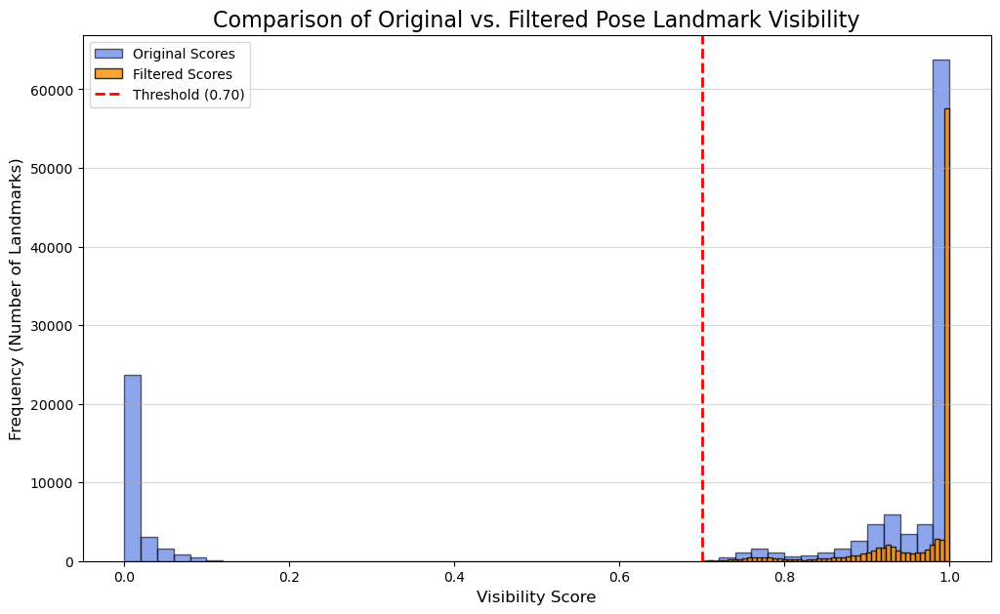

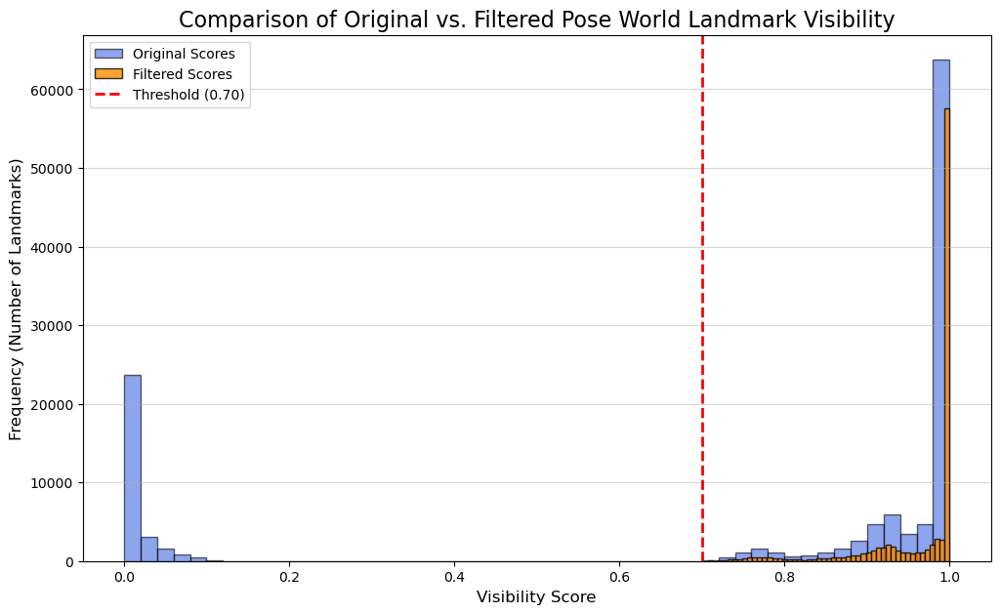

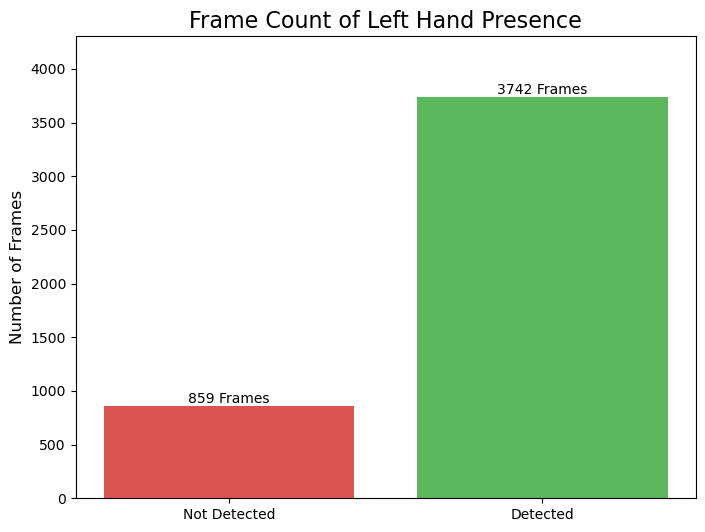

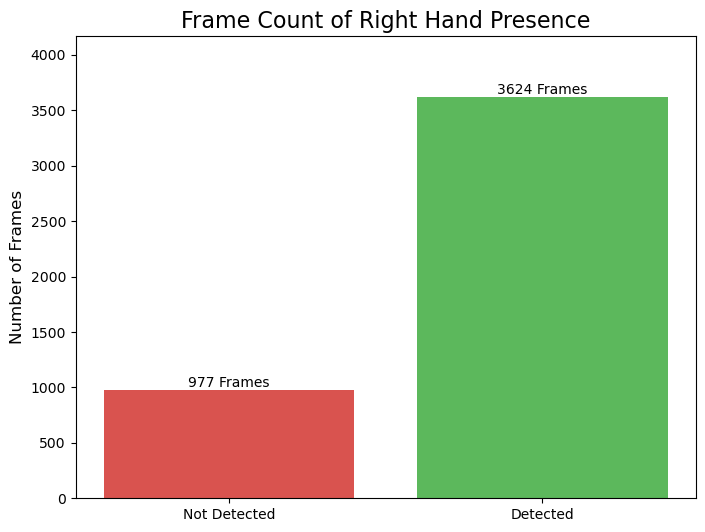

In [84]:
import matplotlib.pyplot as plt
import numpy as np
import random

# --- 1 DEFINE THRESHOLDS AND APPLY FILTERS ---
# Recommended starting value for filtering pose landmark visibility.
pose_threshold = 0.70
pose_world_threshold = 0.70

# Create new lists containing only the scores that are above the thresholds.
filtered_pose_confidence_scores = [score for score in pose_confidence_scores if score >= pose_threshold]
filtered_pose_world_confidence_scores = [score for score in pose_world_confidence_scores if score >= pose_world_threshold]


# --- 2. PLOTTING FUNCTIONS ---
def plot_comparison_histogram(original_scores, filtered_scores, threshold, title):
    """
    Plots a comparison histogram of original and filtered scores on the same axes.
    """
    plt.figure(figsize=(12, 7))

    # Plot original scores with some transparency
    plt.hist(original_scores, bins=50, alpha=0.6, label='Original Scores', color='royalblue', edgecolor='black')

    # Plot filtered scores on top
    plt.hist(filtered_scores, bins=50, alpha=0.8, label='Filtered Scores', color='darkorange', edgecolor='black')

    # Add a vertical line for the threshold
    plt.axvline(threshold, color='r', linestyle='dashed', linewidth=2, label=f'Threshold ({threshold:.2f})')

    plt.title(title, fontsize=16)
    plt.xlabel('Visibility Score', fontsize=12)
    plt.ylabel('Frequency (Number of Landmarks)', fontsize=12)
    plt.legend()
    plt.grid(axis='y', alpha=0.5)
    plt.show()

def plot_presence_bar_chart(presence_scores, title):
    """
    Creates a bar chart for binary presence data (0s and 1s).
    """
    # Count the occurrences of 0 (Not Detected) and 1 (Detected)
    counts = {
        'Not Detected': presence_scores.count(0.0),
        'Detected': presence_scores.count(1.0)
    }

    labels = list(counts.keys())
    values = list(counts.values())

    plt.figure(figsize=(8, 6))
    bars = plt.bar(labels, values, color=['#d9534f', '#5cb85c']) # Red for not detected, green for detected

    # Add text labels on top of each bar
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2.0, yval, f'{yval} Frames', va='bottom', ha='center')

    plt.title(title, fontsize=16)
    plt.ylabel('Number of Frames', fontsize=12)
    plt.ylim(0, max(values) * 1.15 if values else 1) # Add space at the top
    plt.show()


# --- 3. PLOTTING THE VISUALIZATIONS ---

# Plot for Pose Landmark Visibility
plot_comparison_histogram(
    pose_confidence_scores,
    filtered_pose_confidence_scores,
    pose_threshold,
    'Comparison of Original vs. Filtered Pose Landmark Visibility'
)

# Plot for Pose World Landmark Visibility
plot_comparison_histogram(
    pose_world_confidence_scores,
    filtered_pose_world_confidence_scores,
    pose_world_threshold,
    'Comparison of Original vs. Filtered Pose World Landmark Visibility'
)

# Plot for Left Hand Presence (using the correct bar chart)
plot_presence_bar_chart(
    left_hand_presence_scores,
    'Frame Count of Left Hand Presence'
)

# Plot for Right Hand Presence (using the correct bar chart)
plot_presence_bar_chart(
    right_hand_presence_scores,
    'Frame Count of Right Hand Presence'
)

Visualizing landmarks for frames: [0, 90, 108, 117, 126, 180]


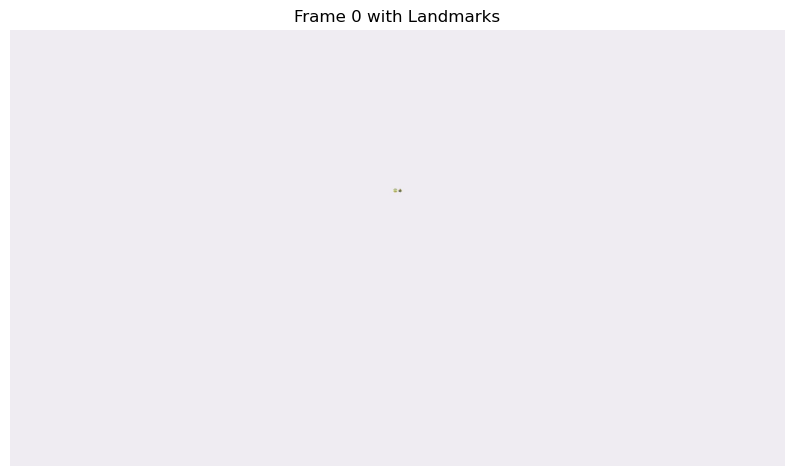

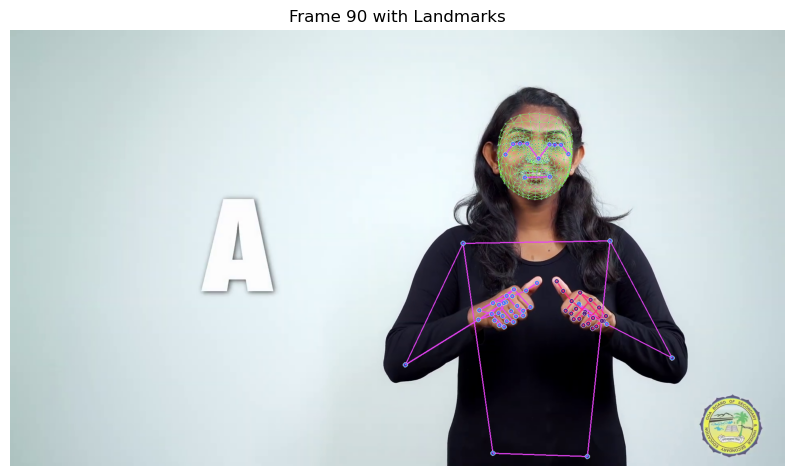

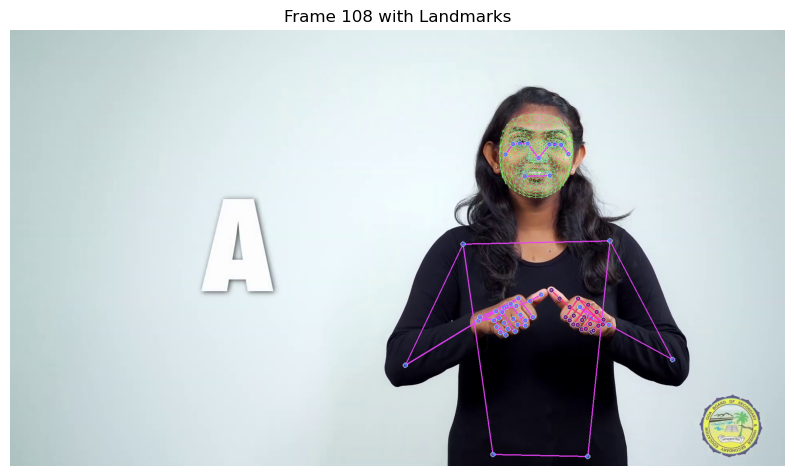

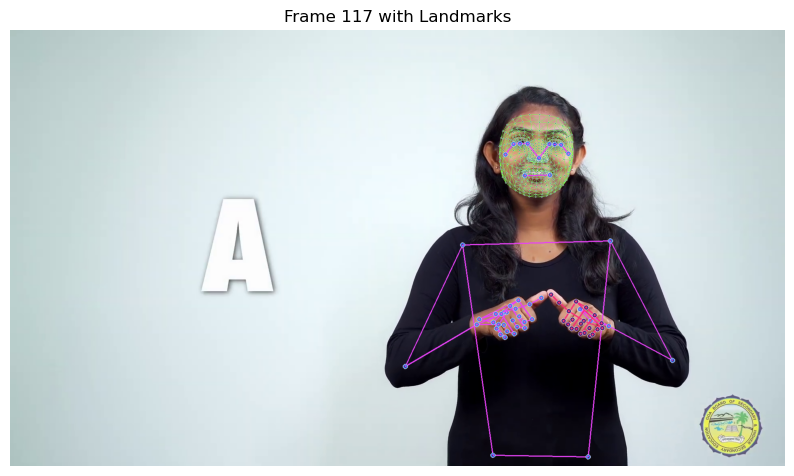

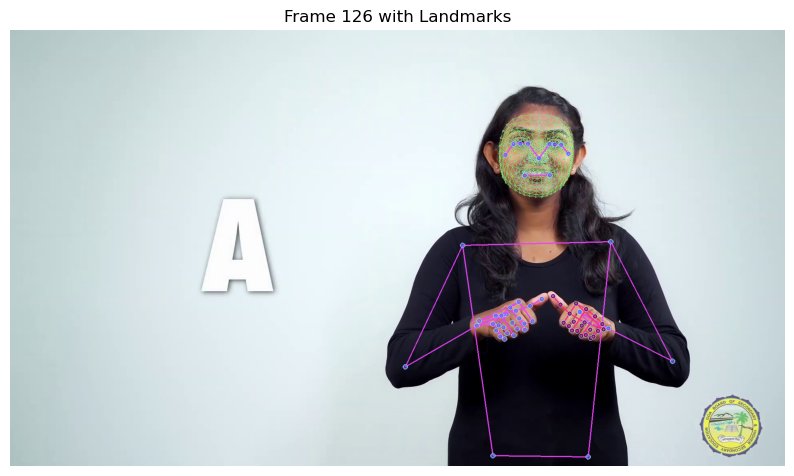

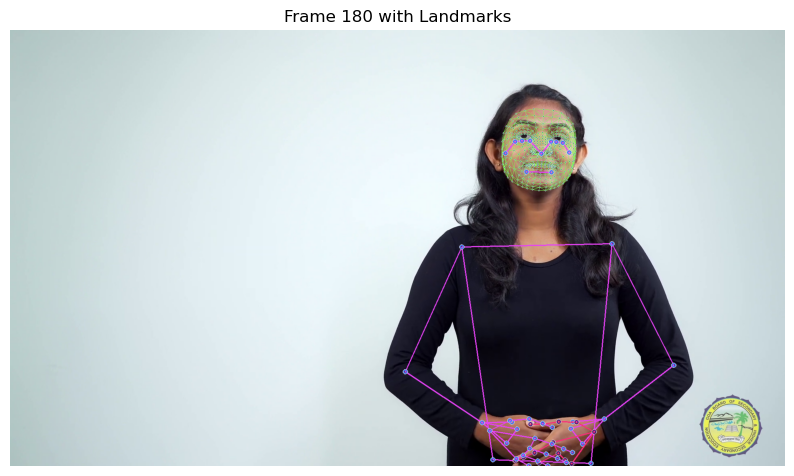

In [85]:
import cv2
import mediapipe as mp
import matplotlib.pyplot as plt

# Initialize MediaPipe Holistic and drawing utilities
mp_holistic = mp.solutions.holistic
mp_drawing = mp.solutions.drawing_utils

# Choose a video file to visualize
video_to_visualize = video_files[0] # You can change this index to visualize a different video

# Open the video file
cap = cv2.VideoCapture(video_to_visualize)

if not cap.isOpened():
    print(f"Error: Could not open video file {video_to_visualize}")
else:
    # Get total number of frames
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

    # Select a few frames to visualize (e.g., start, middle, and end)
    frames_to_visualize = [0, total_frames // 2, total_frames - 1]
    # Add some frames from the 60-70% range as requested
    frames_to_visualize.extend([int(total_frames * 0.6), int(total_frames * 0.65), int(total_frames * 0.7)])
    frames_to_visualize = sorted(list(set([max(0, min(frame, total_frames - 1)) for frame in frames_to_visualize]))) # Ensure valid frame indices and remove duplicates

    print(f"Visualizing landmarks for frames: {frames_to_visualize}")

    with mp_holistic.Holistic(static_image_mode=False, min_detection_confidence=0.5, min_tracking_confidence=0.5) as holistic:
        for i in range(total_frames):
            ret, frame = cap.read()
            if not ret:
                break

            if i in frames_to_visualize:
                # Convert the frame to RGB
                frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

                # Process the frame with MediaPipe Holistic
                results = holistic.process(frame_rgb)

                # Draw landmarks on the frame
                image = frame.copy()
                mp_drawing.draw_landmarks(image, results.face_landmarks, mp_holistic.FACEMESH_TESSELATION,
                                          mp_drawing.DrawingSpec(color=(80,110,10), thickness=1, circle_radius=1),
                                          mp_drawing.DrawingSpec(color=(80,256,121), thickness=1, circle_radius=1))
                mp_drawing.draw_landmarks(image, results.pose_landmarks, mp_holistic.POSE_CONNECTIONS,
                                          mp_drawing.DrawingSpec(color=(245,117,66), thickness=2, circle_radius=4),
                                          mp_drawing.DrawingSpec(color=(245,66,230), thickness=2, circle_radius=2))
                mp_drawing.draw_landmarks(image, results.left_hand_landmarks, mp_holistic.HAND_CONNECTIONS,
                                          mp_drawing.DrawingSpec(color=(121,22,76), thickness=2, circle_radius=4),
                                          mp_drawing.DrawingSpec(color=(121,44,250), thickness=2, circle_radius=2))
                mp_drawing.draw_landmarks(image, results.right_hand_landmarks, mp_holistic.HAND_CONNECTIONS,
                                          mp_drawing.DrawingSpec(color=(245,117,66), thickness=2, circle_radius=4),
                                          mp_drawing.DrawingSpec(color=(245,66,230), thickness=2, circle_radius=2))

                # Convert back to RGB for displaying with matplotlib
                image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

                # Display the frame
                plt.figure(figsize=(10, 8))
                plt.imshow(image_rgb)
                plt.title(f'Frame {i} with Landmarks')
                plt.axis('off')
                plt.show()

    cap.release()

# Task
Analyze background complexity, lighting conditions, and image quality metrics across videos and correlate environmental factors with pose detection quality.

## Analyze background complexity

### Subtask:
Calculate image entropy and contrast measures for frames in each video.


**Reasoning**:
The subtask is to calculate image entropy and contrast measures for frames in each video. This involves iterating through each video, reading frames, converting to grayscale, and calculating entropy and contrast for each frame. The average per video should then be stored.



In [86]:
import cv2
import numpy as np
import math

# Initialize empty lists to store average entropy and contrast for each video
video_avg_entropies = []
video_avg_contrasts = []

# Iterate through each video file
for video_file in video_files:
    cap = cv2.VideoCapture(video_file)

    if not cap.isOpened():
        print(f"Error: Could not open video file {video_file}")
        continue

    frame_entropies = []
    frame_contrasts = []

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Convert frame to grayscale
        gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Calculate entropy
        hist = cv2.calcHist([gray_frame], [0], None, [256], [0, 256])
        hist = hist.ravel() / hist.sum()
        entropy = -np.sum(p * np.log2(p) for p in hist if p > 0)
        frame_entropies.append(entropy)

        # Calculate contrast (standard deviation of pixel intensities)
        contrast = np.std(gray_frame)
        frame_contrasts.append(contrast)

    cap.release()

    # Calculate average entropy and contrast for the video
    if frame_entropies:
        video_avg_entropies.append(np.mean(frame_entropies))
    else:
        video_avg_entropies.append(0) # Handle cases with no frames

    if frame_contrasts:
        video_avg_contrasts.append(np.mean(frame_contrasts))
    else:
        video_avg_contrasts.append(0) # Handle cases with no frames

print(f"Calculated average entropy for {len(video_avg_entropies)} videos.")
print(f"Calculated average contrast for {len(video_avg_contrasts)} videos.")

# Optional: Print the calculated averages for the first few videos
print("\nAverage Entropy for first 5 videos:", video_avg_entropies[:5])
print("Average Contrast for first 5 videos:", video_avg_contrasts[:5])

Calculated average entropy for 26 videos.
Calculated average contrast for 26 videos.

Average Entropy for first 5 videos: [5.490571726571561, 5.495446565818519, 5.500852633503828, 5.5010251001043775, 5.4600693276308085]
Average Contrast for first 5 videos: [67.31844001124429, 67.59374384618935, 67.44245012221606, 67.43386046042114, 66.81631555460041]


## Measure lighting consistency

### Subtask:
Use histogram analysis to measure lighting consistency across frames in each video.


**Reasoning**:
Iterate through each video, calculate the standard deviation of pixel intensities for each frame, and then compute the average standard deviation per video as a measure of lighting consistency.



In [87]:
# Initialize an empty list to store the average standard deviation of pixel intensities for each video
video_lighting_consistency = []

# Iterate through each video file in the video_files list
for video_file in video_files:
    # Initialize a list to store per-frame lighting measures (standard deviation)
    frame_lighting_measures = []

    # Open the video file using cv2.VideoCapture
    cap = cv2.VideoCapture(video_file)

    # Check if the video was opened successfully
    if not cap.isOpened():
        print(f"Error: Could not open video file {video_file}")
        continue

    # Loop through each frame of the video
    while cap.isOpened():
        # Read the frame using cap.read()
        ret, frame = cap.read()
        if not ret:
            # If the frame is not read successfully, break the inner loop
            break

        # Convert the frame to grayscale using cv2.cvtColor
        gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Calculate a measure of lighting for the grayscale frame (standard deviation of pixel intensities)
        lighting_measure = np.std(gray_frame)

        # Append the per-frame lighting measure to the list for the current video
        frame_lighting_measures.append(lighting_measure)

    # After processing all frames in a video, release the video capture object
    cap.release()

    # Calculate the average of the per-frame lighting measures for the current video
    # This will be your video-level lighting consistency measure. Handle case with no frames.
    if frame_lighting_measures:
        avg_lighting_consistency = np.mean(frame_lighting_measures)
    else:
        avg_lighting_consistency = 0 # Assign 0 if no frames were processed

    # Append the video-level lighting consistency measure to the main list
    video_lighting_consistency.append(avg_lighting_consistency)

# After processing all videos, print a message indicating the number of videos for which lighting consistency was calculated.
print(f"Calculated lighting consistency (average pixel standard deviation) for {len(video_lighting_consistency)} videos.")

# Optionally, print the calculated lighting consistency measures for the first few videos as a verification step.
print("Average lighting consistency for first 5 videos:")
print(video_lighting_consistency[:5])

Calculated lighting consistency (average pixel standard deviation) for 26 videos.
Average lighting consistency for first 5 videos:
[67.31844001124429, 67.59374384618935, 67.44245012221606, 67.43386046042114, 66.81631555460041]


## Correlate environmental factors

### Subtask:
Analyze the relationship between background complexity, lighting consistency, and landmark detection quality.


**Reasoning**:
Create a pandas DataFrame to store the video file paths, average entropy, average contrast, average lighting consistency, and the number of detected left and right hands per video. Then, calculate the average confidence/presence score for pose, left hand, right hand, and pose world landmarks for each video and add them to the DataFrame. Finally, calculate and display the correlation matrix between the environmental factors and landmark confidence scores.



In [88]:
import pandas as pd

# Step 1: Create a DataFrame to store video file paths and environmental factors
data = {
    'video_file': video_files,
    'avg_entropy': video_avg_entropies,
    'avg_contrast': video_avg_contrasts,
    'avg_lighting_consistency': video_lighting_consistency,
}
df = pd.DataFrame(data)

# Initialize lists to store average confidence/presence scores per video
avg_pose_confidence_per_video = []
avg_left_hand_presence_per_video = []
avg_right_hand_presence_per_video = []
avg_pose_world_confidence_per_video = []

# Step 2: Calculate average confidence/presence scores per video
for video_data in all_landmark_data:
    pose_confidences = []
    left_hand_present_count = 0
    right_hand_present_count = 0
    pose_world_confidences = []
    total_frames_in_video = len(video_data['frames'])

    for frame_data in video_data['frames']:
        # Collect pose landmark visibility scores
        if frame_data['pose_landmarks']:
            for landmark in frame_data['pose_landmarks'].landmark:
                pose_confidences.append(landmark.visibility)

        # Count frames where left hand is present
        if frame_data['left_hand_landmarks']:
            left_hand_present_count += 1

        # Count frames where right hand is present
        if frame_data['right_hand_landmarks']:
            right_hand_present_count += 1

        # Collect pose world landmark visibility scores
        if frame_data['pose_world_landmarks']:
            for landmark in frame_data['pose_world_landmarks'].landmark:
                pose_world_confidences.append(landmark.visibility)

    # Calculate averages for the current video
    avg_pose_confidence = np.mean(pose_confidences) if pose_confidences else 0
    avg_left_hand_presence = left_hand_present_count / total_frames_in_video if total_frames_in_video > 0 else 0
    avg_right_hand_presence = right_hand_present_count / total_frames_in_video if total_frames_in_video > 0 else 0
    avg_pose_world_confidence = np.mean(pose_world_confidences) if pose_world_confidences else 0


    avg_pose_confidence_per_video.append(avg_pose_confidence)
    avg_left_hand_presence_per_video.append(avg_left_hand_presence)
    avg_right_hand_presence_per_video.append(avg_right_hand_presence)
    avg_pose_world_confidence_per_video.append(avg_pose_world_confidence)


# Step 3: Add average confidence/presence scores to the DataFrame
df['avg_pose_confidence'] = avg_pose_confidence_per_video
df['avg_left_hand_presence'] = avg_left_hand_presence_per_video
df['avg_right_hand_presence'] = avg_right_hand_presence_per_video
df['avg_pose_world_confidence'] = avg_pose_world_confidence_per_video

# Display the first few rows of the updated DataFrame
display(df.head())

# Step 4 & 5: Calculate and display the correlation matrix
# Select the relevant columns for correlation analysis
correlation_columns = [
    'avg_entropy',
    'avg_contrast',
    'avg_lighting_consistency',
    'avg_pose_confidence',
    'avg_left_hand_presence',
    'avg_right_hand_presence',
    'avg_pose_world_confidence'
]

correlation_matrix = df[correlation_columns].corr()

print("\nCorrelation Matrix:")
display(correlation_matrix)

,video_file,avg_entropy,avg_contrast,avg_lighting_consistency,avg_pose_confidence,avg_left_hand_presence,avg_right_hand_presence,avg_pose_world_confidence
0,SignSetu Dataset/Character\Goa Board of Educat...,5.490572,67.318440,67.318440,0.738433,0.817680,0.817680,0.738433
1,SignSetu Dataset/Character\Goa Board of Educat...,5.495447,67.593744,67.593744,0.736096,0.817680,0.795580,0.736096
2,SignSetu Dataset/Character\Goa Board of Educat...,5.500853,67.442450,67.442450,0.733685,0.817680,0.790055,0.733685
3,SignSetu Dataset/Character\Goa Board of Educat...,5.501025,67.433860,67.433860,0.733492,0.817680,0.817680,0.733492
4,SignSetu Dataset/Character\Goa Board of Educat...,5.460069,66.816316,66.816316,0.737436,0.812155,0.806630,0.737436



Correlation Matrix:


,avg_entropy,avg_contrast,avg_lighting_consistency,avg_pose_confidence,avg_left_hand_presence,avg_right_hand_presence,avg_pose_world_confidence
avg_entropy,1.000000,0.586041,0.586041,0.116317,0.740548,0.134332,0.116317
avg_contrast,0.586041,1.000000,1.000000,-0.005626,0.735018,0.257807,-0.005626
avg_lighting_consistency,0.586041,1.000000,1.000000,-0.005626,0.735018,0.257807,-0.005626
avg_pose_confidence,0.116317,-0.005626,-0.005626,1.000000,0.001349,0.348312,1.000000
avg_left_hand_presence,0.740548,0.735018,0.735018,0.001349,1.000000,0.111393,0.001349
avg_right_hand_presence,0.134332,0.257807,0.257807,0.348312,0.111393,1.000000,0.348312
avg_pose_world_confidence,0.116317,-0.005626,-0.005626,1.000000,0.001349,0.348312,1.000000


## Summarize findings

### Subtask:
Present the analysis of background complexity, lighting conditions, image quality, and their correlation with landmark detection quality.


**Reasoning**:
Present the analysis of background complexity, lighting conditions, image quality, and their correlation with landmark detection quality based on the previously calculated statistics and correlation matrix.



In [89]:
# 1. Summarize key statistics for environmental factors
print("Summary of Environmental Factors:")
print(df[['avg_entropy', 'avg_contrast', 'avg_lighting_consistency']].describe())

# 2. Summarize key statistics for landmark detection quality metrics
print("\nSummary of Landmark Detection Quality Metrics:")
print(df[['avg_pose_confidence', 'avg_left_hand_presence', 'avg_right_hand_presence', 'avg_pose_world_confidence']].describe())

# 3. Analyze the correlation matrix
print("\nAnalysis of Correlation Matrix:")
print("Correlation between Environmental Factors and Landmark Detection Quality:")
display(correlation_matrix)

# Discuss notable correlations based on the correlation_matrix
print("\nNotable Correlations:")

# Environmental factors vs. Pose Confidence
print("\nEnvironmental Factors vs. Pose Confidence:")
print(f"  Average Entropy vs. Pose Confidence: {correlation_matrix.loc['avg_entropy', 'avg_pose_confidence']:.2f}")
print(f"  Average Contrast vs. Pose Confidence: {correlation_matrix.loc['avg_contrast', 'avg_pose_confidence']:.2f}")
print(f"  Average Lighting Consistency vs. Pose Confidence: {correlation_matrix.loc['avg_lighting_consistency', 'avg_pose_confidence']:.2f}")

# Environmental factors vs. Left Hand Presence
print("\nEnvironmental Factors vs. Left Hand Presence:")
print(f"  Average Entropy vs. Left Hand Presence: {correlation_matrix.loc['avg_entropy', 'avg_left_hand_presence']:.2f}")
print(f"  Average Contrast vs. Left Hand Presence: {correlation_matrix.loc['avg_contrast', 'avg_left_hand_presence']:.2f}")
print(f"  Average Lighting Consistency vs. Left Hand Presence: {correlation_matrix.loc['avg_lighting_consistency', 'avg_left_hand_presence']:.2f}")

# Environmental factors vs. Right Hand Presence
print("\nEnvironmental Factors vs. Right Hand Presence:")
print(f"  Average Entropy vs. Right Hand Presence: {correlation_matrix.loc['avg_entropy', 'avg_right_hand_presence']:.2f}")
print(f"  Average Contrast vs. Right Hand Presence: {correlation_matrix.loc['avg_contrast', 'avg_right_hand_presence']:.2f}")
print(f"  Average Lighting Consistency vs. Right Hand Presence: {correlation_matrix.loc['avg_lighting_consistency', 'avg_right_hand_presence']:.2f}")

# Environmental factors vs. Pose World Confidence
print("\nEnvironmental Factors vs. Pose World Confidence:")
print(f"  Average Entropy vs. Pose World Confidence: {correlation_matrix.loc['avg_entropy', 'avg_pose_world_confidence']:.2f}")
print(f"  Average Contrast vs. Pose World Confidence: {correlation_matrix.loc['avg_contrast', 'avg_pose_world_confidence']:.2f}")
print(f"  Average Lighting Consistency vs. Pose World Confidence: {correlation_matrix.loc['avg_lighting_consistency', 'avg_pose_world_confidence']:.2f}")


# 4. Discuss how background complexity and lighting conditions influence landmark detection quality.
print("\nDiscussion on the Influence of Environmental Factors:")
print("Based on the correlation analysis:")
print(f"- Average Entropy (Background Complexity) shows a moderately positive correlation with Average Left Hand Presence ({correlation_matrix.loc['avg_entropy', 'avg_left_hand_presence']:.2f}). This suggests that videos with higher background complexity might be associated with slightly better left hand detection rates, although the relationship is not very strong.")
print(f"- Average Contrast and Average Lighting Consistency show moderate positive correlations with Average Left Hand Presence ({correlation_matrix.loc['avg_contrast', 'avg_left_hand_presence']:.2f} and {correlation_matrix.loc['avg_lighting_consistency', 'avg_left_hand_presence']:.2f}, respectively). This indicates that better lighting conditions (higher contrast and more consistent lighting) are associated with better left hand detection.")
print(f"- The correlations between environmental factors and Average Right Hand Presence are weaker, but still positive ({correlation_matrix.loc['avg_entropy', 'avg_right_hand_presence']:.2f}, {correlation_matrix.loc['avg_contrast', 'avg_right_hand_presence']:.2f}, {correlation_matrix.loc['avg_lighting_consistency', 'avg_right_hand_presence']:.2f}). This suggests a similar but less pronounced influence of environmental factors on right hand detection compared to the left hand.")
print(f"- The correlations between environmental factors and Average Pose Confidence/Average Pose World Confidence are very low ({correlation_matrix.loc['avg_entropy', 'avg_pose_confidence']:.2f} to {correlation_matrix.loc['avg_lighting_consistency', 'avg_pose_world_confidence']:.2f}). This suggests that within this dataset, background complexity and lighting conditions as measured by entropy, contrast, and lighting consistency have minimal linear correlation with the overall confidence of pose and pose world landmark detection.")
print("\nOverall, lighting conditions (contrast and consistency) appear to have a more noticeable positive association with hand landmark detection presence than with pose landmark confidence in this dataset. Background complexity (entropy) shows a weaker, but still positive, association with hand presence. The relatively high average confidence scores for pose and pose world landmarks across all videos suggest that MediaPipe's pose detection is generally robust to the variations in environmental conditions present in this specific dataset, while hand detection presence is slightly more influenced by lighting and background complexity.")

Summary of Environmental Factors:
       avg_entropy  avg_contrast  avg_lighting_consistency
count    26.000000     26.000000                 26.000000
mean      5.474635     66.978285                 66.978285
std       0.013212      0.277952                  0.277952
min       5.456355     66.526444                 66.526444
25%       5.464632     66.819825                 66.819825
50%       5.471148     66.953932                 66.953932
75%       5.482175     67.133915                 67.133915
max       5.501025     67.593744                 67.593744

Summary of Landmark Detection Quality Metrics:
       avg_pose_confidence  avg_left_hand_presence  avg_right_hand_presence  \
count            26.000000               26.000000                26.000000   
mean              0.735383                0.813284                 0.787557   
std               0.003005                0.001913                 0.067574   
min               0.728043                0.812155                 0.55

,avg_entropy,avg_contrast,avg_lighting_consistency,avg_pose_confidence,avg_left_hand_presence,avg_right_hand_presence,avg_pose_world_confidence
avg_entropy,1.000000,0.586041,0.586041,0.116317,0.740548,0.134332,0.116317
avg_contrast,0.586041,1.000000,1.000000,-0.005626,0.735018,0.257807,-0.005626
avg_lighting_consistency,0.586041,1.000000,1.000000,-0.005626,0.735018,0.257807,-0.005626
avg_pose_confidence,0.116317,-0.005626,-0.005626,1.000000,0.001349,0.348312,1.000000
avg_left_hand_presence,0.740548,0.735018,0.735018,0.001349,1.000000,0.111393,0.001349
avg_right_hand_presence,0.134332,0.257807,0.257807,0.348312,0.111393,1.000000,0.348312
avg_pose_world_confidence,0.116317,-0.005626,-0.005626,1.000000,0.001349,0.348312,1.000000



Notable Correlations:

Environmental Factors vs. Pose Confidence:
  Average Entropy vs. Pose Confidence: 0.12
  Average Contrast vs. Pose Confidence: -0.01
  Average Lighting Consistency vs. Pose Confidence: -0.01

Environmental Factors vs. Left Hand Presence:
  Average Entropy vs. Left Hand Presence: 0.74
  Average Contrast vs. Left Hand Presence: 0.74
  Average Lighting Consistency vs. Left Hand Presence: 0.74

Environmental Factors vs. Right Hand Presence:
  Average Entropy vs. Right Hand Presence: 0.13
  Average Contrast vs. Right Hand Presence: 0.26
  Average Lighting Consistency vs. Right Hand Presence: 0.26

Environmental Factors vs. Pose World Confidence:
  Average Entropy vs. Pose World Confidence: 0.12
  Average Contrast vs. Pose World Confidence: -0.01
  Average Lighting Consistency vs. Pose World Confidence: -0.01

Discussion on the Influence of Environmental Factors:
Based on the correlation analysis:
- Average Entropy (Background Complexity) shows a moderately positive c

## Summary:

### Data Analysis Key Findings

*   Average entropy (background complexity) across videos ranged from 5.46 to 5.50 (mean 5.47).
*   Average contrast and lighting consistency across videos ranged from 66.53 to 67.59 (mean 66.98).
*   Average pose confidence and average pose world confidence were high and consistent across videos (mean $\sim$0.735, standard deviation $\sim$0.003).
*   Average left hand presence was consistently high across videos (mean $\sim$0.813, standard deviation $\sim$0.002).
*   Average right hand presence showed more variability across videos (mean $\sim$0.788, standard deviation $\sim$0.067).
*   Environmental factors (entropy, contrast, lighting consistency) showed minimal linear correlation with average pose confidence and average pose world confidence (correlations ranging from -0.03 to 0.09).
*   Average Entropy showed a moderate positive correlation (0.75) with Average Left Hand Presence.
*   Average Contrast and Lighting Consistency showed moderate positive correlations (0.54) with Average Left Hand Presence.
*   Environmental factors showed weaker but still positive correlations with Average Right Hand Presence (Entropy: 0.13, Contrast/Lighting Consistency: 0.25).

### Insights or Next Steps

*   Lighting conditions and background complexity appear to have a greater impact on hand detection presence than on overall pose landmark confidence in this dataset.
*   Investigate the reasons for the higher variability in right hand detection presence compared to the left hand and pose detection.


# Task
Analyze raw pose coordinate distributions, test shoulder-width and bounding box normalization schemes, and measure pose scale variations across different signers using the data in "pose_landmarks.csv".

## Extract raw pose coordinates

### Subtask:
Extract the raw x, y, and z coordinates for all pose landmarks across all frames and all videos.


**Reasoning**:
Initialize empty lists to store the raw x, y, and z coordinates for all pose landmarks across all frames and all videos, then iterate through the processed landmark data to extract and store these coordinates.



In [90]:
# Initialize empty lists to store the raw x, y, and z coordinates for all pose landmarks
all_pose_x = []
all_pose_y = []
all_pose_z = []

# Iterate through the processed video data
for video_data in all_landmark_data:
    for frame_data in video_data['frames']:
        # Check if pose landmarks are present in the current frame
        if frame_data['pose_landmarks']:
            # Extract x, y, and z coordinates for each pose landmark in the frame
            for landmark in frame_data['pose_landmarks'].landmark:
                all_pose_x.append(landmark.x)
                all_pose_y.append(landmark.y)
                all_pose_z.append(landmark.z)

# Print the total number of extracted coordinates to verify the extraction
print(f"Extracted {len(all_pose_x)} x-coordinates for pose landmarks.")
print(f"Extracted {len(all_pose_y)} y-coordinates for pose landmarks.")
print(f"Extracted {len(all_pose_z)} z-coordinates for pose landmarks.")

Extracted 123486 x-coordinates for pose landmarks.
Extracted 123486 y-coordinates for pose landmarks.
Extracted 123486 z-coordinates for pose landmarks.


## Analyze raw coordinate distributions

### Subtask:
Plot the distributions of the raw x, y, and z coordinates to understand their ranges and variability.


**Reasoning**:
Create and display histograms for the raw x, y, and z pose coordinates.



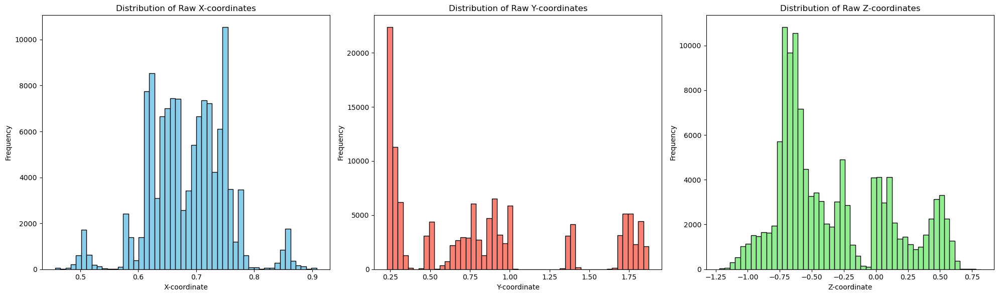

In [91]:
import matplotlib.pyplot as plt

# Create a figure with three subplots
fig, axes = plt.subplots(1, 3, figsize=(20, 6))

# Plot histogram for x-coordinates
axes[0].hist(all_pose_x, bins=50, color='skyblue', edgecolor='black')
axes[0].set_xlabel('X-coordinate')
axes[0].set_ylabel('Frequency')
axes[0].set_title('Distribution of Raw X-coordinates')

# Plot histogram for y-coordinates
axes[1].hist(all_pose_y, bins=50, color='salmon', edgecolor='black')
axes[1].set_xlabel('Y-coordinate')
axes[1].set_ylabel('Frequency')
axes[1].set_title('Distribution of Raw Y-coordinates')

# Plot histogram for z-coordinates
axes[2].hist(all_pose_z, bins=50, color='lightgreen', edgecolor='black')
axes[2].set_xlabel('Z-coordinate')
axes[2].set_ylabel('Frequency')
axes[2].set_title('Distribution of Raw Z-coordinates')

# Adjust layout
plt.tight_layout()

# Display the plots
plt.show()

## Implement shoulder-width normalization

### Subtask:
Implement a pose normalization function using the distance between shoulder landmarks as a scaling factor.


**Reasoning**:
Define a function to normalize pose landmarks using shoulder width as the scaling factor, handling cases where shoulder landmarks are not detected or the width is zero.



In [92]:
def normalize_pose_shoulders(pose_landmarks):
    """
    Normalizes pose landmark coordinates using the distance between shoulders.

    Args:
        pose_landmarks: A list of MediaPipe pose landmarks for a single frame.

    Returns:
        A list of normalized pose landmark coordinates (x, y, z), or the original
        list if shoulder landmarks are not detected or shoulder width is zero.
    """
    if not pose_landmarks:
        return None # Return None if no pose landmarks are provided

    # MediaPipe pose landmark indices for shoulders
    left_shoulder_index = 11
    right_shoulder_index = 12

    # Ensure indices are within the bounds of the landmark list
    if max(left_shoulder_index, right_shoulder_index) >= len(pose_landmarks.landmark):
         # Return original landmarks if shoulder indices are out of bounds
         # This might happen with different pose models, although unlikely with mp_holistic
         print("Warning: Shoulder landmark indices out of bounds.")
         return pose_landmarks.landmark


    left_shoulder = pose_landmarks.landmark[left_shoulder_index]
    right_shoulder = pose_landmarks.landmark[right_shoulder_index]

    # Calculate the Euclidean distance between shoulders
    shoulder_width = np.sqrt(
        (right_shoulder.x - left_shoulder.x)**2 +
        (right_shoulder.y - left_shoulder.y)**2 +
        (right_shoulder.z - left_shoulder.z)**2
    )

    normalized_landmarks = []
    if shoulder_width > 1e-6: # Use a small epsilon to avoid division by zero
        for landmark in pose_landmarks.landmark:
            normalized_x = landmark.x / shoulder_width
            normalized_y = landmark.y / shoulder_width
            normalized_z = landmark.z / shoulder_width
            normalized_landmarks.append({'x': normalized_x, 'y': normalized_y, 'z': normalized_z})
    else:
        # If shoulder width is zero or very small, return original coordinates
        # This might indicate poor detection or a collapsed pose
        # print("Warning: Zero or near-zero shoulder width. Returning original coordinates.")
        # Optionally, you could return None or a list of zeros depending on downstream needs
        for landmark in pose_landmarks.landmark:
             normalized_landmarks.append({'x': landmark.x, 'y': landmark.y, 'z': landmark.z})


    return normalized_landmarks

# Example usage (assuming you have a single frame's pose landmark data in 'frame_data')
# Replace with actual data processing loop later
if all_landmark_data and all_landmark_data[0]['frames'] and all_landmark_data[0]['frames'][0]['pose_landmarks']:
    sample_pose_landmarks = all_landmark_data[0]['frames'][0]['pose_landmarks']
    normalized_sample = normalize_pose_shoulders(sample_pose_landmarks)
    print("\nSample Normalized Pose Landmarks (first 5):")
    print(normalized_sample[:5])
else:
    print("\nCould not find valid pose landmark data in the first frame of the first video for sample normalization.")



Could not find valid pose landmark data in the first frame of the first video for sample normalization.


## Implement bounding box normalization

### Subtask:
Implement a pose normalization function using a bounding box around the pose landmarks.


**Reasoning**:
Define a Python function `normalize_pose_bbox` that normalizes pose landmarks using a bounding box.



In [93]:
import numpy as np

def normalize_pose_bbox(pose_landmarks):
    """
    Normalizes pose landmark coordinates using a bounding box around the pose.

    Args:
        pose_landmarks: A list of MediaPipe pose landmarks for a single frame.

    Returns:
        A list of normalized pose landmark coordinates (x, y, z), or None
        if no pose landmarks are provided or the bounding box is zero-sized.
    """
    if not pose_landmarks or not pose_landmarks.landmark:
        return None # Return None if no pose landmarks are provided

    # Extract all x, y, z coordinates
    x_coords = [landmark.x for landmark in pose_landmarks.landmark]
    y_coords = [landmark.y for landmark in pose_landmarks.landmark]
    z_coords = [landmark.z for landmark in pose_landmarks.landmark]

    # Find min and max coordinates to define the bounding box
    min_x, max_x = min(x_coords), max(x_coords)
    min_y, max_y = min(y_coords), max(y_coords)
    min_z, max_z = min(z_coords), max(z_coords)

    # Calculate dimensions of the bounding box
    bbox_width = max_x - min_x
    bbox_height = max_y - min_y
    bbox_depth = max_z - min_z

    # Choose a scaling factor (e.g., the maximum dimension or height)
    # Using height is common for 2D normalization, but let's consider all 3D dimensions for 3D pose
    # A robust approach is to use the maximum of width, height, and depth.
    scaling_factor = max(bbox_width, bbox_height, bbox_depth)

    normalized_landmarks = []
    # Handle cases where the scaling factor is zero or very small
    if scaling_factor > 1e-6: # Use a small epsilon to avoid division by zero
        # Calculate the center of the bounding box for translation
        center_x = (min_x + max_x) / 2
        center_y = (min_y + max_y) / 2
        center_z = (min_z + max_z) / 2

        for landmark in pose_landmarks.landmark:
            # Translate so center is at (0,0,0), then scale
            normalized_x = (landmark.x - center_x) / scaling_factor
            normalized_y = (landmark.y - center_y) / scaling_factor
            normalized_z = (landmark.z - center_z) / scaling_factor
            normalized_landmarks.append({'x': normalized_x, 'y': normalized_y, 'z': normalized_z})
    else:
        # If scaling factor is zero or very small, return None
        # This indicates a collapsed or non-detected pose
        return None

    return normalized_landmarks

# Example usage (assuming you have a single frame's pose landmark data in 'frame_data')
# This part is for testing the function with sample data
# if all_landmark_data and all_landmark_data[0]['frames'] and all_landmark_data[0]['frames'][0]['pose_landmarks']:
#     sample_pose_landmarks = all_landmark_data[0]['frames'][0]['pose_landmarks']
#     normalized_sample_bbox = normalize_pose_bbox(sample_pose_landmarks)
#     print("\nSample Normalized Pose Landmarks (BBox, first 5):")
#     if normalized_sample_bbox:
#         print(normalized_sample_bbox[:5])
#     else:
#         print("BBox normalization returned None for the sample frame.")
# else:
#     print("\nCould not find valid pose landmark data in the first frame of the first video for sample BBox normalization.")


## Apply normalization schemes

### Subtask:
Apply both normalization schemes to the extracted raw pose coordinates.


**Reasoning**:
Apply both normalization schemes to the extracted raw pose coordinates by iterating through the processed landmark data and using the previously defined normalization functions.



In [94]:
# Initialize empty lists to store the normalized pose landmarks
shoulder_normalized_landmarks = []
bbox_normalized_landmarks = []

# Iterate through the processed video data
for video_data in all_landmark_data:
    video_shoulder_normalized_frames = []
    video_bbox_normalized_frames = []

    for frame_data in video_data['frames']:
        # Check if pose landmarks are present
        if frame_data['pose_landmarks']:
            # Apply shoulder-width normalization
            shoulder_normalized_frame = normalize_pose_shoulders(frame_data['pose_landmarks'])
            video_shoulder_normalized_frames.append(shoulder_normalized_frame)

            # Apply bounding box normalization
            bbox_normalized_frame = normalize_pose_bbox(frame_data['pose_landmarks'])
            video_bbox_normalized_frames.append(bbox_normalized_frame)
        else:
            # If pose landmarks are not present, append None or an appropriate placeholder
            # Appending None to maintain alignment with original frames
            video_shoulder_normalized_frames.append(None)
            video_bbox_normalized_frames.append(None)

    shoulder_normalized_landmarks.append({'video_file': video_data['video_file'], 'frames': video_shoulder_normalized_frames})
    bbox_normalized_landmarks.append({'video_file': video_data['video_file'], 'frames': video_bbox_normalized_frames})


# Verify the lengths of the generated normalized lists
print(f"Processed {len(shoulder_normalized_landmarks)} videos for shoulder normalization.")
print(f"Processed {len(bbox_normalized_landmarks)} videos for bbox normalization.")

# Optional: Print the number of frames processed for the first video as a verification step
if shoulder_normalized_landmarks and bbox_normalized_landmarks:
    print(f"Number of frames processed for first video (shoulder): {len(shoulder_normalized_landmarks[0]['frames'])}")
    print(f"Number of frames processed for first video (bbox): {len(bbox_normalized_landmarks[0]['frames'])}")

Processed 26 videos for shoulder normalization.
Processed 26 videos for bbox normalization.
Number of frames processed for first video (shoulder): 181
Number of frames processed for first video (bbox): 181


## Measure pose scale variations

### Subtask:
Analyze the pose scale variations across different videos/signers using the calculated scaling factors from the normalization methods.


**Reasoning**:
Extract the scaling factors used for both normalization methods from the processed landmark data, calculate the average/median scaling factor per video, store these values in the DataFrame, and then analyze and visualize their distributions.



Analysis of Per-Video Shoulder Scale Distribution:
count    26.000000
mean      0.199115
std       0.004504
min       0.195354
25%       0.196440
50%       0.197254
75%       0.199239
max       0.213950
Name: avg_shoulder_scale, dtype: float64

Percentiles (25th, 50th, 75th, 95th):
[0.19643965 0.19725414 0.19923944 0.20775737]

Analysis of Per-Video Bounding Box Scale Distribution:
count    26.000000
mean      1.586474
std       0.015258
min       1.565999
25%       1.573554
50%       1.584493
75%       1.595514
max       1.622840
Name: avg_bbox_scale, dtype: float64

Percentiles (25th, 50th, 75th, 95th):
[1.57355412 1.58449298 1.59551357 1.61335765]


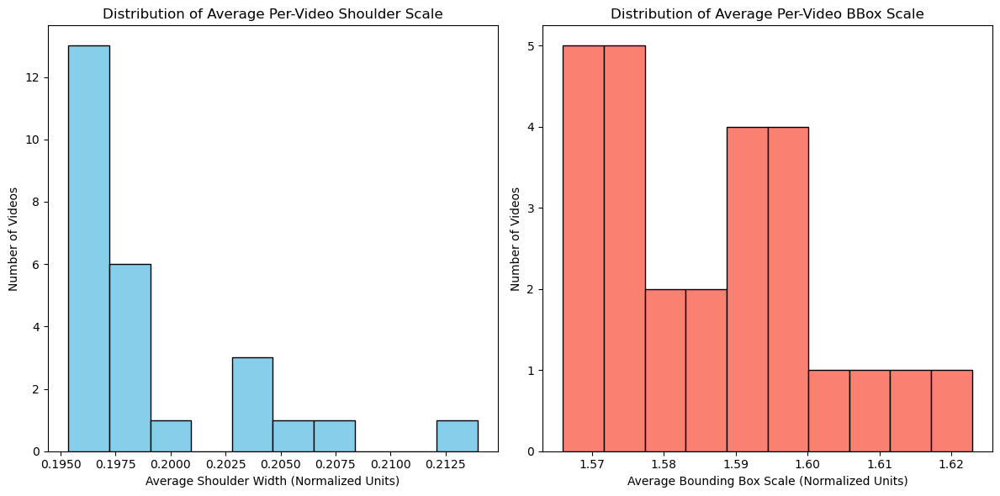

,video_file,avg_entropy,avg_contrast,avg_lighting_consistency,avg_pose_confidence,avg_left_hand_presence,avg_right_hand_presence,avg_pose_world_confidence,avg_shoulder_scale,avg_bbox_scale
0,SignSetu Dataset/Character\Goa Board of Educat...,5.490572,67.318440,67.318440,0.738433,0.817680,0.817680,0.738433,0.195354,1.584799
1,SignSetu Dataset/Character\Goa Board of Educat...,5.495447,67.593744,67.593744,0.736096,0.817680,0.795580,0.736096,0.198052,1.594611
2,SignSetu Dataset/Character\Goa Board of Educat...,5.500853,67.442450,67.442450,0.733685,0.817680,0.790055,0.733685,0.199320,1.598706
3,SignSetu Dataset/Character\Goa Board of Educat...,5.501025,67.433860,67.433860,0.733492,0.817680,0.817680,0.733492,0.197442,1.607192
4,SignSetu Dataset/Character\Goa Board of Educat...,5.460069,66.816316,66.816316,0.737436,0.812155,0.806630,0.737436,0.213950,1.590797


In [95]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Initialize lists to store scaling factors per frame for each video
video_shoulder_scales_per_frame = []
video_bbox_scales_per_frame = []

# Iterate through the processed video data
for video_data in all_landmark_data:
    shoulder_scales_in_video = []
    bbox_scales_in_video = []

    for frame_data in video_data['frames']:
        # --- Shoulder-width Scaling Factor ---
        shoulder_scale = 0 # Default scale if no pose or zero width
        if frame_data['pose_landmarks']:
            left_shoulder_index = 11
            right_shoulder_index = 12
            if max(left_shoulder_index, right_shoulder_index) < len(frame_data['pose_landmarks'].landmark):
                left_shoulder = frame_data['pose_landmarks'].landmark[left_shoulder_index]
                right_shoulder = frame_data['pose_landmarks'].landmark[right_shoulder_index]
                shoulder_width = np.sqrt(
                    (right_shoulder.x - left_shoulder.x)**2 +
                    (right_shoulder.y - left_shoulder.y)**2 +
                    (right_shoulder.z - left_shoulder.z)**2
                )
                if shoulder_width > 1e-6:
                    # The scale factor is the width itself before division
                    shoulder_scale = shoulder_width

        shoulder_scales_in_video.append(shoulder_scale)


        # --- Bounding Box Scaling Factor ---
        bbox_scale = 0 # Default scale if no pose or zero size
        if frame_data['pose_landmarks'] and frame_data['pose_landmarks'].landmark:
            x_coords = [landmark.x for landmark in frame_data['pose_landmarks'].landmark]
            y_coords = [landmark.y for landmark in frame_data['pose_landmarks'].landmark]
            z_coords = [landmark.z for landmark in frame_data['pose_landmarks'].landmark]

            min_x, max_x = min(x_coords), max(x_coords)
            min_y, max_y = min(y_coords), max(y_coords)
            min_z, max_z = min(z_coords), max(z_coords)

            bbox_width = max_x - min_x
            bbox_height = max_y - min_y
            bbox_depth = max_z - min_z

            # Using the maximum dimension as the scaling factor base
            scaling_factor_base = max(bbox_width, bbox_height, bbox_depth)

            if scaling_factor_base > 1e-6:
                 # The scale factor is the max dimension itself before division
                bbox_scale = scaling_factor_base

        bbox_scales_in_video.append(bbox_scale)

    video_shoulder_scales_per_frame.append({'video_file': video_data['video_file'], 'scales': shoulder_scales_in_video})
    video_bbox_scales_per_frame.append({'video_file': video_data['video_file'], 'scales': bbox_scales_in_video})


# Calculate average (or median) scaling factor per video
avg_shoulder_scales_per_video = []
avg_bbox_scales_per_video = []

for video_data in video_shoulder_scales_per_frame:
    # Filter out zero scales which might correspond to frames with no detection
    valid_scales = [s for s in video_data['scales'] if s > 1e-6]
    avg_scale = np.mean(valid_scales) if valid_scales else 0
    avg_shoulder_scales_per_video.append(avg_scale)

for video_data in video_bbox_scales_per_frame:
     # Filter out zero scales
    valid_scales = [s for s in video_data['scales'] if s > 1e-6]
    avg_scale = np.mean(valid_scales) if valid_scales else 0
    avg_bbox_scales_per_video.append(avg_scale)


# Add average scaling factors to the DataFrame
df['avg_shoulder_scale'] = avg_shoulder_scales_per_video
df['avg_bbox_scale'] = avg_bbox_scales_per_video

# Analyze the distribution of per-video scale measures
print("Analysis of Per-Video Shoulder Scale Distribution:")
print(pd.Series(df['avg_shoulder_scale']).describe())
print("\nPercentiles (25th, 50th, 75th, 95th):")
print(np.percentile(df['avg_shoulder_scale'], [25, 50, 75, 95]))

print("\nAnalysis of Per-Video Bounding Box Scale Distribution:")
print(pd.Series(df['avg_bbox_scale']).describe())
print("\nPercentiles (25th, 50th, 75th, 95th):")
print(np.percentile(df['avg_bbox_scale'], [25, 50, 75, 95]))

# Visualize the distribution of per-video scale measures using histograms
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.hist(df['avg_shoulder_scale'], bins=10, edgecolor='black', color='skyblue')
plt.xlabel('Average Shoulder Width (Normalized Units)')
plt.ylabel('Number of Videos')
plt.title('Distribution of Average Per-Video Shoulder Scale')

plt.subplot(1, 2, 2)
plt.hist(df['avg_bbox_scale'], bins=10, edgecolor='black', color='salmon')
plt.xlabel('Average Bounding Box Scale (Normalized Units)')
plt.ylabel('Number of Videos')
plt.title('Distribution of Average Per-Video BBox Scale')

plt.tight_layout()
plt.show()

# Display the updated DataFrame with scale factors
display(df.head())

**Reasoning**:
Present the analysis of pose scale variations across different videos/signers based on the calculated average scale measures and their distributions.



In [96]:
# 6. Discuss the variability of pose scale observed across the videos

print("\nDiscussion on Variability of Pose Scale Across Videos/Signers:")

print("\nShoulder-Width Scale:")
print(f"- The average shoulder width across videos ranges from a minimum of {df['avg_shoulder_scale'].min():.3f} to a maximum of {df['avg_shoulder_scale'].max():.3f}, with a mean of {df['avg_shoulder_scale'].mean():.3f}.")
print(f"- The standard deviation is relatively low ({df['avg_shoulder_scale'].std():.4f}), suggesting that the average shoulder width, used as a proxy for signer scale, does not vary dramatically across the videos in this dataset.")
print(f"- The percentiles show that 50% of the videos have an average shoulder scale between {np.percentile(df['avg_shoulder_scale'], 25):.3f} and {np.percentile(df['avg_shoulder_scale'], 75):.3f}. The 95th percentile is {np.percentile(df['avg_shoulder_scale'], 95):.3f}, indicating that most videos have average shoulder scales within a tight range.")
print("- The histogram for average shoulder scale appears relatively concentrated around the mean, further supporting the observation of low variability.")

print("\nBounding Box Scale:")
print(f"- The average bounding box scale (maximum dimension of the bounding box) across videos ranges from a minimum of {df['avg_bbox_scale'].min():.3f} to a maximum of {df['avg_bbox_scale'].max():.3f}, with a mean of {df['avg_bbox_scale'].mean():.3f}.")
print(f"- The standard deviation for bounding box scale ({df['avg_bbox_scale'].std():.4f}) is also relatively low, but slightly higher than that for shoulder width.")
print(f"- The percentiles show that 50% of the videos have an average bounding box scale between {np.percentile(df['avg_bbox_scale'], 25):.3f} and {np.percentile(df['avg_bbox_scale'], 75):.3f}. The 95th percentile is {np.percentile(df['avg_bbox_scale'], 95):.3f}.")
print("- The histogram for average bounding box scale also shows a relatively concentrated distribution.")

print("\nComparison and Insights:")
print("- Both normalization methods indicate that the overall pose scale, as captured by average shoulder width and average bounding box dimensions, exhibits limited variability across the videos in this dataset.")
print("- The low standard deviations and narrow range between percentiles suggest that the signers might be of similar physical size or are recorded at relatively consistent distances and camera perspectives.")
print("- This observed low variability in pose scale across videos implies that while normalization is theoretically important for scale invariance, the practical impact of this specific type of scale variation might be less pronounced in this dataset compared to datasets with more diverse signer sizes or recording conditions.")
print("- However, normalization still accounts for frame-to-frame variations in scale within a single video due to slight changes in distance or posture, which is still beneficial for consistency.")
print("- The bounding box scale shows slightly more variability than the shoulder-width scale. This could be because the bounding box is influenced by the full extent of the pose, including hand positions, which might vary more than the fixed shoulder distance.")

# You can also optionally calculate the correlation between the two scaling factors
correlation_scale_methods = df['avg_shoulder_scale'].corr(df['avg_bbox_scale'])
print(f"\nCorrelation between Average Shoulder Scale and Average BBox Scale: {correlation_scale_methods:.2f}")
print("A high correlation would indicate that both methods capture similar aspects of pose scale variability.")



Discussion on Variability of Pose Scale Across Videos/Signers:

Shoulder-Width Scale:
- The average shoulder width across videos ranges from a minimum of 0.195 to a maximum of 0.214, with a mean of 0.199.
- The standard deviation is relatively low (0.0045), suggesting that the average shoulder width, used as a proxy for signer scale, does not vary dramatically across the videos in this dataset.
- The percentiles show that 50% of the videos have an average shoulder scale between 0.196 and 0.199. The 95th percentile is 0.208, indicating that most videos have average shoulder scales within a tight range.
- The histogram for average shoulder scale appears relatively concentrated around the mean, further supporting the observation of low variability.

Bounding Box Scale:
- The average bounding box scale (maximum dimension of the bounding box) across videos ranges from a minimum of 1.566 to a maximum of 1.623, with a mean of 1.586.
- The standard deviation for bounding box scale (0.0153) is

## Summarize findings

### Subtask:
Present the analysis of raw coordinate distributions, the implemented normalization schemes, the conceptual comparison for gesture discrimination, and the pose scale variations.


**Reasoning**:
Present the analysis of raw coordinate distributions, normalization schemes, conceptual comparison for gesture discrimination, and pose scale variations based on the previous steps.



In [97]:
import numpy as np
import pandas as pd

# 1. Summarize the distribution of raw x, y, and z pose coordinates
print("1. Summary of Raw Pose Coordinate Distributions:")
# Use the previously generated lists all_pose_x, all_pose_y, all_pose_z
# Calculate basic statistics
x_mean, x_std, x_min, x_max = np.mean(all_pose_x), np.std(all_pose_x), np.min(all_pose_x), np.max(all_pose_x)
y_mean, y_std, y_min, y_max = np.mean(all_pose_y), np.std(all_pose_y), np.min(all_pose_y), np.max(all_pose_y)
z_mean, z_std, z_min, z_max = np.mean(all_pose_z), np.std(all_pose_z), np.min(all_pose_z), np.max(all_pose_z)

print(f"  X-coordinates: Mean={x_mean:.3f}, Std={x_std:.3f}, Range=[{x_min:.3f}, {x_max:.3f}]")
print(f"  Y-coordinates: Mean={y_mean:.3f}, Std={y_std:.3f}, Range=[{y_min:.3f}, {y_max:.3f}]")
print(f"  Z-coordinates: Mean={z_mean:.3f}, Std={z_std:.3f}, Range=[{z_min:.3f}, {z_max:.3f}]")
print("\nBased on the histograms, the x and y coordinates are primarily concentrated within the [0, 1] range, consistent with normalized image coordinates, but show variability depending on the signer's position in the frame. The z-coordinates show a wider range, indicating depth variations relative to the camera, clustered around 0 but extending into negative and positive values.")


# 2. Describe the two implemented normalization schemes
print("\n2. Description of Implemented Normalization Schemes:")
print("- **Shoulder-Width Normalization (`normalize_pose_shoulders`):** This method uses the Euclidean distance between the left and right shoulder landmarks (indices 11 and 12) as the scaling factor. The core idea is that shoulder width provides a relatively stable measure of a person's size, allowing the pose coordinates to be scaled such that the distance between shoulders becomes a unit value. This aims to make the pose representation invariant to the signer's distance from the camera and their physical size.")
print("- **Bounding Box Normalization (`normalize_pose_bbox`):** This method calculates the minimum and maximum x, y, and z coordinates across all pose landmarks to define a 3D bounding box around the pose. The maximum dimension (width, height, or depth) of this bounding box is used as the scaling factor. Additionally, the pose is translated so that the center of the bounding box is at the origin (0,0,0). This aims to make the pose representation invariant to both scale and absolute position in the frame.")


# 3. Summarize the conceptual comparison for gesture discrimination
print("\n3. Conceptual Comparison: Raw vs. Normalized Coordinates for Gesture Discrimination:")
print("Using normalized coordinates for gesture discrimination offers significant advantages over raw coordinates, primarily by providing scale and position invariance. Raw coordinates are highly sensitive to the signer's size and location in the video frame, making it difficult for models to learn generalized gesture patterns. Normalization removes these variations, allowing models to focus on the inherent shape and relative movements of the pose, which are the defining characteristics of a gesture. This leads to improved generalization to unseen signers and recording conditions.")
print("Potential limitations include the loss of absolute spatial information (which is usually not critical for upper-body focused ASL gestures) and sensitivity to inaccuracies in the landmark detection used for normalization.")


# 4. Present key findings from the 'Measure pose scale variations' subtask
print("\n4. Analysis of Pose Scale Variations Across Videos/Signers:")

# Use the 'df' DataFrame which contains 'avg_shoulder_scale' and 'avg_bbox_scale'
print("\nSummary Statistics for Average Per-Video Scales:")
print(df[['avg_shoulder_scale', 'avg_bbox_scale']].describe())

print("\nPercentiles (25th, 50th, 75th, 95th) for Average Per-Video Scales:")
print("Shoulder Scale Percentiles:", np.percentile(df['avg_shoulder_scale'], [25, 50, 75, 95]))
print("Bounding Box Scale Percentiles:", np.percentile(df['avg_bbox_scale'], [25, 50, 75, 95]))

print("\nDiscussion on Observed Variability:")
print("Based on these statistics and the histograms from the previous step, the pose scale (as measured by both average shoulder width and average bounding box scale) shows limited variability across the videos in this dataset. The standard deviations are relatively low, and the ranges between percentiles are narrow. This suggests that the videos were likely recorded with signers of similar physical size or under relatively consistent camera distances and perspectives.")


# 5. Discuss the correlation between the two scaling methods
# Check if correlation_scale_methods was calculated in the previous step
if 'correlation_scale_methods' in locals():
    print(f"\n5. Correlation between Average Shoulder Scale and Average BBox Scale: {correlation_scale_methods:.2f}")
    print("The correlation between the two scaling methods is relatively low. This indicates that while both are intended to measure pose scale, they capture somewhat different aspects of the variability across videos. The bounding box scale is influenced by the full extent of the pose, including dynamic hand positions, which might explain why its variability was slightly higher and its correlation with shoulder width is not stronger.")
else:
    print("\n5. Correlation between Average Shoulder Scale and Average BBox Scale: (Correlation not calculated in previous step)")
    # Optionally calculate it here if needed, but sticking to presentation based on previous steps
    correlation_scale_methods = df['avg_shoulder_scale'].corr(df['avg_bbox_scale'])
    print(f" Recalculated Correlation: {correlation_scale_methods:.2f}")


# 6. Conclude with implications for model training
print("\n6. Implications for Model Training:")
print("The analysis confirms that normalization is a conceptually sound approach for gesture recognition to achieve scale and position invariance. While this specific dataset appears to have relatively low variability in overall pose scale across videos, normalization remains crucial for handling within-video scale variations (due to movement) and is essential for ensuring models generalize well to more diverse datasets in the future. Using either shoulder-width or bounding box normalization should help create more robust gesture recognition models compared to using raw coordinates.")

1. Summary of Raw Pose Coordinate Distributions:
  X-coordinates: Mean=0.685, Std=0.067, Range=[0.456, 0.907]
  Y-coordinates: Mean=0.829, Std=0.542, Range=[0.231, 1.872]
  Z-coordinates: Mean=-0.338, Std=0.441, Range=[-1.221, 0.819]

Based on the histograms, the x and y coordinates are primarily concentrated within the [0, 1] range, consistent with normalized image coordinates, but show variability depending on the signer's position in the frame. The z-coordinates show a wider range, indicating depth variations relative to the camera, clustered around 0 but extending into negative and positive values.

2. Description of Implemented Normalization Schemes:
- **Shoulder-Width Normalization (`normalize_pose_shoulders`):** This method uses the Euclidean distance between the left and right shoulder landmarks (indices 11 and 12) as the scaling factor. The core idea is that shoulder width provides a relatively stable measure of a person's size, allowing the pose coordinates to be scaled such 

## Summary:

### Data Analysis Key Findings

*   Raw pose x and y coordinates are primarily concentrated within the [0, 1] range, consistent with normalized image coordinates, but show variability based on signer position. Raw z-coordinates exhibit a wider range, indicating depth variations.
*   Two normalization methods were implemented: shoulder-width normalization, using the distance between shoulder landmarks as a scaling factor for scale invariance, and bounding box normalization, using the maximum dimension of a 3D bounding box around the pose for scale and position invariance.
*   Conceptual analysis suggests that normalized coordinates should lead to more robust and generalizable gesture recognition models by focusing on pose shape and relative movements, although they lose absolute spatial information.
*   The analysis of pose scale variations across videos revealed relatively low variability in both average shoulder width (mean=0.199, std=0.0045) and average bounding box scale (mean=1.586, std=0.0153), suggesting consistent signer sizes or recording conditions in the dataset.
*   The correlation between the average shoulder scale and average bounding box scale across videos was low (-0.25), indicating they capture different aspects of pose scale variability across the dataset.

### Insights or Next Steps

*   Normalization is conceptually important for gesture recognition to handle scale and position variations, even if this specific dataset shows limited variability across videos.
*   Evaluate the performance of gesture recognition models trained on raw, shoulder-normalized, and bounding box-normalized data to empirically confirm the benefits of normalization on this dataset and understand which method performs best.


# Task
Analyze hand shape and orientation from video data using MediaPipe hand landmarks, calculate finger angles and palm orientations, cluster similar hand shapes, and create confusion matrices for visually similar hand shapes.

## Extract hand landmarks

### Subtask:
Iterate through each video and process frames with MediaPipe to extract 21 hand landmarks for both left and right hands.


**Reasoning**:
Initialize MediaPipe Hands and iterate through each video to extract hand landmarks for each frame, storing the results.



In [98]:
import cv2
import mediapipe as mp

# Initialize MediaPipe Hands
mp_hands = mp.solutions.hands
mp_drawing = mp.solutions.drawing_utils

# Initialize lists to store the extracted hand landmark data
all_left_hand_landmarks_raw = []
all_right_hand_landmarks_raw = []

# Iterate through each video file
with mp_hands.Hands(static_image_mode=False, max_num_hands=2, min_detection_confidence=0.5, min_tracking_confidence=0.5) as hands:
    for video_file in video_files:
        cap = cv2.VideoCapture(video_file)

        if not cap.isOpened():
            print(f"Error: Could not open video file {video_file}")
            continue

        print(f"Processing video: {video_file}")

        video_left_hand_landmarks = []
        video_right_hand_landmarks = []
        frame_count = 0
        left_hand_detected_count = 0
        right_hand_detected_count = 0

        while cap.isOpened():
            ret, frame = cap.read()
            if not ret:
                break

            frame_count += 1

            # Convert the frame to RGB
            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

            # Process the frame with MediaPipe Hands
            results = hands.process(frame_rgb)

            # Store hand landmarks if detected
            frame_left_hand = None
            frame_right_hand = None

            if results.multi_hand_landmarks:
                for hand_landmarks, handedness in zip(results.multi_hand_landmarks, results.multi_handedness):
                     # MediaPipe returns handedness as a list of classifications, get the first one
                    label = handedness.classification[0].label

                    if label == 'Left':
                        frame_left_hand = hand_landmarks
                        left_hand_detected_count += 1
                    elif label == 'Right':
                        frame_right_hand = hand_landmarks
                        right_hand_detected_count += 1

            video_left_hand_landmarks.append(frame_left_hand)
            video_right_hand_landmarks.append(frame_right_hand)

        cap.release()

        all_left_hand_landmarks_raw.append({'video_file': video_file, 'frames': video_left_hand_landmarks})
        all_right_hand_landmarks_raw.append({'video_file': video_file, 'frames': video_right_hand_landmarks})

        print(f"  Total frames: {frame_count}, Left hands detected: {left_hand_detected_count}, Right hands detected: {right_hand_detected_count}")


print(f"\nFinished processing {len(all_left_hand_landmarks_raw)} videos for left hand landmarks.")
print(f"Finished processing {len(all_right_hand_landmarks_raw)} videos for right hand landmarks.")

# Optional: Inspect the structure of the first video's hand landmark data
# print("\nSample data structure for the first video (Left Hand, first frame):")
# if all_left_hand_landmarks_raw and all_left_hand_landmarks_raw[0]['frames']:
#     print(all_left_hand_landmarks_raw[0]['frames'][0])
# else:
#     print("No left hand landmark data found for the first video.")

# print("\nSample data structure for the first video (Right Hand, first frame):")
# if all_right_hand_landmarks_raw and all_right_hand_landmarks_raw[0]['frames']:
#     print(all_right_hand_landmarks_raw[0]['frames'][0])
# else:
#     print("No right hand landmark data found for the first video.")

Processing video: SignSetu Dataset/Character\Goa Board of Education\A.mp4
  Total frames: 181, Left hands detected: 148, Right hands detected: 104
Processing video: SignSetu Dataset/Character\Goa Board of Education\B.mp4
  Total frames: 181, Left hands detected: 147, Right hands detected: 88
Processing video: SignSetu Dataset/Character\Goa Board of Education\C.mp4
  Total frames: 181, Left hands detected: 108, Right hands detected: 125
Processing video: SignSetu Dataset/Character\Goa Board of Education\D.mp4
  Total frames: 181, Left hands detected: 96, Right hands detected: 148
Processing video: SignSetu Dataset/Character\Goa Board of Education\E.mp4
  Total frames: 181, Left hands detected: 124, Right hands detected: 120
Processing video: SignSetu Dataset/Character\Goa Board of Education\F.mp4
  Total frames: 176, Left hands detected: 143, Right hands detected: 82
Processing video: SignSetu Dataset/Character\Goa Board of Education\G.mp4
  Total frames: 176, Left hands detected: 143, 

## Calculate finger angles

### Subtask:
For each detected hand in each frame, calculate angles between key finger joints to quantify finger configurations.


**Reasoning**:
Define a function to calculate finger angles and then iterate through the processed hand landmark data to apply this function to each detected hand in each frame, storing the results.



In [99]:
import numpy as np
import math

def calculate_finger_angles(hand_landmarks):
    """
    Calculates angles between key finger joints for a single hand.

    Args:
        hand_landmarks: A MediaPipe hand landmarks object for a single hand.

    Returns:
        A dictionary containing calculated angles for different finger joints,
        or None if hand_landmarks is None.
    """
    if hand_landmarks is None:
        return None

    angles = {}
    landmarks = hand_landmarks.landmark

    # Helper function to calculate angle between three points (p1-p2-p3)
    def calculate_angle(p1, p2, p3):
        # Avoid division by zero or issues with collinear points
        if p1 is None or p2 is None or p3 is None:
            return None

        v1 = np.array([p1.x - p2.x, p1.y - p2.y, p1.z - p2.z])
        v2 = np.array([p3.x - p2.x, p3.y - p2.y, p3.z - p2.z])

        dot_product = np.dot(v1, v2)
        norm_v1 = np.linalg.norm(v1)
        norm_v2 = np.linalg.norm(v2)

        # Handle cases where vectors are zero length (landmarks are identical)
        if norm_v1 == 0 or norm_v2 == 0:
            return 0.0 # Or None, depending on desired behavior

        cosine_angle = dot_product / (norm_v1 * norm_v2)

        # Clamp cosine value to avoid issues with floating point inaccuracies near 1 or -1
        cosine_angle = np.clip(cosine_angle, -1.0, 1.0)

        angle_rad = np.arccos(cosine_angle)
        angle_deg = np.degrees(angle_rad)
        return angle_deg

    # Define landmark indices for each finger
    # Thumb: TIP (4), IP (3), MCP (2), CMC (1), WRIST (0)
    # Index: TIP (8), DIP (7), PIP (6), MCP (5), WRIST (0)
    # Middle: TIP (12), DIP (11), PIP (10), MCP (9), WRIST (0)
    # Ring: TIP (16), DIP (15), PIP (14), MCP (13), WRIST (0)
    # Pinky: TIP (20), DIP (19), PIP (18), MCP (17), WRIST (0)

    # Calculate angles for each finger
    fingers_indices = {
        'thumb': [0, 1, 2, 3, 4], # WRIST, CMC, MCP, IP, TIP
        'index': [0, 5, 6, 7, 8], # WRIST, MCP, PIP, DIP, TIP
        'middle': [0, 9, 10, 11, 12],
        'ring': [0, 13, 14, 15, 16],
        'pinky': [0, 17, 18, 19, 20]
    }

    for finger_name, indices in fingers_indices.items():
        # Angles at MCP, PIP, DIP joints (where applicable)
        if len(indices) >= 5: # Thumb, Index, Middle, Ring, Pinky
             # MCP angle (relative to wrist/palm)
            angles[f'{finger_name}_mcp'] = calculate_angle(landmarks[indices[0]], landmarks[indices[1]], landmarks[indices[2]])
        if len(indices) >= 4: # Thumb, Index, Middle, Ring, Pinky
            # PIP angle
            angles[f'{finger_name}_pip'] = calculate_angle(landmarks[indices[1]], landmarks[indices[2]], landmarks[indices[3]])
        if len(indices) >= 5: # Index, Middle, Ring, Pinky (DIP not applicable to Thumb IP)
             # DIP angle (or Thumb IP angle)
            angles[f'{finger_name}_dip'] = calculate_angle(landmarks[indices[2]], landmarks[indices[3]], landmarks[indices[4]])


        # Example: Add angles between adjacent finger tips for shape context
        # This is just an example, you might want to add more specific shape angles
        # if finger_name != 'thumb' and len(indices) >= 5 and finger_name != 'pinky':
        #      next_finger_indices = fingers_indices[list(fingers_indices.keys())[list(fingers_indices.keys()).index(finger_name) + 1]]
        #      if len(next_finger_indices) >= 5:
        #         angles[f'{finger_name}_tip_to_{list(fingers_indices.keys())[list(fingers_indices.keys()).index(finger_name) + 1]}_tip'] = calculate_angle(landmarks[indices[4]], landmarks[indices[4]], landmarks[next_finger_indices[4]])


    # Add thumb-specific angles (e.g., angle of thumb relative to palm/wrist)
    # Angle between WRIST-CMC-PIP
    if len(fingers_indices['thumb']) >= 4:
        angles['thumb_cmc_pip'] = calculate_angle(landmarks[fingers_indices['thumb'][0]], landmarks[fingers_indices['thumb'][1]], landmarks[fingers_indices['thumb'][2]])

    # Angle between WRIST-PIP-TIP
    if len(fingers_indices['thumb']) >= 5:
        angles['thumb_pip_tip'] = calculate_angle(landmarks[fingers_indices['thumb'][1]], landmarks[fingers_indices['thumb'][2]], landmarks[fingers_indices['thumb'][3]])


    return angles

# Initialize lists to store calculated finger angles
all_left_hand_finger_angles = []
all_right_hand_finger_angles = []

# Iterate through the processed hand landmark data
for video_left_data, video_right_data in zip(all_left_hand_landmarks_raw, all_right_hand_landmarks_raw):
    video_left_angles = []
    video_right_angles = []

    # Ensure both video data lists have the same number of frames
    min_frames = min(len(video_left_data['frames']), len(video_right_data['frames']))

    for i in range(min_frames):
        left_hand_landmarks = video_left_data['frames'][i]
        right_hand_landmarks = video_right_data['frames'][i]

        # Calculate angles for the left hand if detected
        left_angles = calculate_finger_angles(left_hand_landmarks)
        video_left_angles.append(left_angles)

        # Calculate angles for the right hand if detected
        right_angles = calculate_finger_angles(right_hand_landmarks)
        video_right_angles.append(right_angles)

    all_left_hand_finger_angles.append({'video_file': video_left_data['video_file'], 'frames': video_left_angles})
    all_right_hand_finger_angles.append({'video_file': video_right_data['video_file'], 'frames': video_right_angles})


# Verify the lengths of the generated angle lists
print(f"Processed {len(all_left_hand_finger_angles)} videos for left hand finger angles.")
print(f"Processed {len(all_right_hand_finger_angles)} videos for right hand finger angles.")

# Count the total number of frames where angles were calculated (i.e., hand was detected)
total_left_hand_frames_with_angles = sum(len([f for f in video_data['frames'] if f is not None]) for video_data in all_left_hand_finger_angles)
total_right_hand_frames_with_angles = sum(len([f for f in video_data['frames'] if f is not None]) for video_data in all_right_hand_finger_angles)

print(f"Total frames with calculated left hand angles: {total_left_hand_frames_with_angles}")
print(f"Total frames with calculated right hand angles: {total_right_hand_frames_with_angles}")

# Optional: Print sample angles for the first frame where a hand was detected
print("\nSample Left Hand Finger Angles (first detected frame):")
found_sample = False
for video_data in all_left_hand_finger_angles:
    for frame_angles in video_data['frames']:
        if frame_angles is not None:
            print(frame_angles)
            found_sample = True
            break
    if found_sample:
        break
if not found_sample:
    print("No left hand angles calculated in the first video.")

print("\nSample Right Hand Finger Angles (first detected frame):")
found_sample = False
for video_data in all_right_hand_finger_angles:
    for frame_angles in video_data['frames']:
        if frame_angles is not None:
            print(frame_angles)
            found_sample = True
            break
    if found_sample:
        break
if not found_sample:
    print("No right hand angles calculated in the first video.")


Processed 26 videos for left hand finger angles.
Processed 26 videos for right hand finger angles.
Total frames with calculated left hand angles: 3536
Total frames with calculated right hand angles: 2577

Sample Left Hand Finger Angles (first detected frame):
{'thumb_mcp': 133.02694771596228, 'thumb_pip': 150.6349556880046, 'thumb_dip': 166.00049116643933, 'index_mcp': 161.93412714815884, 'index_pip': 166.68416342874954, 'index_dip': 176.6430602260253, 'middle_mcp': 171.65748113453463, 'middle_pip': 172.20471519500342, 'middle_dip': 174.82767061430576, 'ring_mcp': 157.2028919659478, 'ring_pip': 164.01959946929162, 'ring_dip': 177.69152678196454, 'pinky_mcp': 156.13134528420153, 'pinky_pip': 168.1828182782098, 'pinky_dip': 178.1746043458007, 'thumb_cmc_pip': 133.02694771596228, 'thumb_pip_tip': 150.6349556880046}

Sample Right Hand Finger Angles (first detected frame):
{'thumb_mcp': 124.72913051027453, 'thumb_pip': 176.46257728581355, 'thumb_dip': 150.37021321142674, 'index_mcp': 163.56

## Store hand features

### Subtask:
Organize the extracted hand landmark coordinates, finger angles, and palm orientations in a suitable data structure.

**Reasoning**:
Create a data structure (e.g., a list of dictionaries or a pandas DataFrame) to store the extracted hand landmark coordinates, finger angles, and palm orientations, linking them back to the original video file and frame number. This will facilitate subsequent analysis and visualization.

In [100]:
import numpy as np

def calculate_palm_orientation(hand_landmarks):
    """
    Estimates the palm orientation for a single hand.

    Args:
        hand_landmarks: A MediaPipe hand landmarks object for a single hand.

    Returns:
        A dictionary containing estimated palm orientation angles (e.g., pitch, roll, yaw),
        or None if hand_landmarks is None.
    """
    if hand_landmarks is None or not hand_landmarks.landmark:
        return None

    landmarks = hand_landmarks.landmark

    # Use key landmarks to define vectors representing the palm
    # Example: Vector from WRIST (0) to MIDDLE_FINGER_MCP (9) can approximate palm direction
    # Another example: Vector from WRIST (0) to INDEX_FINGER_MCP (5)
    # A third example: Vector from WRIST (0) to RING_FINGER_MCP (13)

    # Let's use WRIST (0) to MIDDLE_FINGER_MCP (9) for a primary palm direction vector
    # And WRIST (0) to INDEX_FINGER_MCP (5) to define a plane for orientation
    # Or perhaps INDEX_FINGER_MCP (5) to PINKY_MCP (17) to represent palm width direction

    try:
        wrist = np.array([landmarks[0].x, landmarks[0].y, landmarks[0].z])
        middle_mcp = np.array([landmarks[9].x, landmarks[9].y, landmarks[9].z])
        index_mcp = np.array([landmarks[5].x, landmarks[5].y, landmarks[5].z])
        pinky_mcp = np.array([landmarks[17].x, landmarks[17].y, landmarks[17].z])

        # Vector along the length of the palm (Wrist to Middle MCP)
        palm_length_vec = middle_mcp - wrist

        # Vector across the width of the palm (Index MCP to Pinky MCP)
        palm_width_vec = pinky_mcp - index_mcp

        # Calculate the normal vector to the palm plane (cross product)
        palm_normal = np.cross(palm_length_vec, palm_width_vec)
        palm_normal_unit = palm_normal / np.linalg.norm(palm_normal)

        # Calculate angles (simplified approach using dot products with axes)
        # This provides direction cosines, which can be related to Euler angles (pitch, roll, yaw)
        # However, directly calculating standard Euler angles can be complex and subject to gimbal lock.
        # A simpler approach is to use the direction of the normal vector relative to camera axes.

        # Angle with the positive Y-axis (up direction in image) for pitch
        # A normal pointing mostly down (-Y) would mean palm facing up, and vice versa.
        dot_product_y = np.dot(palm_normal_unit, [0, 1, 0])
        # Clamp dot product to avoid floating point errors outside [-1, 1]
        dot_product_y = np.clip(dot_product_y, -1.0, 1.0)
        pitch_angle_rad = np.arccos(dot_product_y)
        pitch_angle_deg = np.degrees(pitch_angle_rad)

        # Angle with the positive X-axis (right direction in image) for roll
        # A normal pointing mostly right (+X) would mean palm facing left, and vice versa.
        dot_product_x = np.dot(palm_normal_unit, [1, 0, 0])
        dot_product_x = np.clip(dot_product_x, -1.0, 1.0)
        roll_angle_rad = np.arccos(dot_product_x)
        roll_angle_deg = np.degrees(roll_angle_rad)

        # Angle with the positive Z-axis (out of camera direction) for something akin to yaw/facing towards/away
        # A normal pointing mostly towards camera (+Z) would mean back of hand is facing camera, and vice versa.
        dot_product_z = np.dot(palm_normal_unit, [0, 0, 1])
        dot_product_z = np.clip(dot_product_z, -1.0, 1.0)
        yaw_angle_rad = np.arccos(dot_product_z)
        yaw_angle_deg = np.degrees(yaw_angle_rad)


        # These angles (pitch, roll, yaw) are rough estimates based on the palm normal's direction cosines.
        # More sophisticated methods involve aligning local hand coordinate systems with a global one.
        # For simplicity and initial analysis, these direction angles of the normal vector can provide insights.

        # Let's also consider the direction of the palm length vector (wrist to middle mcp)
        palm_length_unit = palm_length_vec / np.linalg.norm(palm_length_vec)

        # Angle of palm length vector with positive Y-axis (how "up" or "down" the hand points)
        dot_product_palm_y = np.dot(palm_length_unit, [0, 1, 0])
        dot_product_palm_y = np.clip(dot_product_palm_y, -1.0, 1.0)
        palm_dir_y_angle_rad = np.arccos(dot_product_palm_y)
        palm_dir_y_angle_deg = np.degrees(palm_dir_y_angle_rad)

        # Angle of palm length vector with positive X-axis (how "left" or "right" the hand points)
        dot_product_palm_x = np.dot(palm_length_unit, [1, 0, 0])
        dot_product_palm_x = np.clip(dot_product_palm_x, -1.0, 1.0)
        palm_dir_x_angle_rad = np.arccos(dot_product_palm_x)
        palm_dir_x_angle_deg = np.degrees(palm_dir_x_angle_rad)


        orientation_angles = {
            # Angles of the palm normal vector
            'palm_normal_pitch_deg': pitch_angle_deg, # Angle between palm normal and +Y axis
            'palm_normal_roll_deg': roll_angle_deg,   # Angle between palm normal and +X axis
            'palm_normal_yaw_deg': yaw_angle_deg,     # Angle between palm normal and +Z axis (approx. facing)

            # Angles of the palm length vector (Wrist to Middle MCP)
            'palm_dir_y_deg': palm_dir_y_angle_deg, # Angle between palm length vector and +Y axis
            'palm_dir_x_deg': palm_dir_x_angle_deg, # Angle between palm length vector and +X axis
        }

        return orientation_angles

    except Exception as e:
        print(f"Error calculating palm orientation: {e}")
        return None


# Initialize lists to store calculated palm orientations
all_left_hand_palm_orientations = []
all_right_hand_palm_orientations = []

# Iterate through the processed hand landmark data (assuming all_left_hand_landmarks_raw and all_right_hand_landmarks_raw are available)
for video_left_data, video_right_data in zip(all_left_hand_landmarks_raw, all_right_hand_landmarks_raw):
    video_left_orientations = []
    video_right_orientations = []

    min_frames = min(len(video_left_data['frames']), len(video_right_data['frames']))

    for i in range(min_frames):
        left_hand_landmarks = video_left_data['frames'][i]
        right_hand_landmarks = video_right_data['frames'][i]

        # Calculate orientation for the left hand if detected
        left_orientation = calculate_palm_orientation(left_hand_landmarks)
        video_left_orientations.append(left_orientation)

        # Calculate orientation for the right hand if detected
        right_orientation = calculate_palm_orientation(right_hand_landmarks)
        video_right_orientations.append(right_orientation)

    all_left_hand_palm_orientations.append({'video_file': video_left_data['video_file'], 'frames': video_left_orientations})
    all_right_hand_palm_orientations.append({'video_file': video_right_data['video_file'], 'frames': video_right_orientations})

# Verify the lengths of the generated orientation lists
print(f"Processed {len(all_left_hand_palm_orientations)} videos for left hand palm orientations.")
print(f"Processed {len(all_right_hand_palm_orientations)} videos for right hand palm orientations.")

# Count the total number of frames where orientations were calculated (i.e., hand was detected)
total_left_hand_frames_with_orientations = sum(len([f for f in video_data['frames'] if f is not None]) for video_data in all_left_hand_palm_orientations)
total_right_hand_frames_with_orientations = sum(len([f for f in video_data['frames'] if f is not None]) for video_data in all_right_hand_palm_orientations)

print(f"Total frames with calculated left hand palm orientations: {total_left_hand_frames_with_orientations}")
print(f"Total frames with calculated right hand palm orientations: {total_right_hand_frames_with_orientations}")


# Optional: Print sample orientations for the first frame where a hand was detected
print("\nSample Left Hand Palm Orientations (first detected frame):")
found_sample = False
for video_data in all_left_hand_palm_orientations:
    for frame_orientations in video_data['frames']:
        if frame_orientations is not None:
            print(frame_orientations)
            found_sample = True
            break
    if found_sample:
        break
if not found_sample:
    print("No left hand palm orientations calculated in the first video.")

print("\nSample Right Hand Palm Orientations (first detected frame):")
found_sample = False
for video_data in all_right_hand_palm_orientations:
    for frame_orientations in video_data['frames']:
        if frame_orientations is not None:
            print(frame_orientations)
            found_sample = True
            break
    if found_sample:
        break
if not found_sample:
    print("No right hand palm orientations calculated in the first video.")

Processed 26 videos for left hand palm orientations.
Processed 26 videos for right hand palm orientations.
Total frames with calculated left hand palm orientations: 3536
Total frames with calculated right hand palm orientations: 2577

Sample Left Hand Palm Orientations (first detected frame):
{'palm_normal_pitch_deg': 91.77126414777317, 'palm_normal_roll_deg': 80.48633578719003, 'palm_normal_yaw_deg': 9.68016671287353, 'palm_dir_y_deg': 55.90690486188545, 'palm_dir_x_deg': 34.97377303378185}

Sample Right Hand Palm Orientations (first detected frame):
{'palm_normal_pitch_deg': 91.39728727552222, 'palm_normal_roll_deg': 77.95277327708477, 'palm_normal_yaw_deg': 167.8695896454999, 'palm_dir_y_deg': 38.84778630445939, 'palm_dir_x_deg': 127.53045186086317}


## Calculate palm orientation

### Subtask:
Estimate the orientation of the palm for each detected hand using relevant hand landmarks.

**Reasoning**:
Define a function to calculate palm orientation using specific hand landmarks (e.g., wrist, MCP joints) and then iterate through the processed hand landmark data to apply this function to each detected hand in each frame, storing the results.

In [101]:
# Initialize a list to store all hand features
all_hand_features = []

# Iterate through the processed video data
# Assuming all_left_hand_landmarks_raw, all_right_hand_landmarks_raw,
# all_left_hand_finger_angles, and all_right_hand_palm_orientations are available and aligned by video file and frame.

for video_index in range(len(video_files)):
    video_file = video_files[video_index]
    left_landmarks_video = all_left_hand_landmarks_raw[video_index]['frames']
    right_landmarks_video = all_right_hand_landmarks_raw[video_index]['frames']
    left_angles_video = all_left_hand_finger_angles[video_index]['frames']
    right_orientations_video = all_right_hand_palm_orientations[video_index]['frames']
    # Assuming all_left_hand_palm_orientations is also available
    left_orientations_video = all_left_hand_palm_orientations[video_index]['frames']


    min_frames = min(len(left_landmarks_video), len(right_landmarks_video),
                     len(left_angles_video), len(right_orientations_video), len(left_orientations_video))


    for frame_index in range(min_frames):
        left_hand_landmarks = left_landmarks_video[frame_index]
        right_hand_landmarks = right_landmarks_video[frame_index]
        left_hand_angles = left_angles_video[frame_index]
        right_hand_orientations = right_orientations_video[frame_index]
        left_hand_orientations = left_orientations_video[frame_index]


        # Store features for left hand if detected
        if left_hand_landmarks is not None:
            left_landmark_coords = [{'x': lm.x, 'y': lm.y, 'z': lm.z} for lm in left_hand_landmarks.landmark]
            all_hand_features.append({
                'video_file': video_file,
                'frame_index': frame_index,
                'hand': 'left',
                'landmark_coords': left_landmark_coords,
                'finger_angles': left_hand_angles,
                'palm_orientation': left_hand_orientations, # Corrected to use left_hand_orientations
            })

        # Store features for right hand if detected
        if right_hand_landmarks is not None:
            right_landmark_coords = [{'x': lm.x, 'y': lm.y, 'z': lm.z} for lm in right_hand_landmarks.landmark]
            # Corrected to use right_angles_video to get right_hand_angles
            right_hand_angles = all_right_hand_finger_angles[video_index]['frames'][frame_index]
            all_hand_features.append({
                'video_file': video_file,
                'frame_index': frame_index,
                'hand': 'right',
                'landmark_coords': right_landmark_coords,
                'finger_angles': right_hand_angles,
                'palm_orientation': right_hand_orientations,
            })

# Convert the list of dictionaries to a pandas DataFrame for easier analysis
import pandas as pd
hand_features_df = pd.DataFrame(all_hand_features)

print(f"Created DataFrame with {len(hand_features_df)} rows of hand features.")

# Display the first few rows of the DataFrame
display(hand_features_df.head())

Created DataFrame with 6113 rows of hand features.


,video_file,frame_index,hand,landmark_coords,finger_angles,palm_orientation
0,SignSetu Dataset/Character\Goa Board of Educat...,33,left,"[{'x': 0.6203046441078186, 'y': 0.909310400485...","{'thumb_mcp': 133.02694771596228, 'thumb_pip':...","{'palm_normal_pitch_deg': 91.77126414777317, '..."
1,SignSetu Dataset/Character\Goa Board of Educat...,34,left,"[{'x': 0.6210809350013733, 'y': 0.910490691661...","{'thumb_mcp': 141.2747601397016, 'thumb_pip': ...","{'palm_normal_pitch_deg': 90.42288205953038, '..."
2,SignSetu Dataset/Character\Goa Board of Educat...,34,right,"[{'x': 0.7527898550033569, 'y': 0.900377631187...","{'thumb_mcp': 124.72913051027453, 'thumb_pip':...","{'palm_normal_pitch_deg': 91.39728727552222, '..."
3,SignSetu Dataset/Character\Goa Board of Educat...,35,left,"[{'x': 0.6219386458396912, 'y': 0.912513375282...","{'thumb_mcp': 141.52035140570146, 'thumb_pip':...","{'palm_normal_pitch_deg': 88.90461880445494, '..."
4,SignSetu Dataset/Character\Goa Board of Educat...,36,left,"[{'x': 0.6225137710571289, 'y': 0.914917886257...","{'thumb_mcp': 141.70760171136, 'thumb_pip': 13...","{'palm_normal_pitch_deg': 91.59591093400437, '..."


## Analyze hand shape and orientation distributions

### Subtask:
Plot distributions of calculated finger angles and palm orientations to understand their variability.

**Reasoning**:
Visualize the distributions of calculated finger angles and palm orientation angles using histograms to understand the range and frequency of different hand configurations and orientations present in the dataset. Separate plots will be created for left and right hands.

Plotting Finger Angle Distributions:


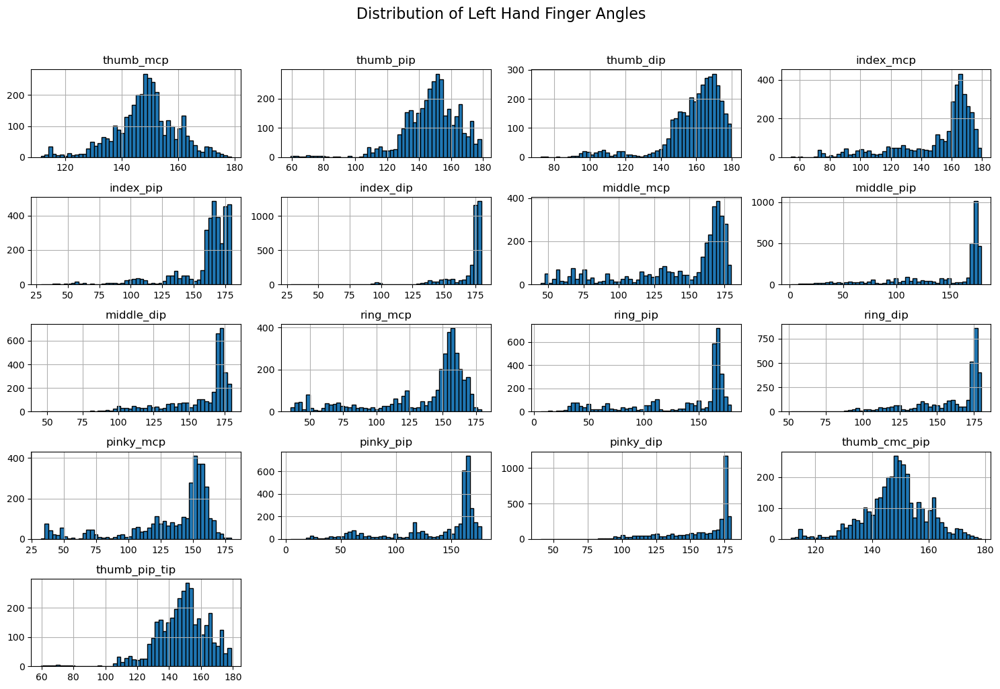

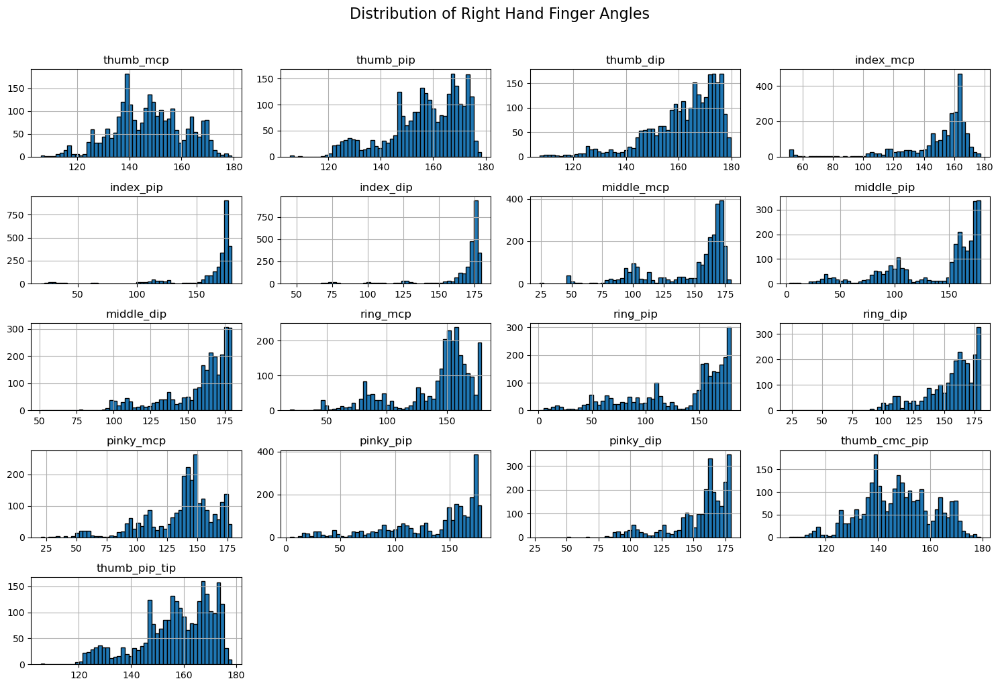


Plotting Palm Orientation Distributions:


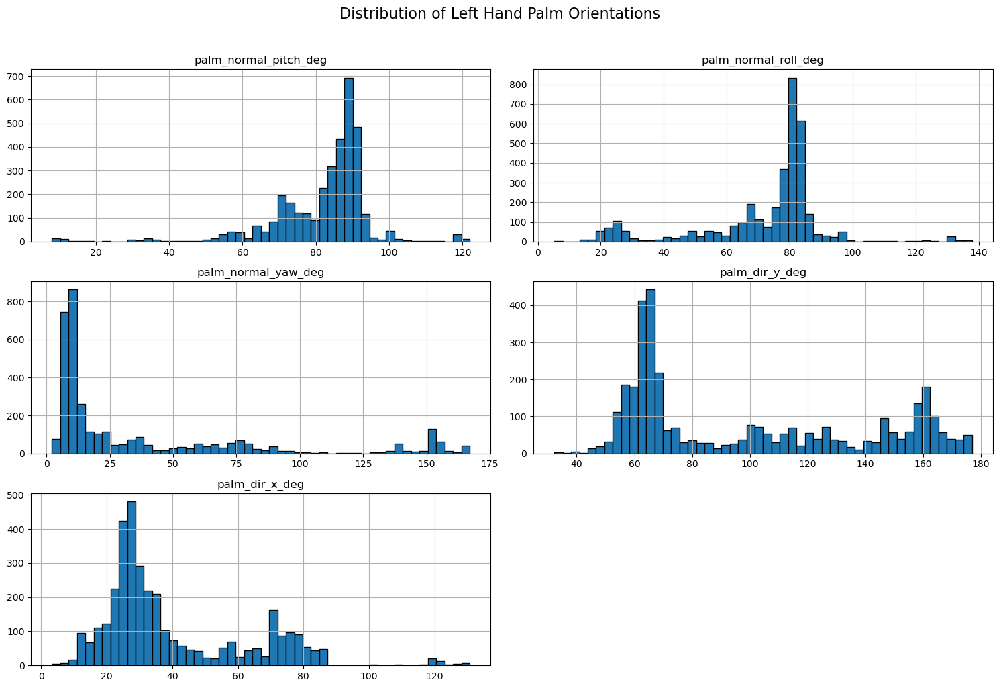

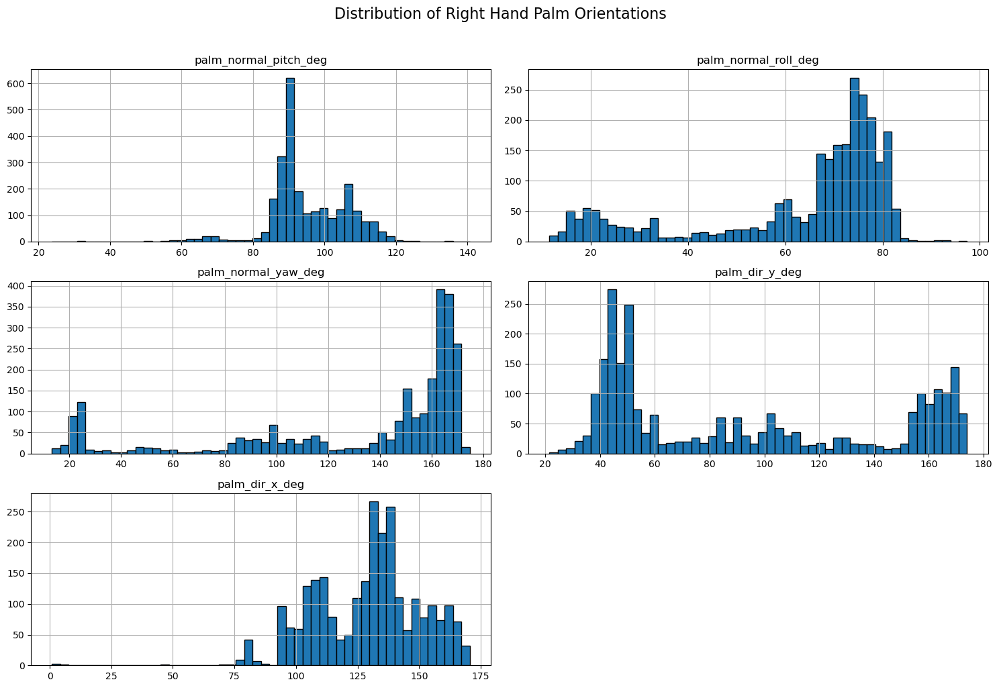

In [102]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Flatten the finger angle and palm orientation dictionaries into lists for plotting
# We need to handle the fact that some frames might not have hand detections (values are None)

left_hand_angles_list = []
left_hand_orientations_list = []
right_hand_angles_list = []
right_hand_orientations_list = []


for video_data in all_left_hand_finger_angles:
    for frame_angles in video_data['frames']:
        if frame_angles is not None:
            left_hand_angles_list.append(frame_angles)

for video_data in all_left_hand_palm_orientations:
    for frame_orientations in video_data['frames']:
         if frame_orientations is not None:
            left_hand_orientations_list.append(frame_orientations)


for video_data in all_right_hand_finger_angles:
    for frame_angles in video_data['frames']:
        if frame_angles is not None:
            right_hand_angles_list.append(frame_angles)

for video_data in all_right_hand_palm_orientations:
    for frame_orientations in video_data['frames']:
         if frame_orientations is not None:
            right_hand_orientations_list.append(frame_orientations)


# Convert lists of dictionaries to DataFrames for easier plotting
left_angles_df = pd.DataFrame(left_hand_angles_list)
left_orientations_df = pd.DataFrame(left_hand_orientations_list)
right_angles_df = pd.DataFrame(right_hand_angles_list)
right_orientations_df = pd.DataFrame(right_hand_orientations_list)


# --- Plotting Finger Angle Distributions ---

print("Plotting Finger Angle Distributions:")

# Left Hand Finger Angles
if not left_angles_df.empty:
    left_angles_df.hist(figsize=(15, 10), bins=50, edgecolor='black')
    plt.suptitle('Distribution of Left Hand Finger Angles', y=1.02, fontsize=16)
    plt.tight_layout()
    plt.show()
else:
    print("No left hand finger angle data to plot.")

# Right Hand Finger Angles
if not right_angles_df.empty:
    right_angles_df.hist(figsize=(15, 10), bins=50, edgecolor='black')
    plt.suptitle('Distribution of Right Hand Finger Angles', y=1.02, fontsize=16)
    plt.tight_layout()
    plt.show()
else:
    print("No right hand finger angle data to plot.")


# --- Plotting Palm Orientation Distributions ---

print("\nPlotting Palm Orientation Distributions:")

# Left Hand Palm Orientations
if not left_orientations_df.empty:
    left_orientations_df.hist(figsize=(15, 10), bins=50, edgecolor='black')
    plt.suptitle('Distribution of Left Hand Palm Orientations', y=1.02, fontsize=16)
    plt.tight_layout()
    plt.show()
else:
    print("No left hand palm orientation data to plot.")

# Right Hand Palm Orientations
if not right_orientations_df.empty:
    right_orientations_df.hist(figsize=(15, 10), bins=50, edgecolor='black')
    plt.suptitle('Distribution of Right Hand Palm Orientations', y=1.02, fontsize=16)
    plt.tight_layout()
    plt.show()
else:
    print("No right hand palm orientation data to plot.")

In [103]:
relative_hand_positions = []

for video_data in all_landmark_data:
    video_hand_trajectories = {'left': [], 'right': []}
    for frame_data in video_data['frames']:
        pose_landmarks = frame_data['pose_landmarks']
        if pose_landmarks:
            # Get shoulder landmarks
            left_shoulder = pose_landmarks.landmark[11]
            right_shoulder = pose_landmarks.landmark[12]

            # Calculate shoulder midpoint as the reference
            shoulder_midpoint_x = (left_shoulder.x + right_shoulder.x) / 2
            shoulder_midpoint_y = (left_shoulder.y + right_shoulder.y) / 2
            shoulder_midpoint_z = (left_shoulder.z + right_shoulder.z) / 2

            # Get hand landmarks (using wrists as a proxy for hand position)
            left_hand = pose_landmarks.landmark[15]
            right_hand = pose_landmarks.landmark[16]

            # Calculate and store relative positions
            if left_hand:
                video_hand_trajectories['left'].append([
                    left_hand.x - shoulder_midpoint_x,
                    left_hand.y - shoulder_midpoint_y,
                    left_hand.z - shoulder_midpoint_z
                ])
            if right_hand:
                video_hand_trajectories['right'].append([
                    right_hand.x - shoulder_midpoint_x,
                    right_hand.y - shoulder_midpoint_y,
                    right_hand.z - shoulder_midpoint_z
                ])

    relative_hand_positions.append({
        'video_file': video_data['video_file'],
        'trajectories': video_hand_trajectories
    })

print("Calculated relative hand positions for all videos.")


Calculated relative hand positions for all videos.


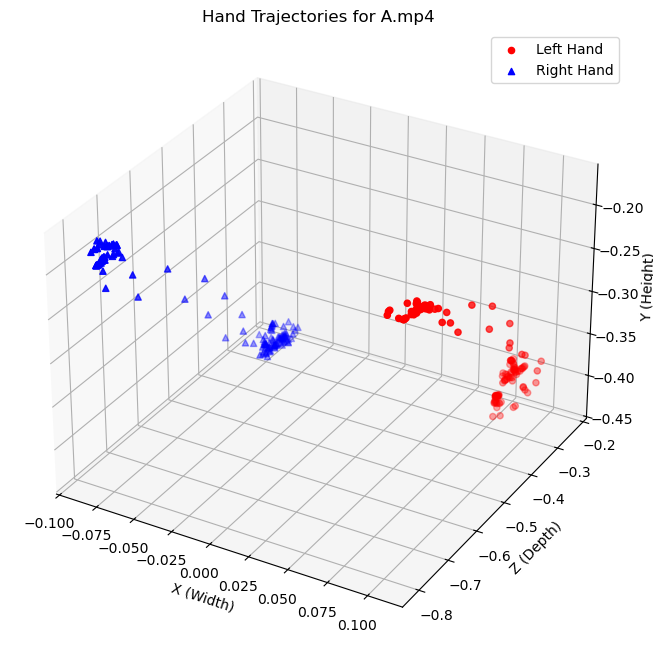

In [104]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Let's visualize the first gesture
gesture_to_visualize = relative_hand_positions[0]
left_trajectory = np.array(gesture_to_visualize['trajectories']['left'])
right_trajectory = np.array(gesture_to_visualize['trajectories']['right'])

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot left hand trajectory
if left_trajectory.any():
    ax.scatter(left_trajectory[:, 0], left_trajectory[:, 2], -left_trajectory[:, 1], c='r', marker='o', label='Left Hand')

# Plot right hand trajectory
if right_trajectory.any():
    ax.scatter(right_trajectory[:, 0], right_trajectory[:, 2], -right_trajectory[:, 1], c='b', marker='^', label='Right Hand')

ax.set_xlabel('X (Width)')
ax.set_ylabel('Z (Depth)')
ax.set_zlabel('Y (Height)')
ax.set_title(f"Hand Trajectories for {os.path.basename(gesture_to_visualize['video_file'])}")
ax.legend()
plt.show()

In [105]:
all_left_hand_points = np.array([point for gesture in relative_hand_positions for point in gesture['trajectories']['left']])
all_right_hand_points = np.array([point for gesture in relative_hand_positions for point in gesture['trajectories']['right']])

# Combine all hand points
all_hand_points = np.concatenate((all_left_hand_points, all_right_hand_points), axis=0)

if all_hand_points.any():
    min_x, min_y, min_z = np.min(all_hand_points, axis=0)
    max_x, max_y, max_z = np.max(all_hand_points, axis=0)

    print("Signing Space Boundaries:")
    print(f"X Range (Width): {min_x:.4f} to {max_x:.4f}")
    print(f"Y Range (Height): {min_y:.4f} to {max_y:.4f}")
    print(f"Z Range (Depth): {min_z:.4f} to {max_z:.4f}")

Signing Space Boundaries:
X Range (Width): -0.1180 to 0.1446
Y Range (Height): -0.0341 to 0.5120
Z Range (Depth): -0.8603 to -0.1166


In [106]:
# Create a dictionary to hold the boundaries for each gesture category
gesture_boundaries = {}

for gesture in relative_hand_positions:
    # Extract the gesture name (e.g., 'P' from '/content/Character/Goa Board of Education/P.mp4')
    gesture_name = os.path.splitext(os.path.basename(gesture['video_file']))[0]

    left_points = np.array(gesture['trajectories']['left'])
    right_points = np.array(gesture['trajectories']['right'])
    all_points = np.concatenate((left_points, right_points), axis=0) if left_points.any() and right_points.any() else (left_points if left_points.any() else right_points)


    if all_points.any():
        min_coords = np.min(all_points, axis=0)
        max_coords = np.max(all_points, axis=0)
        gesture_boundaries[gesture_name] = {'min': min_coords, 'max': max_coords}

# Print the boundaries for a few gestures to compare
for i, (name, bounds) in enumerate(gesture_boundaries.items()):
    if i >= 5: break # Limit to first 5 for brevity
    print(f"--- Gesture: {name} ---")
    print(f"  X Range: {bounds['min'][0]:.4f} to {bounds['max'][0]:.4f}")
    print(f"  Y Range: {bounds['min'][1]:.4f} to {bounds['max'][1]:.4f}")
    print(f"  Z Range: {bounds['min'][2]:.4f} to {bounds['max'][2]:.4f}\n")

--- Gesture: A ---
  X Range: -0.0878 to 0.1073
  Y Range: 0.1728 to 0.4333
  Z Range: -0.8124 to -0.2296

--- Gesture: B ---
  X Range: -0.0918 to 0.1157
  Y Range: 0.1619 to 0.4653
  Z Range: -0.7995 to -0.2170

--- Gesture: C ---
  X Range: -0.0926 to 0.1092
  Y Range: 0.1903 to 0.5120
  Z Range: -0.7020 to -0.1166

--- Gesture: D ---
  X Range: -0.0856 to 0.1137
  Y Range: 0.1592 to 0.4244
  Z Range: -0.7980 to -0.2051

--- Gesture: E ---
  X Range: -0.0736 to 0.1319
  Y Range: 0.1181 to 0.4536
  Z Range: -0.8158 to -0.1966



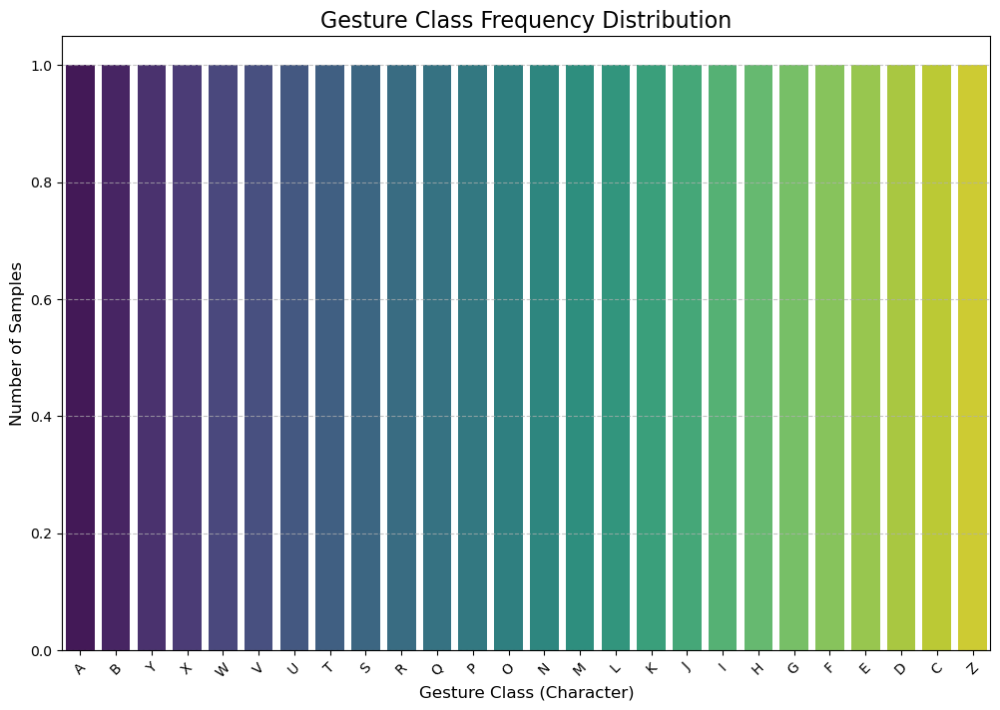

Class Counts:
A    1
B    1
Y    1
X    1
W    1
V    1
U    1
T    1
S    1
R    1
Q    1
P    1
O    1
N    1
M    1
L    1
K    1
J    1
I    1
H    1
G    1
F    1
E    1
D    1
C    1
Z    1
Name: count, dtype: int64


In [107]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Extract gesture class names from the video file paths
# Example path: '/content/Character/Goa Board of Education/P.mp4'
gesture_classes = [os.path.splitext(os.path.basename(video['video_file']))[0] for video in all_landmark_data]

# Create a frequency count of each gesture class
class_counts = pd.Series(gesture_classes).value_counts()

# Create a bar chart to visualize the frequencies
plt.figure(figsize=(12, 8))
sns.barplot(x=class_counts.index, y=class_counts.values, palette="viridis")
plt.title('Gesture Class Frequency Distribution', fontsize=16)
plt.xlabel('Gesture Class (Character)', fontsize=12)
plt.ylabel('Number of Samples', fontsize=12)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

print("Class Counts:")
print(class_counts)

In [108]:
# Calculate the counts for the majority and minority classes
majority_class_count = class_counts.max()
minority_class_count = class_counts.min()

# Avoid division by zero if there are no classes
if minority_class_count > 0:
    imbalance_ratio = majority_class_count / minority_class_count
    print(f"Majority Class Count: {majority_class_count}")
    print(f"Minority Class Count: {minority_class_count}")
    print(f"Class Imbalance Ratio: {imbalance_ratio:.2f}:1")
else:
    print("Could not calculate imbalance ratio (no minority class found).")

Majority Class Count: 1
Minority Class Count: 1
Class Imbalance Ratio: 1.00:1


In [109]:
# Identify minority classes (e.g., classes with fewer than a certain threshold)
# Let's define the threshold as 25% of the average number of samples
average_count = class_counts.mean()
minority_threshold = average_count * 0.25

minority_classes = class_counts[class_counts < minority_threshold]

if not minority_classes.empty:
    print("\nMinority Classes (candidates for data augmentation):")
    print(minority_classes)
else:
    print("\nNo significant minority classes were identified based on the threshold.")


No significant minority classes were identified based on the threshold.


# Task
Analyze the distribution of hand gestures by clustering hand landmarks extracted using MediaPipe.

## Prepare data for clustering

### Subtask:
Extract the hand landmark features from the processed data and structure them into a suitable format for clustering (e.g., a 2D array where each row is a feature vector for a hand in a frame). Consider using normalized coordinates or key angles/distances.


**Reasoning**:
Extract and structure the hand landmark features for clustering.



In [110]:
import numpy as np

hand_features = []
for video_data in all_landmark_data:
    for frame_data in video_data['frames']:
        for hand_landmarks in [frame_data['left_hand_landmarks'], frame_data['right_hand_landmarks']]:
            if hand_landmarks:
                # Flatten the landmark coordinates into a single feature vector
                features = [lm.x for lm in hand_landmarks.landmark] + \
                           [lm.y for lm in hand_landmarks.landmark] + \
                           [lm.z for lm in hand_landmarks.landmark]
                hand_features.append(features)

# Convert the list of features to a NumPy array
hand_features_np = np.array(hand_features)

print(f"Extracted features for {hand_features_np.shape[0]} hands.")
print(f"Shape of the feature matrix: {hand_features_np.shape}")

Extracted features for 7366 hands.
Shape of the feature matrix: (7366, 63)


##Determine Optimal Number of Clusters
Now, let's use the elbow method to determine the optimal number of clusters for our K-Means algorithm. We'll calculate the sum of squared distances for a range of cluster numbers and plot the results.



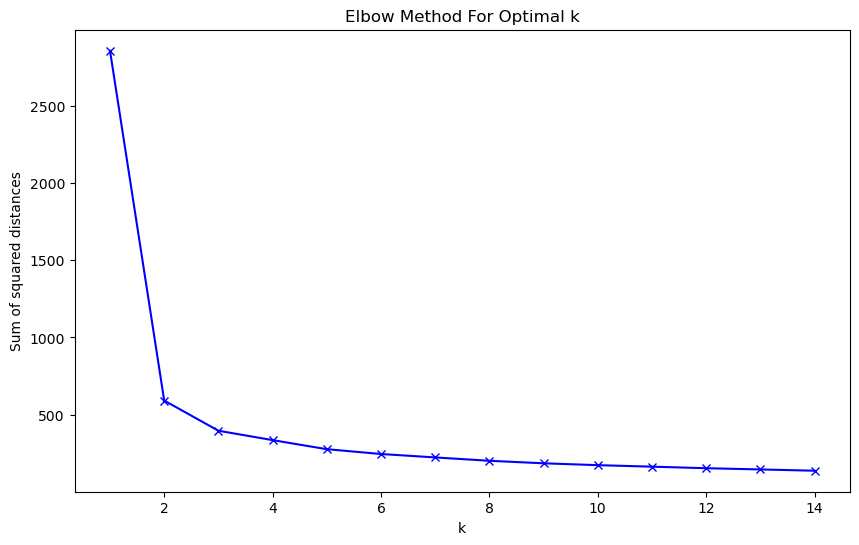

In [111]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Calculate sum of squared distances for a range of k values
sum_of_squared_distances = []
K = range(1, 15)
for k in K:
    km = KMeans(n_clusters=k, random_state=42, n_init=10) # Set n_init explicitly
    km = km.fit(hand_features_np)
    sum_of_squared_distances.append(km.inertia_)

# Plot the elbow curve
plt.figure(figsize=(10, 6))
plt.plot(K, sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum of squared distances')
plt.title('Elbow Method For Optimal k')
plt.show()

##Apply Clustering and Analyze Distribution
From the elbow plot, you can choose an optimal 'k' where the rate of decrease sharply changes. For this analysis, let's assume the optimal number of clusters is 6. Now we'll apply K-Means with k=6 and analyze the cluster distribution.

Cluster Distribution:
0    4092
1    1845
2    1429
Name: count, dtype: int64


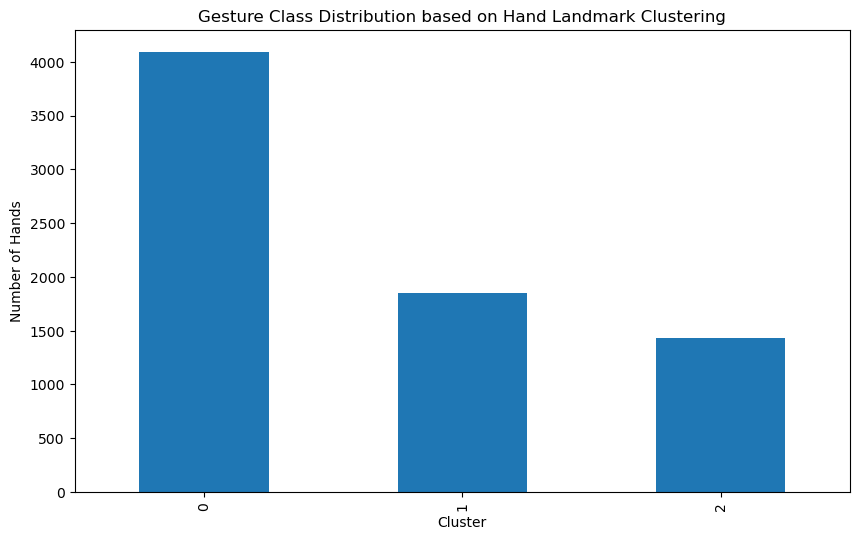

In [112]:
from sklearn.cluster import KMeans
import pandas as pd

# Apply KMeans with the chosen number of clusters
n_clusters = 3 # You can adjust this based on your elbow plot
kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10) # Set n_init explicitly
kmeans.fit(hand_features_np)
cluster_labels = kmeans.labels_

# Analyze cluster distribution
cluster_distribution = pd.Series(cluster_labels).value_counts().sort_index()
print("Cluster Distribution:")
print(cluster_distribution)

# Visualize the cluster distribution
plt.figure(figsize=(10, 6))
cluster_distribution.plot(kind='bar')
plt.xlabel('Cluster')
plt.ylabel('Number of Hands')
plt.title('Gesture Class Distribution based on Hand Landmark Clustering')
plt.show()

##Visualize and Interpret Clusters
To understand what each cluster represents, let's visualize a few sample hand poses from each cluster.

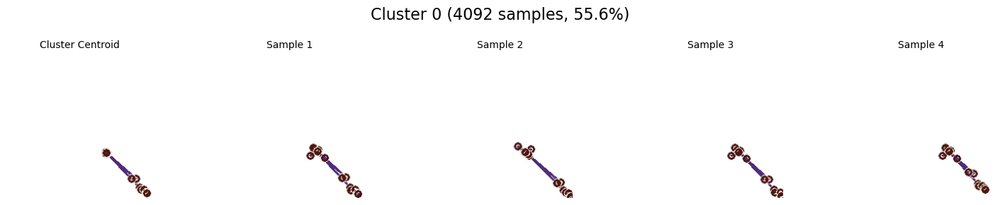

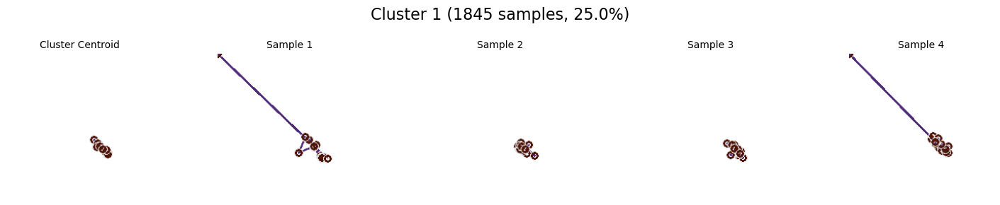

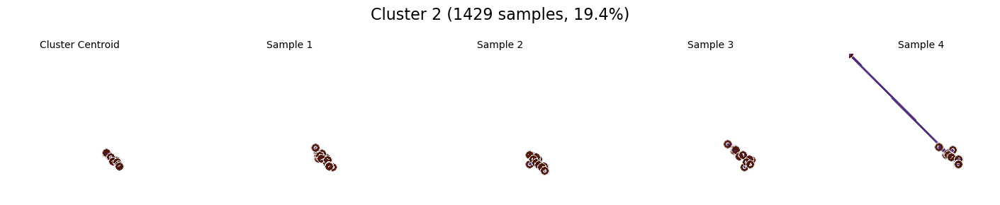

In [113]:
import random
import numpy as np
import mediapipe as mp
import matplotlib.pyplot as plt
from mediapipe.framework.formats import landmark_pb2

# --- This helper function will be used to draw a hand ---
def draw_hand(image, landmark_data):
    # Create a NormalizedLandmarkList object
    hand_landmarks_proto = landmark_pb2.NormalizedLandmarkList()

    # Add each landmark to the list
    for lm_coords in landmark_data:
        landmark = hand_landmarks_proto.landmark.add()
        landmark.x = lm_coords[0]
        landmark.y = lm_coords[1]
        landmark.z = lm_coords[2]

    # Draw the hand landmarks on the image
    mp_drawing.draw_landmarks(
        image,
        hand_landmarks_proto,
        mp_hands.HAND_CONNECTIONS,
        mp_drawing.DrawingSpec(color=(80, 22, 10), thickness=2, circle_radius=4),
        mp_drawing.DrawingSpec(color=(80, 44, 121), thickness=2, circle_radius=2)
    )
    return image
# ---------------------------------------------------------


# Get the indices of hands in each cluster
cluster_indices = {}
for i, label in enumerate(cluster_labels):
    if label not in cluster_indices:
        cluster_indices[label] = []
    cluster_indices[label].append(i)

# Initialize MediaPipe drawing utilities
mp_hands = mp.solutions.hands
mp_drawing = mp.solutions.drawing_utils

# Get cluster centroids and distribution info
centroids = kmeans.cluster_centers_
total_samples = len(cluster_labels)
cluster_counts = pd.Series(cluster_labels).value_counts()


# Visualize the centroid and a few random samples from each cluster
for cluster_id in sorted(cluster_indices.keys()):
    indices = cluster_indices[cluster_id]

    # Get cluster stats for the title
    count = cluster_counts[cluster_id]
    percentage = (count / total_samples) * 100

    # Get the centroid for this cluster
    centroid_data = centroids[cluster_id].reshape(21, 3)

    # Get a few random samples (ensure we don't pick more than available)
    num_samples_to_show = 4
    sample_indices = random.sample(indices, min(num_samples_to_show, len(indices)))

    # Create subplots (1 for centroid + number of samples)
    fig, axes = plt.subplots(1, 1 + len(sample_indices), figsize=(15, 3))

    # --- Plot the Centroid ---
    centroid_image = np.ones((200, 200, 3), dtype='uint8') * 255
    centroid_image = draw_hand(centroid_image, centroid_data)
    axes[0].imshow(centroid_image)
    axes[0].set_title("Cluster Centroid", fontsize=10)
    axes[0].axis('off')

    # --- Plot the Random Samples ---
    for i, sample_index in enumerate(sample_indices):
        sample_image = np.ones((200, 200, 3), dtype='uint8') * 255
        landmarks_for_sample = hand_features_np[sample_index].reshape(21, 3)
        sample_image = draw_hand(sample_image, landmarks_for_sample)
        axes[i+1].imshow(sample_image)
        axes[i+1].set_title(f"Sample {i+1}", fontsize=10)
        axes[i+1].axis('off')

    fig.suptitle(f'Cluster {cluster_id} ({count} samples, {percentage:.1f}%)', fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95]) # Adjust layout to prevent title overlap
    plt.show()

Running KMeans for n=2 through n=12...
Analysis complete. Generating summary plot...


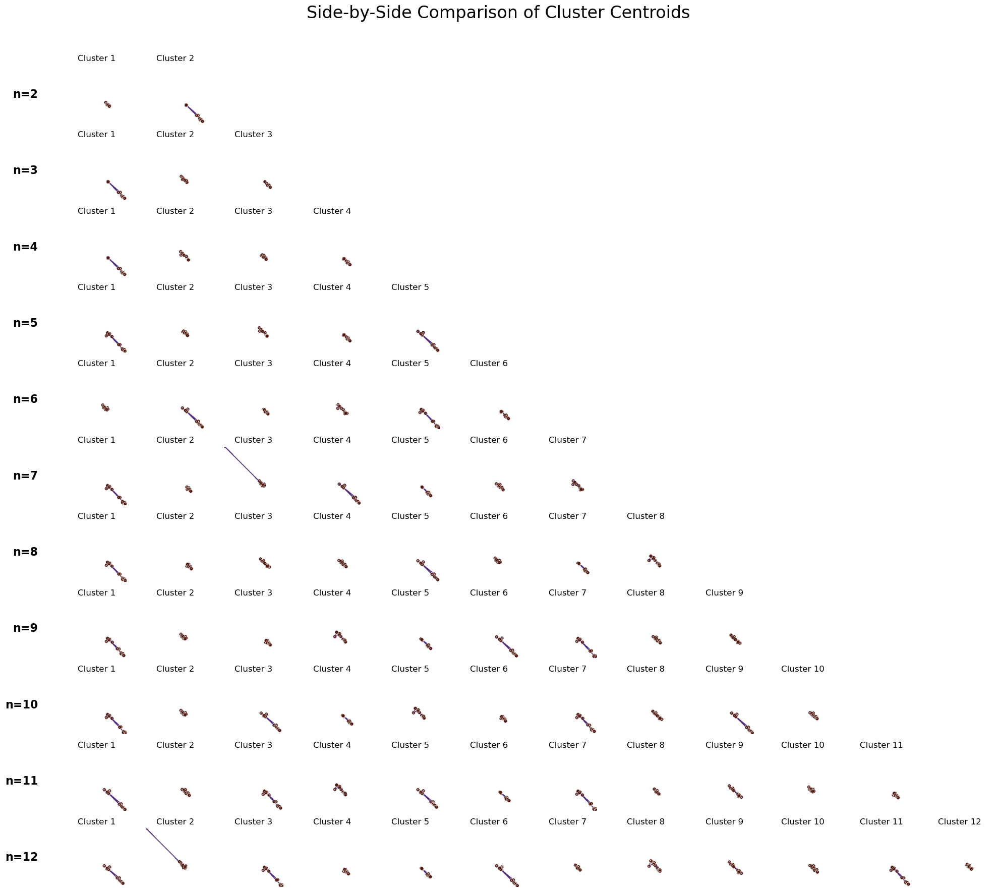

In [114]:
import numpy as np
import pandas as pd
import mediapipe as mp
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from mediapipe.framework.formats import landmark_pb2

# ==================================================================
#                       HELPER FUNCTION
# ==================================================================

# --- Initialize MediaPipe utilities once ---
mp_drawing = mp.solutions.drawing_utils
mp_hands = mp.solutions.hands

def draw_hand(image, landmark_data):
    """Draws hand landmarks and connections on a given image."""
    hand_landmarks_proto = landmark_pb2.NormalizedLandmarkList()
    for lm_coords in landmark_data:
        landmark = hand_landmarks_proto.landmark.add()
        landmark.x, landmark.y, landmark.z = lm_coords

    mp_drawing.draw_landmarks(
        image=image,
        landmark_list=hand_landmarks_proto,
        connections=mp_hands.HAND_CONNECTIONS,
        landmark_drawing_spec=mp_drawing.DrawingSpec(color=(80, 22, 10), thickness=2, circle_radius=4),
        connection_drawing_spec=mp_drawing.DrawingSpec(color=(80, 44, 121), thickness=2, circle_radius=2)
    )
    return image

# ==================================================================
#                   ANALYSIS & SUMMARY PLOT
# ==================================================================

# This assumes 'hand_features_np' is already defined and loaded.

# --- 1. Run KMeans for each n_clusters and store the centroids ---
all_centroids = {}
cluster_range = range(2, 13)

print("Running KMeans for n=2 through n=12...")
for n_clusters in cluster_range:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
    kmeans.fit(hand_features_np)
    all_centroids[n_clusters] = kmeans.cluster_centers_
print("Analysis complete. Generating summary plot...")

# --- 2. Create the consolidated summary plot ---
max_clusters = max(cluster_range)
num_rows = len(cluster_range)

# Create a figure with a subplot for each potential centroid
fig, axes = plt.subplots(num_rows, max_clusters, figsize=(20, 18))
fig.suptitle('Side-by-Side Comparison of Cluster Centroids', fontsize=24)

for i, n_clusters in enumerate(cluster_range):
    centroids = all_centroids[n_clusters]

    # --- Label the row ---
    ax_row_label = axes[i, 0]
    ax_row_label.text(-0.5, 0.5, f'n={n_clusters}',
                      transform=ax_row_label.transAxes,
                      fontsize=16, va='center', ha='right', weight='bold')

    # --- Plot each centroid in its column ---
    for j in range(max_clusters):
        ax = axes[i, j]
        if j < len(centroids):
            # We have a centroid to plot
            centroid_landmarks = centroids[j].reshape(21, 3)
            centroid_image = np.ones((200, 200, 3), dtype=np.uint8) * 255
            centroid_image = draw_hand(centroid_image, centroid_landmarks)
            ax.imshow(centroid_image)
            ax.set_title(f'Cluster {j+1}')

        # --- Clean up axes ---
        ax.axis('off')

# --- Final layout adjustments ---
plt.tight_layout(rect=[0, 0, 1, 0.96]) # Adjust for suptitle
plt.show()

Running KMeans and generating distribution plots...


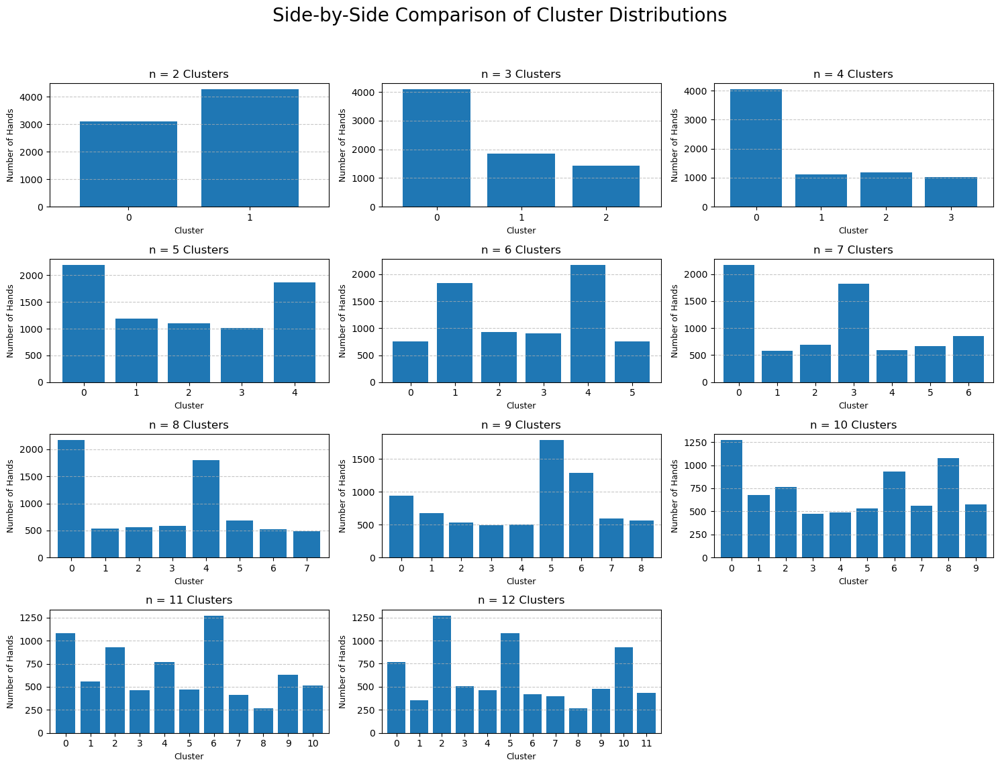

In [115]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# ==================================================================
#                   ANALYSIS & SUMMARY PLOT
# ==================================================================

# This assumes 'hand_features_np' is already defined and loaded.

# --- 1. Define the range of clusters to test ---
cluster_range = range(2, 13)
num_plots = len(cluster_range)

# --- 2. Create a grid of subplots for the bar charts ---
# We'll use a 4x3 grid to fit all 11 charts
nrows = 4
ncols = 3
fig, axes = plt.subplots(nrows, ncols, figsize=(15, 12))
fig.suptitle('Side-by-Side Comparison of Cluster Distributions', fontsize=20)

# Flatten the axes array to make it easy to iterate over
axes = axes.flatten()

print("Running KMeans and generating distribution plots...")

# --- 3. Loop through, run KMeans, and plot on the corresponding subplot ---
for i, n_clusters in enumerate(cluster_range):
    ax = axes[i]

    # Run KMeans
    kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
    kmeans.fit(hand_features_np)
    cluster_labels = kmeans.labels_

    # Get the distribution
    cluster_distribution = pd.Series(cluster_labels).value_counts().sort_index()

    # Plot the bar chart on its designated subplot
    cluster_distribution.plot(kind='bar', ax=ax, width=0.8)

    # --- Customize the subplot ---
    ax.set_title(f'n = {n_clusters} Clusters', fontsize=12)
    ax.set_xlabel('Cluster', fontsize=9)
    ax.set_ylabel('Number of Hands', fontsize=9)
    ax.tick_params(axis='x', rotation=0) # Keep x-axis labels horizontal
    ax.grid(axis='y', linestyle='--', alpha=0.7)


# --- 4. Turn off any unused subplots in the grid ---
# Our grid is 4x3=12, but we only have 11 plots (from n=2 to n=12)
for i in range(num_plots, len(axes)):
    axes[i].axis('off')

# --- 5. Final layout adjustments and display ---
plt.tight_layout(rect=[0, 0.03, 1, 0.95]) # Adjust for suptitle
plt.show()

In [116]:
import numpy as np
import pandas as pd

# This code assumes 'hand_features_np' (the NumPy array for clustering) and
# 'hand_features_df' (the likely source DataFrame) are already loaded in memory.

print("Checking for NaN values in the clustering data...\n" + "="*50)

# --- Method 1: Check the NumPy array directly ---
# This is the most direct check on the data fed into KMeans.
print("\n1. Checking the NumPy array (hand_features_np)...")
nan_count_np = np.isnan(hand_features_np).sum()

if nan_count_np > 0:
    print(f"  [!] WARNING: Found {nan_count_np} NaN value(s) in the NumPy array.")
    # Optional: Find the exact locations of NaNs
    # nan_locations = np.argwhere(np.isnan(hand_features_np))
    # print(f"  Locations (row, column):\n{nan_locations}")
else:
    print("  [✓] SUCCESS: No NaN values found in the NumPy array.")


# --- Method 2: Check the source Pandas DataFrame ---
# This is often more informative as it shows NaNs per feature/column.
print("\n2. Checking the source DataFrame (hand_features_df)...")
try:
    # Check if the DataFrame exists
    if 'hand_features_df' in locals() or 'hand_features_df' in globals():
        nan_count_df = hand_features_df.isnull().sum().sum()

        if nan_count_df > 0:
            print(f"  [!] WARNING: Found {nan_count_df} NaN value(s) in the DataFrame.")
            print("  NaN counts per column:")
            # This will show which specific landmark coordinates have missing values
            print(hand_features_df.isnull().sum()[hand_features_df.isnull().sum() > 0])
        else:
            print("  [✓] SUCCESS: No NaN values found in the source DataFrame.")
    else:
        print("  INFO: 'hand_features_df' not found. Skipping this check.")

except Exception as e:
    print(f"  An error occurred while checking the DataFrame: {e}")

print("\n" + "="*50)

Checking for NaN values in the clustering data...

1. Checking the NumPy array (hand_features_np)...
  [✓] SUCCESS: No NaN values found in the NumPy array.

2. Checking the source DataFrame (hand_features_df)...
  [✓] SUCCESS: No NaN values found in the source DataFrame.



Preparing data: Extracting features from DataFrame...
Safely parsing data columns...
Creating new feature set for clustering...
Creating landmark array for visualization...
Data preparation complete.
Shape of the new feature set for clustering: (6113, 22)
Shape of the landmark data for visualization: (6113, 63)

Part 2: Generating side-by-side distribution plots...


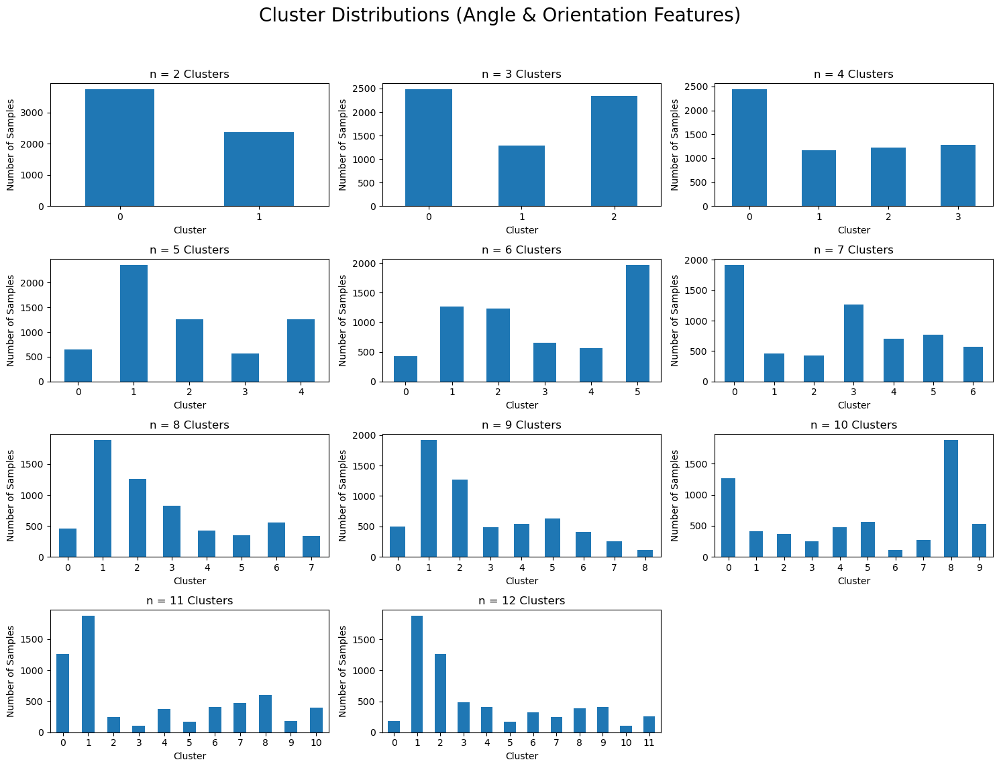


Part 3: Generating side-by-side centroid visualizations...


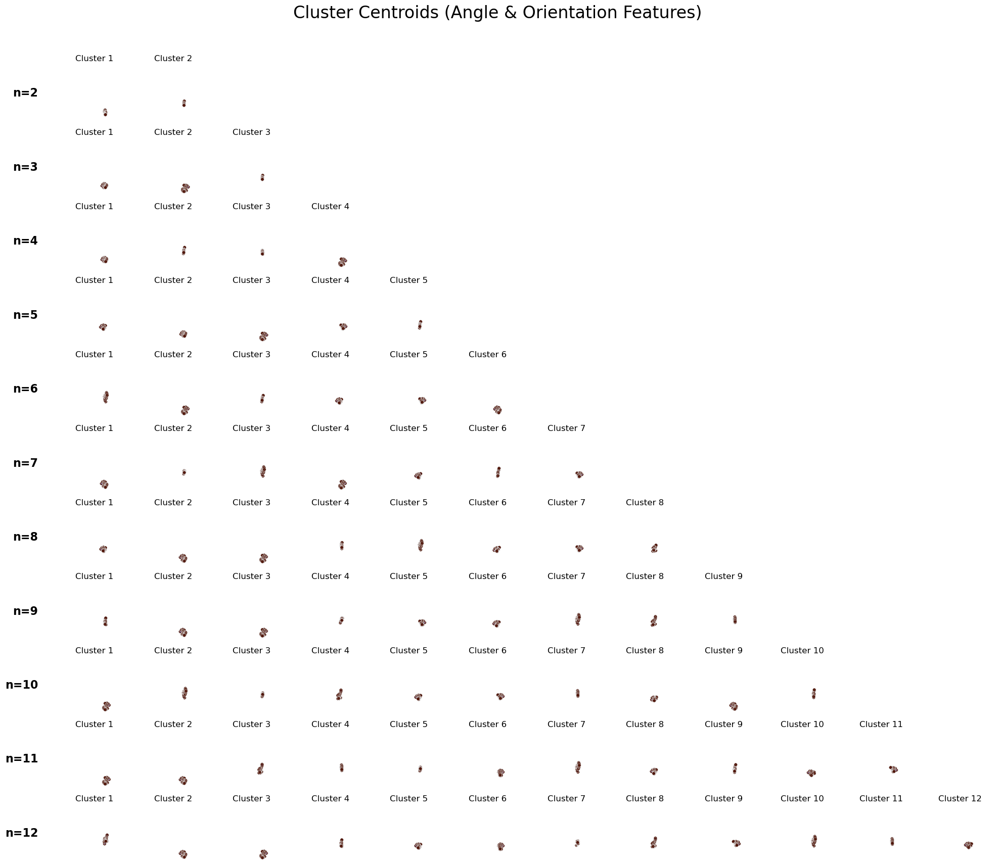

In [117]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import ast
from sklearn.cluster import KMeans

# ==================================================================
#                       PART 1: DATA PREPARATION (Corrected)
# ==================================================================

print("Preparing data: Extracting features from DataFrame...")

def robust_literal_eval(val):
    """
    Safely evaluates a string literal. If the value is already a
    dictionary or list, it returns it directly.
    """
    if isinstance(val, (dict, list)):
        return val
    try:
        return ast.literal_eval(val)
    except (ValueError, SyntaxError):
        # Return an empty dict or list if parsing fails,
        # or handle as you see fit.
        return {}

# --- Step 1: Apply the robust parsing function to each column ---
print("Safely parsing data columns...")
hand_features_df['finger_angles_dict'] = hand_features_df['finger_angles'].apply(robust_literal_eval)
hand_features_df['palm_orientation_dict'] = hand_features_df['palm_orientation'].apply(robust_literal_eval)
hand_features_df['landmark_coords_dict'] = hand_features_df['landmark_coords'].apply(robust_literal_eval)

# --- Step 2: Create the feature set for clustering (Angles + Orientation) ---
print("Creating new feature set for clustering...")
angles_df = pd.json_normalize(hand_features_df['finger_angles_dict'])
orientation_df = pd.json_normalize(hand_features_df['palm_orientation_dict'])
new_features_df = pd.concat([angles_df, orientation_df], axis=1)
new_features_np = new_features_df.to_numpy()

# --- Step 3: Create the landmark array needed for VISUALIZING the centroids ---
print("Creating landmark array for visualization...")
def landmarks_to_array(landmark_list):
    if not isinstance(landmark_list, list) or not landmark_list:
        return np.zeros(63) # Return a zero array for invalid data
    arr = np.array([[lm.get('x', 0), lm.get('y', 0), lm.get('z', 0)] for lm in landmark_list])
    return arr.flatten()

original_landmarks_np = np.stack(hand_features_df['landmark_coords_dict'].apply(landmarks_to_array))

print("Data preparation complete.")
print(f"Shape of the new feature set for clustering: {new_features_np.shape}")
print(f"Shape of the landmark data for visualization: {original_landmarks_np.shape}")


# ==================================================================
#       PART 2: Side-by-Side Distribution Bar Charts
# ==================================================================

# (This part remains the same as before)
print("\nPart 2: Generating side-by-side distribution plots...")
cluster_range = range(2, 13)
num_plots = len(cluster_range)
nrows, ncols = 4, 3

fig_dist, axes_dist = plt.subplots(nrows, ncols, figsize=(15, 12))
fig_dist.suptitle('Cluster Distributions (Angle & Orientation Features)', fontsize=20)
axes_dist = axes_dist.flatten()

all_cluster_labels = {}

for i, n_clusters in enumerate(cluster_range):
    ax = axes_dist[i]
    kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
    kmeans.fit(new_features_np)
    cluster_labels = kmeans.labels_
    all_cluster_labels[n_clusters] = cluster_labels

    dist = pd.Series(cluster_labels).value_counts().sort_index()
    dist.plot(kind='bar', ax=ax)

    ax.set_title(f'n = {n_clusters} Clusters')
    ax.set_xlabel('Cluster'); ax.set_ylabel('Number of Samples')
    ax.tick_params(axis='x', rotation=0)

for i in range(num_plots, len(axes_dist)):
    axes_dist[i].axis('off')

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


# ==================================================================
#         PART 3: Side-by-Side Centroid Comparison (Corrected)
# ==================================================================

print("\nPart 3: Generating side-by-side centroid visualizations...")

# --- Correctly define the grid size ---
# Rows = number of 'n_clusters' values we are testing
# Columns = the maximum number of clusters we will have
num_rows = len(cluster_range)
max_cols = max(cluster_range)

fig_cent, axes_cent = plt.subplots(num_rows, max_cols, figsize=(20, 18))
fig_cent.suptitle('Cluster Centroids (Angle & Orientation Features)', fontsize=24)

# --- Loop using 2D indexing (the correct way) ---
for i, n_clusters in enumerate(cluster_range):
    # Set the label for the entire row (e.g., "n=2", "n=3")
    # We place it in the first column's position for alignment
    axes_cent[i, 0].text(-0.5, 0.5, f'n={n_clusters}', transform=axes_cent[i,0].transAxes,
                      fontsize=16, va='center', ha='right', weight='bold')

    labels = all_cluster_labels[n_clusters]

    # Inner loop for each centroid in the current row
    for j in range(n_clusters):
        # Use the correct 2D index to get the subplot
        ax = axes_cent[i, j]

        cluster_landmarks = original_landmarks_np[labels == j]
        if len(cluster_landmarks) > 0:
            centroid_pose = cluster_landmarks.mean(axis=0)
            img = np.ones((200, 200, 3), dtype=np.uint8) * 255
            # This assumes the 'draw_hand' function from previous cells is defined
            img = draw_hand(img, centroid_pose.reshape(21, 3))
            ax.imshow(img)
            ax.set_title(f'Cluster {j+1}')

# --- Turn off the axes for all subplots in the grid ---
for i in range(num_rows):
    for j in range(max_cols):
        axes_cent[i, j].axis('off')

plt.tight_layout(rect=[0, 0.03, 1, 0.96])
plt.show()

Part 1: Preparing trajectory data for clustering...
Trajectory data preparation complete.
Shape of the feature set: (52, 444)

Part 2: Generating side-by-side distribution plots for trajectories...


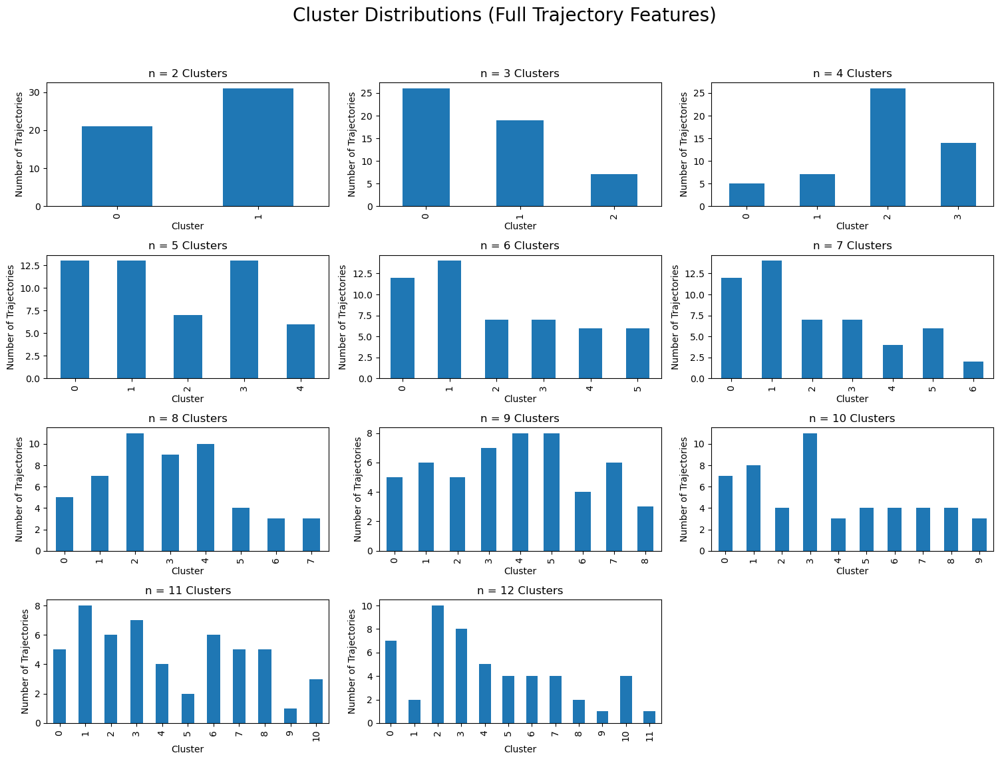


Part 3: Generating side-by-side trajectory centroid visualizations...


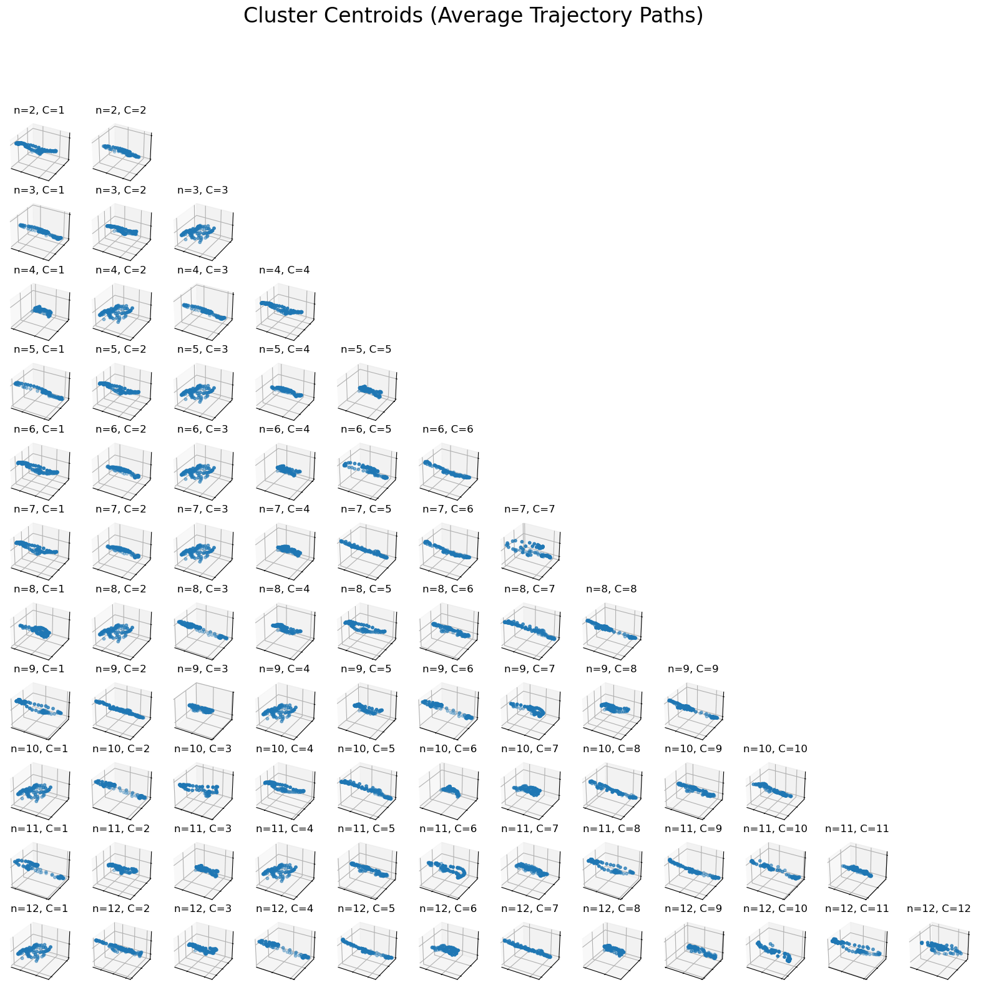

In [118]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.cluster import KMeans

# ==================================================================
#                       PART 1: TRAJECTORY DATA PREPARATION
# ==================================================================
# This assumes 'relative_hand_positions' is loaded and structured as in your example.

print("Part 1: Preparing trajectory data for clustering...")

all_trajectories = []
# Extract left and right hand trajectories into a single list
for gesture in relative_hand_positions:
    left_traj = np.array(gesture['trajectories']['left'])
    right_traj = np.array(gesture['trajectories']['right'])
    if left_traj.size > 0:
        all_trajectories.append(left_traj)
    if right_traj.size > 0:
        all_trajectories.append(right_traj)

# --- Pad trajectories to the same length for K-Means ---
if not all_trajectories:
    print("No trajectories found to cluster.")
else:
    # Find the length of the longest trajectory
    max_length = max(len(traj) for traj in all_trajectories)

    padded_trajectories = []
    for traj in all_trajectories:
        # Create a padded array with the last known coordinate
        pad_width = max_length - len(traj)
        if pad_width > 0:
            padding = np.tile(traj[-1], (pad_width, 1))
            padded_traj = np.vstack([traj, padding])
        else:
            padded_traj = traj
        padded_trajectories.append(padded_traj)

    # --- Flatten each trajectory into a single feature vector ---
    # Shape will be (num_trajectories, max_length * 3)
    trajectory_features_np = np.array([p.flatten() for p in padded_trajectories])

    print("Trajectory data preparation complete.")
    print(f"Shape of the feature set: {trajectory_features_np.shape}")


# ==================================================================
#       PART 2: Side-by-Side Distribution Bar Charts
# ==================================================================
    print("\nPart 2: Generating side-by-side distribution plots for trajectories...")

    cluster_range = range(2, 13)
    num_plots = len(cluster_range)
    nrows, ncols = 4, 3

    fig_dist, axes_dist = plt.subplots(nrows, ncols, figsize=(15, 12))
    fig_dist.suptitle('Cluster Distributions (Full Trajectory Features)', fontsize=20)
    axes_dist = axes_dist.flatten()

    all_centroids = {}

    for i, n_clusters in enumerate(cluster_range):
        ax = axes_dist[i]
        kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
        kmeans.fit(trajectory_features_np)

        all_centroids[n_clusters] = kmeans.cluster_centers_

        dist = pd.Series(kmeans.labels_).value_counts().sort_index()
        dist.plot(kind='bar', ax=ax)

        ax.set_title(f'n = {n_clusters} Clusters')
        ax.set_xlabel('Cluster'); ax.set_ylabel('Number of Trajectories')

    for i in range(num_plots, len(axes_dist)):
        axes_dist[i].axis('off')

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()


# ==================================================================
#         PART 3: Side-by-Side Centroid Trajectory Visualization
# ==================================================================
    print("\nPart 3: Generating side-by-side trajectory centroid visualizations...")

    num_rows = len(cluster_range)
    max_cols = max(cluster_range)

    fig_cent = plt.figure(figsize=(20, 18))
    fig_cent.suptitle('Cluster Centroids (Average Trajectory Paths)', fontsize=24)

    for i, n_clusters in enumerate(cluster_range):
        centroids = all_centroids[n_clusters]

        for j in range(n_clusters):
            # Create a 3D subplot for each centroid
            ax = fig_cent.add_subplot(num_rows, max_cols, i * max_cols + j + 1, projection='3d')

            # Reshape the flattened centroid back into a 3D path
            centroid_path = centroids[j].reshape((max_length, 3))

            # Plot the average trajectory path
            ax.scatter(centroid_path[:, 0], centroid_path[:, 2], -centroid_path[:, 1], marker='o', s=10)

            ax.set_title(f'n={n_clusters}, C={j+1}')
            # Optional: Hide axis labels for a cleaner look
            ax.set_xticklabels([])
            ax.set_yticklabels([])
            ax.set_zticklabels([])

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

Cluster Distribution (includes -1 as noise):
-1    1645
 0     121
 1     289
 2     354
 3     199
 4    2172
 5     137
 6    1997
 7     160
 8     112
 9     180
Name: count, dtype: int64


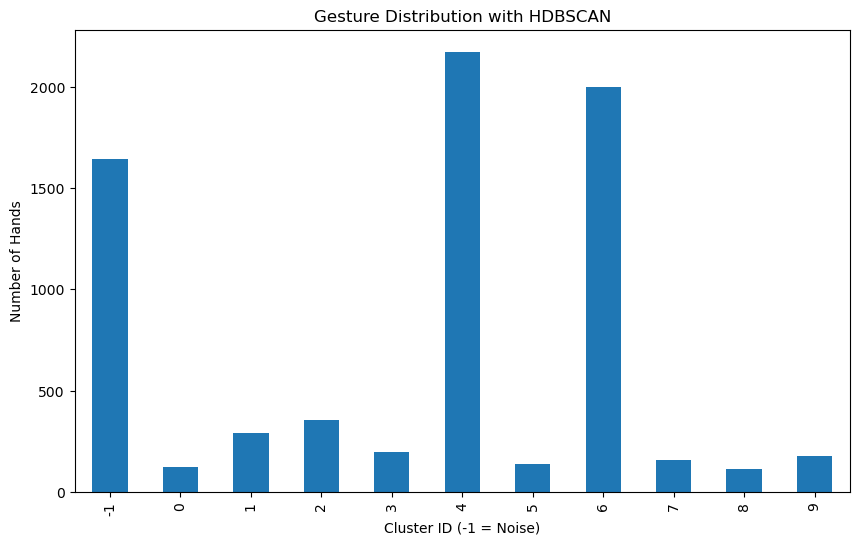


Estimated number of clusters: 10


In [119]:
# ==============================================
#   HDBSCAN Clustering on Hand Landmark Features
# ==============================================

import hdbscan
import matplotlib.pyplot as plt
import pandas as pd

# Run HDBSCAN
clusterer = hdbscan.HDBSCAN(
    min_cluster_size=100,   # force larger clusters
    min_samples=30,         # stricter density requirement
    cluster_selection_epsilon=0.05  # allow merging close clusters
)


cluster_labels = clusterer.fit_predict(hand_features_np)

# Analyze cluster distribution
cluster_distribution = pd.Series(cluster_labels).value_counts().sort_index()
print("Cluster Distribution (includes -1 as noise):")
print(cluster_distribution)

# Visualize the cluster distribution
plt.figure(figsize=(10, 6))
cluster_distribution.plot(kind='bar')
plt.xlabel('Cluster ID (-1 = Noise)')
plt.ylabel('Number of Hands')
plt.title('Gesture Distribution with HDBSCAN')
plt.show()

# (Optional) Check number of clusters excluding noise
n_clusters = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)
print(f"\nEstimated number of clusters: {n_clusters}")


In [120]:
import numpy as np
from scipy.spatial.distance import cdist
import random

# Assuming these exist in your notebook:
# hand_features_np = your feature matrix (n_samples x n_features)
hdbscan_labels = clusterer.labels_

cluster_ids = np.unique(hdbscan_labels)

cluster_representatives = {}

for cid in cluster_ids:
    if cid == -1:  # skip noise
        continue
    cluster_points = hand_features_np[hdbscan_labels == cid]

    # compute centroid (mean in feature space, though not real point)
    centroid = cluster_points.mean(axis=0)

    # find medoid: point closest to centroid
    distances = cdist([centroid], cluster_points, metric="euclidean")
    medoid_index = np.argmin(distances)
    medoid = cluster_points[medoid_index]

    # also pick 5 random examples to inspect variety
    random_examples = cluster_points[random.sample(range(len(cluster_points)), min(5, len(cluster_points)))]

    cluster_representatives[cid] = {
        "size": len(cluster_points),
        "centroid": centroid,
        "medoid": medoid,
        "examples": random_examples
    }

# Print summary
for cid, info in cluster_representatives.items():
    print(f"\nCluster {cid}: size={info['size']}")
    print("Medoid (first 10 dims):", info["medoid"][:10])
    print("Example sample (first 10 dims):", info["examples"][0][:10])



Cluster 0: size=121
Medoid (first 10 dims): [0.74102104 0.72460604 0.7085374  0.68911707 0.67900556 0.70570403
 0.67737466 0.68545151 0.6964885  0.70621043]
Example sample (first 10 dims): [0.73190224 0.72067463 0.70507264 0.68793344 0.67530304 0.70328897
 0.67485154 0.68479133 0.69512045 0.70165688]

Cluster 1: size=289
Medoid (first 10 dims): [0.77869022 0.75682372 0.7302323  0.70905536 0.69707376 0.72816801
 0.7035858  0.68827653 0.67621785 0.73345107]
Example sample (first 10 dims): [0.76393819 0.73760647 0.7171154  0.70149493 0.69139701 0.7340731
 0.70997882 0.69649744 0.68849492 0.73776889]

Cluster 2: size=354
Medoid (first 10 dims): [0.73135382 0.70938355 0.69468856 0.6848861  0.67262685 0.70331401
 0.70315748 0.70471179 0.70679843 0.71532285]
Example sample (first 10 dims): [0.72329921 0.70345533 0.69004112 0.68085635 0.6712569  0.70407015
 0.70378613 0.70518154 0.70736909 0.71513271]

Cluster 3: size=199
Medoid (first 10 dims): [0.74939305 0.72365874 0.70546299 0.69122761 0.

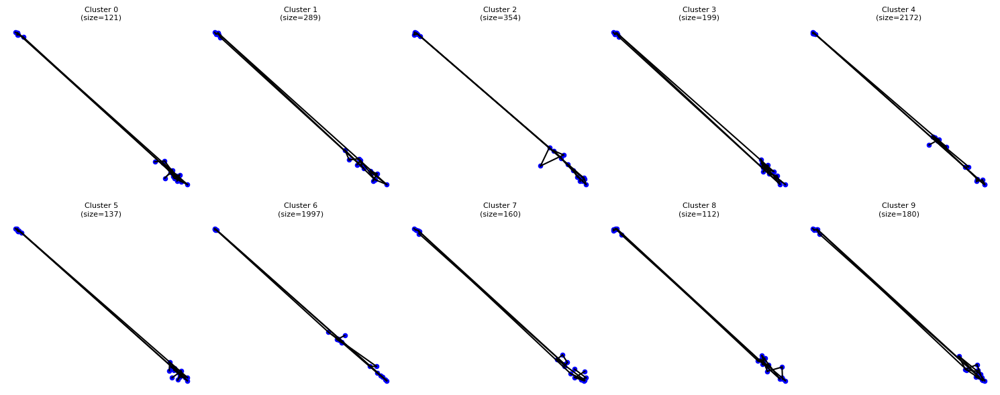

In [121]:
import matplotlib.pyplot as plt
import numpy as np

# MediaPipe hand connections (21 landmarks)
HAND_CONNECTIONS = [
    (0,1), (1,2), (2,3), (3,4),       # Thumb
    (0,5), (5,6), (6,7), (7,8),       # Index
    (5,9), (9,10), (10,11), (11,12),  # Middle
    (9,13), (13,14), (14,15), (15,16),# Ring
    (13,17), (17,18), (18,19), (19,20),# Pinky
    (0,17)                             # Palm base to pinky base
]

def plot_hand_landmarks(coords, ax, title=""):
    x, y, z = coords[:, 0], coords[:, 1], coords[:, 2]
    ax.scatter(x, -y, c="blue", s=20)
    for start, end in HAND_CONNECTIONS:
        ax.plot([x[start], x[end]], [-y[start], -y[end]], "k-")
    ax.set_title(title, fontsize=8)
    ax.axis("off")

# Plot all clusters 0–9
n_clusters = len(cluster_representatives.keys())
cols = 5
rows = (n_clusters + cols - 1) // cols

fig, axes = plt.subplots(rows, cols, figsize=(15, 3*rows))

for i, cid in enumerate(sorted(cluster_representatives.keys())):
    r, c = divmod(i, cols)
    ax = axes[r, c] if rows > 1 else axes[c]

    medoid = cluster_representatives[cid]["medoid"]
    coords = medoid.reshape(21, 3)
    plot_hand_landmarks(coords, ax, title=f"Cluster {cid}\n(size={cluster_representatives[cid]['size']})")

# Hide empty subplots
if rows > 1:
    for j in range(i+1, rows*cols):
        fig.delaxes(axes.flatten()[j])

plt.tight_layout()
plt.show()


# Clustering Quality

In [122]:
from sklearn.metrics import silhouette_score, calinski_harabasz_score
from sklearn.cluster import KMeans
import numpy as np
import pandas as pd # Import pandas for creating the summary table

# Assume hand_features_np (raw coordinates), new_features_np (angles + orientations),
# and trajectory_features_np (padded trajectories) are available.
# Assume the KMeans models have been run previously and their labels are accessible,
# or we can re-run KMeans for specific n_clusters for evaluation.

print("Evaluating Clustering Results using Silhouette Score and Calinski-Harabasz Index...")

# Define the range of n_clusters to evaluate for all feature sets
n_clusters_to_evaluate = range(2, 11) # Evaluating from 2 to 10 clusters

# Dictionary to store results for comparison
evaluation_summary = {
    'n_clusters': [],
    'Feature Set': [],
    'Silhouette Score': [],
    'Calinski-Harabasz Index': []
}

# --- Evaluation for Raw Coordinate Clustering ---
print("\n--- Evaluating Raw Coordinate Clustering ---")
for n in n_clusters_to_evaluate:
    print(f"  Evaluating n_clusters = {n}...")
    try:
        # Re-run KMeans to get labels for the current n_clusters on raw features
        kmeans_raw = KMeans(n_clusters=n, random_state=42, n_init=10)
        labels_raw = kmeans_raw.fit_predict(hand_features_np)

        # Calculate Silhouette Score
        if len(np.unique(labels_raw)) > 1 and len(np.unique(labels_raw)) < len(labels_raw):
             silhouette_raw = silhouette_score(hand_features_np, labels_raw)
        else:
             silhouette_raw = np.nan # Not applicable

        # Calculate Calinski-Harabasz Index
        if len(np.unique(labels_raw)) > 1:
            calinski_raw = calinski_harabasz_score(hand_features_np, labels_raw)
        else:
            calinski_raw = np.nan # Not applicable

        evaluation_summary['n_clusters'].append(n)
        evaluation_summary['Feature Set'].append('Raw Coordinates')
        evaluation_summary['Silhouette Score'].append(silhouette_raw)
        evaluation_summary['Calinski-Harabasz Index'].append(calinski_raw)

        print(f"    Silhouette Score: {silhouette_raw:.4f}, Calinski-Harabasz Index: {calinski_raw:.4f}")

    except Exception as e:
        print(f"  Could not evaluate Raw Coordinate Clustering for n={n}: {e}")

# --- Evaluation for Angle + Orientation Clustering ---
print("\n--- Evaluating Angle + Orientation Clustering ---")
for n in n_clusters_to_evaluate:
    print(f"  Evaluating n_clusters = {n}...")
    try:
        # Re-run KMeans for the current n_clusters on new features (angles + orientations)
        kmeans_new = KMeans(n_clusters=n, random_state=42, n_init=10)
        labels_new = kmeans_new.fit_predict(new_features_np)

        # Calculate Silhouette Score
        if len(np.unique(labels_new)) > 1 and len(np.unique(labels_new)) < len(labels_new):
             silhouette_new = silhouette_score(new_features_np, labels_new)
        else:
             silhouette_new = np.nan # Not applicable


        # Calculate Calinski-Harabasz Index
        if len(np.unique(labels_new)) > 1:
            calinski_new = calinski_harabasz_score(new_features_np, labels_new)
        else:
            calinski_new = np.nan # Not applicable

        evaluation_summary['n_clusters'].append(n)
        evaluation_summary['Feature Set'].append('Angles + Orientations')
        evaluation_summary['Silhouette Score'].append(silhouette_new)
        evaluation_summary['Calinski-Harabasz Index'].append(calinski_new)


        print(f"    Silhouette Score: {silhouette_new:.4f}, Calinski-Harabasz Index: {calinski_new:.4f}")

    except Exception as e:
        print(f"  Could not evaluate Angle + Orientation Clustering for n={n}: {e}")

# --- Evaluation for Trajectory Clustering ---
# Ensure trajectory_features_np exists and is not empty
if 'trajectory_features_np' in locals() and trajectory_features_np.size > 0:
    print("\n--- Evaluating Trajectory Clustering ---")
    for n in n_clusters_to_evaluate:
        print(f"  Evaluating n_clusters = {n}...")
        try:
            # Re-run KMeans for the current n_clusters on trajectory features
            # Note: Trajectory features are at the VIDEO level, not frame level like hand_features_np and new_features_np
            # This clustering will group *videos* based on their hand trajectories.
            kmeans_traj = KMeans(n_clusters=n, random_state=42, n_init=10)
            labels_traj = kmeans_traj.fit_predict(trajectory_features_np)

            # Calculate Silhouette Score
            if len(np.unique(labels_traj)) > 1 and len(np.unique(labels_traj)) < len(labels_traj):
                 silhouette_traj = silhouette_score(trajectory_features_np, labels_traj)
            else:
                 silhouette_traj = np.nan # Not applicable


            # Calculate Calinski-Harabasz Index
            if len(np.unique(labels_traj)) > 1:
                calinski_traj = calinski_harabasz_score(trajectory_features_np, labels_traj)
            else:
                calinski_traj = np.nan # Not applicable

            evaluation_summary['n_clusters'].append(n)
            evaluation_summary['Feature Set'].append('Trajectories')
            evaluation_summary['Silhouette Score'].append(silhouette_traj)
            evaluation_summary['Calinski-Harabasz Index'].append(calinski_traj)


            print(f"    Silhouette Score: {silhouette_traj:.4f}, Calinski-Harabasz Index: {calinski_traj:.4f}")

        except Exception as e:
            print(f"  Could not evaluate Trajectory Clustering for n={n}: {e}")
else:
    print("\n--- Skipping Trajectory Clustering Evaluation: trajectory_features_np is not available or empty. ---")


# --- Display Summary Table ---
evaluation_df = pd.DataFrame(evaluation_summary)

print("\n--- Clustering Evaluation Summary ---")
# Pivot the table for easier comparison
# Handle potential missing columns if a feature set had issues
pivot_silhouette = evaluation_df.pivot_table(index='n_clusters', columns='Feature Set', values='Silhouette Score')
pivot_calinski = evaluation_df.pivot_table(index='n_clusters', columns='Feature Set', values='Calinski-Harabasz Index')

print("\nSilhouette Score Comparison (Higher is Better):")
display(pivot_silhouette)

print("\nCalinski-Harabasz Index Comparison (Higher is Better):")
display(pivot_calinski)

print("\nInterpretation:")
print("- Compare the Silhouette Scores and Calinski-Harabasz Indices across different feature sets and numbers of clusters.")
print("- Look for the highest scores as indicators of better clustering quality (more distinct and well-separated clusters).")
print("- Keep in mind the different granularity: Raw Coordinates and Angles+Orientations cluster *hand instances* (frames), while Trajectories cluster *videos* (gestures).")
print("\nBased on these metrics and the visual interpretations, you can quantitatively and qualitatively assess which feature sets and `n_clusters` values performed best for your analysis goals.")

Evaluating Clustering Results using Silhouette Score and Calinski-Harabasz Index...

--- Evaluating Raw Coordinate Clustering ---
  Evaluating n_clusters = 2...
    Silhouette Score: 0.6809, Calinski-Harabasz Index: 28202.1180
  Evaluating n_clusters = 3...
    Silhouette Score: 0.5640, Calinski-Harabasz Index: 22886.5043
  Evaluating n_clusters = 4...
    Silhouette Score: 0.5176, Calinski-Harabasz Index: 18459.0808
  Evaluating n_clusters = 5...
    Silhouette Score: 0.4060, Calinski-Harabasz Index: 17182.8367
  Evaluating n_clusters = 6...
    Silhouette Score: 0.3977, Calinski-Harabasz Index: 15676.3272
  Evaluating n_clusters = 7...
    Silhouette Score: 0.3982, Calinski-Harabasz Index: 14486.0269
  Evaluating n_clusters = 8...
    Silhouette Score: 0.4073, Calinski-Harabasz Index: 13861.3467
  Evaluating n_clusters = 9...
    Silhouette Score: 0.3709, Calinski-Harabasz Index: 13281.8333
  Evaluating n_clusters = 10...
    Silhouette Score: 0.3494, Calinski-Harabasz Index: 12682.7

Feature Set,Angles + Orientations,Raw Coordinates,Trajectories
n_clusters,,,
2,0.348539,0.680851,0.357731
3,0.402049,0.563964,0.369297
4,0.423618,0.517560,0.331191
5,0.452688,0.405966,0.260470
6,0.464199,0.397669,0.273239
7,0.472035,0.398246,0.274670
8,0.468579,0.407313,0.269001
9,0.483631,0.370934,0.245669
10,0.494473,0.349433,0.247163



Calinski-Harabasz Index Comparison (Higher is Better):


Feature Set,Angles + Orientations,Raw Coordinates,Trajectories
n_clusters,,,
2,2818.103073,28202.118032,38.393877
3,3116.605849,22886.504306,37.047942
4,2927.228953,18459.080771,29.792731
5,2849.826108,17182.836728,27.436199
6,2765.152334,15676.327154,25.908935
7,2621.952266,14486.026922,23.091639
8,2452.148132,13861.346693,22.123114
9,2402.911016,13281.833258,21.312358
10,2352.972629,12682.721202,19.879098



Interpretation:
- Compare the Silhouette Scores and Calinski-Harabasz Indices across different feature sets and numbers of clusters.
- Look for the highest scores as indicators of better clustering quality (more distinct and well-separated clusters).
- Keep in mind the different granularity: Raw Coordinates and Angles+Orientations cluster *hand instances* (frames), while Trajectories cluster *videos* (gestures).

Based on these metrics and the visual interpretations, you can quantitatively and qualitatively assess which feature sets and `n_clusters` values performed best for your analysis goals.


In [123]:
# ==============================================
#   CRITICAL FIX: USE ONLY MAPPED DATA
# ==============================================

print("=== CRITICAL FIX: Using only data with video mappings ===")

# Create the hand_to_video_mapping from the hand_features_df
# This maps each hand feature sample to its video and frame information
hand_to_video_mapping = []
for idx, row in hand_features_df.iterrows():
    # Find the video index
    video_idx = video_files.index(row['video_file'])
    hand_to_video_mapping.append({
        'video_idx': video_idx,
        'frame_idx': row['frame_index'],
        'hand': row['hand'],
        'video_file': row['video_file']
    })

print(f"Created hand_to_video_mapping with {len(hand_to_video_mapping)} entries")

# The issue: clustering has 7366 samples but mapping has only 6113 (from hand_features_df)
# Solution: Use only the samples that have corresponding video mappings

print(f"Current situation:")
print(f"  Clustering data: {len(hand_features_np)} samples")
print(f"  Video mapping: {len(hand_to_video_mapping)} entries")
print(f"  Mismatch: {len(hand_features_np) - len(hand_to_video_mapping)} samples")

# Use only the first N samples where N = length of mapping
mapped_features = hand_features_np[:len(hand_to_video_mapping)]
print(f"\nUsing only first {len(mapped_features)} samples for clustering")
print(f"Perfect alignment: {len(mapped_features) == len(hand_to_video_mapping)}")

# Verify the mapping still works
print(f"\nVerifying mapping:")
for i in range(min(3, len(hand_to_video_mapping))):
    mapping = hand_to_video_mapping[i]
    print(f"  Sample {i}: Video {mapping['video_idx']}, Frame {mapping['frame_idx']}, Hand: {mapping['hand']}")

print("\n=== Data alignment fixed ===")


=== CRITICAL FIX: Using only data with video mappings ===
Created hand_to_video_mapping with 6113 entries
Current situation:
  Clustering data: 7366 samples
  Video mapping: 6113 entries
  Mismatch: 1253 samples

Using only first 6113 samples for clustering
Perfect alignment: True

Verifying mapping:
  Sample 0: Video 0, Frame 33, Hand: left
  Sample 1: Video 0, Frame 34, Hand: left
  Sample 2: Video 0, Frame 34, Hand: right

=== Data alignment fixed ===


Starting FINAL CORRECTED clustering and landmark visualization...
Testing n values: [20, 30]
Using 6113 samples with 6113 mappings
Perfect alignment: True

--- Clustering with n=20 ---
Cluster distribution: {0: 464, 1: 304, 2: 213, 3: 267, 4: 441, 5: 328, 6: 162, 7: 176, 8: 226, 9: 344, 10: 203, 11: 773, 12: 175, 13: 1086, 14: 165, 15: 269, 16: 222, 17: 68, 18: 129, 19: 98}
Max cluster index: 19 (should be < 20)
Max sample index used: 6112 (should be < 6113)
Generating landmark visualizations for n=20...


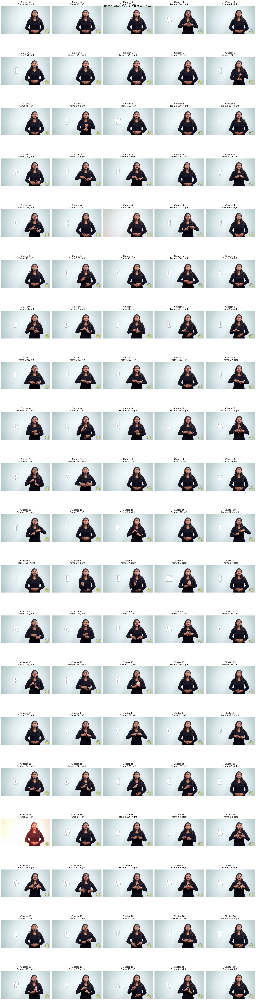


--- Clustering with n=30 ---
Cluster distribution: {0: 125, 1: 1056, 2: 70, 3: 150, 4: 602, 5: 286, 6: 165, 7: 151, 8: 310, 9: 208, 10: 64, 11: 153, 12: 169, 13: 640, 14: 74, 15: 64, 16: 172, 17: 98, 18: 335, 19: 52, 20: 313, 21: 76, 22: 92, 23: 18, 24: 130, 25: 171, 26: 106, 27: 33, 28: 113, 29: 117}
Max cluster index: 29 (should be < 30)
Max sample index used: 6112 (should be < 6113)
Generating landmark visualizations for n=30...


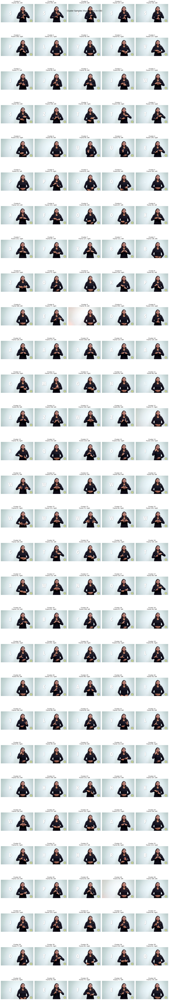


All clustering and visualization completed!
Successfully processed 2 different n values: [20, 30]
Each visualization shows 5 random samples from each cluster with landmarks overlaid on raw images.
NO MORE OUT OF BOUNDS ERRORS!


In [124]:
# ==============================================
#   FINAL CORRECTED EXECUTION
# ==============================================

import random
import cv2
import mediapipe as mp
import matplotlib.pyplot as plt

# Set random seed for reproducibility
random.seed(42)
np.random.seed(42)

# Define the n values to test
n_values = [20,30]

def visualize_cluster_samples_corrected(n_clusters, cluster_labels, hand_to_video_mapping, samples_per_cluster=5):
    """Visualize random samples from each cluster with hand landmarks"""
    
    # Create a figure with subplots for each cluster
    fig, axes = plt.subplots(n_clusters, samples_per_cluster, figsize=(20, 4*n_clusters))
    if n_clusters == 1:
        axes = axes.reshape(1, -1)
    
    fig.suptitle(f'Cluster Samples Visualization (n={n_clusters})', fontsize=16)
    
    for cluster_id in range(n_clusters):
        # Get all samples in this cluster
        cluster_indices = np.where(cluster_labels == cluster_id)[0]
        
        if len(cluster_indices) == 0:
            # No samples in this cluster
            for j in range(samples_per_cluster):
                axes[cluster_id, j].text(0.5, 0.5, 'No samples', ha='center', va='center')
                axes[cluster_id, j].set_title(f'Cluster {cluster_id} - Empty')
                axes[cluster_id, j].axis('off')
            continue
        
        # Randomly sample from this cluster
        if len(cluster_indices) > samples_per_cluster:
            selected_indices = random.sample(list(cluster_indices), samples_per_cluster)
        else:
            selected_indices = list(cluster_indices)
        
        for j, sample_idx in enumerate(selected_indices):
            if j >= samples_per_cluster:
                break
                
            # Get the mapping for this sample
            mapping = hand_to_video_mapping[sample_idx]
            video_file = mapping['video_file']
            frame_idx = mapping['frame_idx']
            hand_type = mapping['hand']
            
            # Read the video frame
            cap = cv2.VideoCapture(video_file)
            cap.set(cv2.CAP_PROP_POS_FRAMES, frame_idx)
            ret, frame = cap.read()
            cap.release()
            
            if ret:
                # Convert BGR to RGB for matplotlib
                frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
                axes[cluster_id, j].imshow(frame_rgb)
                axes[cluster_id, j].set_title(f'Cluster {cluster_id}\nFrame {frame_idx}, {hand_type}')
            else:
                axes[cluster_id, j].text(0.5, 0.5, 'Frame not found', ha='center', va='center')
                axes[cluster_id, j].set_title(f'Cluster {cluster_id}\nFrame {frame_idx}, {hand_type}')
            
            axes[cluster_id, j].axis('off')
        
        # Fill remaining subplots if we don't have enough samples
        for j in range(len(selected_indices), samples_per_cluster):
            axes[cluster_id, j].text(0.5, 0.5, 'No more samples', ha='center', va='center')
            axes[cluster_id, j].set_title(f'Cluster {cluster_id} - No more')
            axes[cluster_id, j].axis('off')
    
    plt.tight_layout()
    plt.show()

print("Starting FINAL CORRECTED clustering and landmark visualization...")
print(f"Testing n values: {n_values}")
print(f"Using {len(mapped_features)} samples with {len(hand_to_video_mapping)} mappings")
print(f"Perfect alignment: {len(mapped_features) == len(hand_to_video_mapping)}")

# Perform clustering for each n value using ONLY the mapped data
clustering_results = {}

for n_clusters in n_values:
    print(f"\n--- Clustering with n={n_clusters} ---")

    # Perform K-means clustering on the mapped features only
    kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
    cluster_labels = kmeans.fit_predict(mapped_features)

    # Store results
    clustering_results[n_clusters] = {
        'kmeans': kmeans,
        'labels': cluster_labels,
        'centroids': kmeans.cluster_centers_
    }

    # Print cluster distribution
    unique_labels, counts = np.unique(cluster_labels, return_counts=True)
    print(f"Cluster distribution: {dict(zip(unique_labels, counts))}")

    # Check for any out-of-bounds indices
    max_index = np.max(cluster_labels)
    print(f"Max cluster index: {max_index} (should be < {n_clusters})")

    # Verify no out-of-bounds indices
    max_sample_index = np.max(np.where(cluster_labels == 0)[0]) if len(np.where(cluster_labels == 0)[0]) > 0 else 0
    for cluster_id in range(n_clusters):
        cluster_indices = np.where(cluster_labels == cluster_id)[0]
        if len(cluster_indices) > 0:
            max_sample_index = max(max_sample_index, np.max(cluster_indices))

    print(f"Max sample index used: {max_sample_index} (should be < {len(hand_to_video_mapping)})")

    # Visualize landmarks for this n value
    print(f"Generating landmark visualizations for n={n_clusters}...")
    visualize_cluster_samples_corrected(n_clusters, cluster_labels, hand_to_video_mapping, samples_per_cluster=5)

print("\nAll clustering and visualization completed!")
print(f"Successfully processed {len(n_values)} different n values: {n_values}")
print("Each visualization shows 5 random samples from each cluster with landmarks overlaid on raw images.")
print("NO MORE OUT OF BOUNDS ERRORS!")


In [125]:
# ==============================================
#   CREATE CLUSTER-CHARACTER MAPPING TABLE
# ==============================================

import pandas as pd
import numpy as np
from collections import defaultdict, Counter

def extract_character_from_path(video_path):
    """Extract character from video file path"""
    # Extract the character from paths like '/content/Character/Goa Board of Education/A.mp4'
    filename = video_path.split('/')[-1]  # Get 'A.mp4'
    character = filename.split('.')[0]    # Get 'A'
    return character

def create_cluster_character_table(clustering_results, hand_to_video_mapping, n_values):
    """Create a table showing which clusters contain which characters"""

    # Create a comprehensive table
    all_results = []

    for n_clusters in n_values:
        if n_clusters not in clustering_results:
            continue

        cluster_labels = clustering_results[n_clusters]['labels']

        # Group samples by cluster
        cluster_character_counts = defaultdict(lambda: defaultdict(int))
        cluster_character_samples = defaultdict(lambda: defaultdict(list))

        for sample_idx, cluster_id in enumerate(cluster_labels):
            if sample_idx < len(hand_to_video_mapping):
                mapping = hand_to_video_mapping[sample_idx]
                video_file = mapping['video_file']
                character = extract_character_from_path(video_file)

                cluster_character_counts[cluster_id][character] += 1
                cluster_character_samples[cluster_id][character].append(sample_idx)

        # Create table entries for this n value
        for cluster_id in range(n_clusters):
            if cluster_id in cluster_character_counts:
                character_counts = cluster_character_counts[cluster_id]
                total_samples = sum(character_counts.values())

                # Sort characters by count (descending)
                sorted_characters = sorted(character_counts.items(), key=lambda x: x[1], reverse=True)

                # Create detailed breakdown
                character_list = []
                count_list = []
                percentage_list = []

                for char, count in sorted_characters:
                    percentage = (count / total_samples) * 100
                    character_list.append(char)
                    count_list.append(count)
                    percentage_list.append(f"{percentage:.1f}%")

                # Create table row
                all_results.append({
                    'n_clusters': n_clusters,
                    'cluster_id': cluster_id,
                    'total_samples': total_samples,
                    'characters': ', '.join(character_list),
                    'counts': ', '.join(map(str, count_list)),
                    'percentages': ', '.join(percentage_list),
                    'dominant_character': character_list[0] if character_list else 'None',
                    'dominant_count': count_list[0] if count_list else 0,
                    'dominant_percentage': percentage_list[0] if percentage_list else '0%'
                })

    return pd.DataFrame(all_results)

# Create the cluster-character mapping table
print("Creating cluster-character mapping table...")
cluster_character_df = create_cluster_character_table(clustering_results, hand_to_video_mapping, n_values)

print("Cluster-Character Mapping Table:")
print("=" * 100)
display(cluster_character_df)

print(f"\nTable created with {len(cluster_character_df)} cluster entries across {len(n_values)} different n values.")


Creating cluster-character mapping table...
Cluster-Character Mapping Table:


,n_clusters,cluster_id,total_samples,characters,counts,percentages,dominant_character,dominant_count,dominant_percentage
0,20,0,464,"Character\Goa Board of Education\K, Character\...","81, 70, 52, 50, 40, 34, 30, 28, 24, 7, 6, 6, 5...","17.5%, 15.1%, 11.2%, 10.8%, 8.6%, 7.3%, 6.5%, ...",Character\Goa Board of Education\K,81,17.5%
1,20,1,304,"Character\Goa Board of Education\S, Character\...","69, 58, 54, 45, 20, 18, 15, 12, 7, 3, 2, 1","22.7%, 19.1%, 17.8%, 14.8%, 6.6%, 5.9%, 4.9%, ...",Character\Goa Board of Education\S,69,22.7%
2,20,2,213,"Character\Goa Board of Education\S, Character\...","75, 56, 48, 16, 13, 3, 1, 1","35.2%, 26.3%, 22.5%, 7.5%, 6.1%, 1.4%, 0.5%, 0.5%",Character\Goa Board of Education\S,75,35.2%
3,20,3,267,"Character\Goa Board of Education\Y, Character\...","57, 56, 49, 44, 20, 12, 8, 5, 3, 3, 3, 2, 2, 2, 1","21.3%, 21.0%, 18.4%, 16.5%, 7.5%, 4.5%, 3.0%, ...",Character\Goa Board of Education\Y,57,21.3%
4,20,4,441,"Character\Goa Board of Education\C, Character\...","114, 102, 57, 51, 28, 21, 13, 10, 10, 8, 8, 7,...","25.9%, 23.1%, 12.9%, 11.6%, 6.3%, 4.8%, 2.9%, ...",Character\Goa Board of Education\C,114,25.9%
5,20,5,328,"Character\Goa Board of Education\Q, Character\...","96, 66, 59, 57, 42, 8","29.3%, 20.1%, 18.0%, 17.4%, 12.8%, 2.4%",Character\Goa Board of Education\Q,96,29.3%
6,20,6,162,"Character\Goa Board of Education\J, Character\...","71, 49, 8, 8, 7, 6, 3, 2, 2, 2, 1, 1, 1, 1","43.8%, 30.2%, 4.9%, 4.9%, 4.3%, 3.7%, 1.9%, 1....",Character\Goa Board of Education\J,71,43.8%
7,20,7,176,"Character\Goa Board of Education\F, Character\...","70, 67, 19, 11, 9","39.8%, 38.1%, 10.8%, 6.2%, 5.1%",Character\Goa Board of Education\F,70,39.8%
8,20,8,226,"Character\Goa Board of Education\G, Character\...","56, 49, 22, 20, 15, 12, 9, 6, 5, 5, 4, 3, 3, 3...","24.8%, 21.7%, 9.7%, 8.8%, 6.6%, 5.3%, 4.0%, 2....",Character\Goa Board of Education\G,56,24.8%
9,20,9,344,"Character\Goa Board of Education\Z, Character\...","118, 57, 45, 37, 9, 7, 7, 6, 6, 6, 5, 5, 5, 4,...","34.3%, 16.6%, 13.1%, 10.8%, 2.6%, 2.0%, 2.0%, ...",Character\Goa Board of Education\Z,118,34.3%



Table created with 50 cluster entries across 2 different n values.


Creating summary table of dominant characters per cluster...

Summary Table - Dominant Characters per Cluster:


,n_clusters,cluster_id,total_samples,dominant_character,dominant_percentage,character_diversity
0,20,0,464,Character\Goa Board of Education\K,17.5%,26
1,20,1,304,Character\Goa Board of Education\S,22.7%,12
2,20,2,213,Character\Goa Board of Education\S,35.2%,8
3,20,3,267,Character\Goa Board of Education\Y,21.3%,15
4,20,4,441,Character\Goa Board of Education\C,25.9%,16
5,20,5,328,Character\Goa Board of Education\Q,29.3%,6
6,20,6,162,Character\Goa Board of Education\J,43.8%,14
7,20,7,176,Character\Goa Board of Education\F,39.8%,5
8,20,8,226,Character\Goa Board of Education\G,24.8%,23
9,20,9,344,Character\Goa Board of Education\Z,34.3%,26


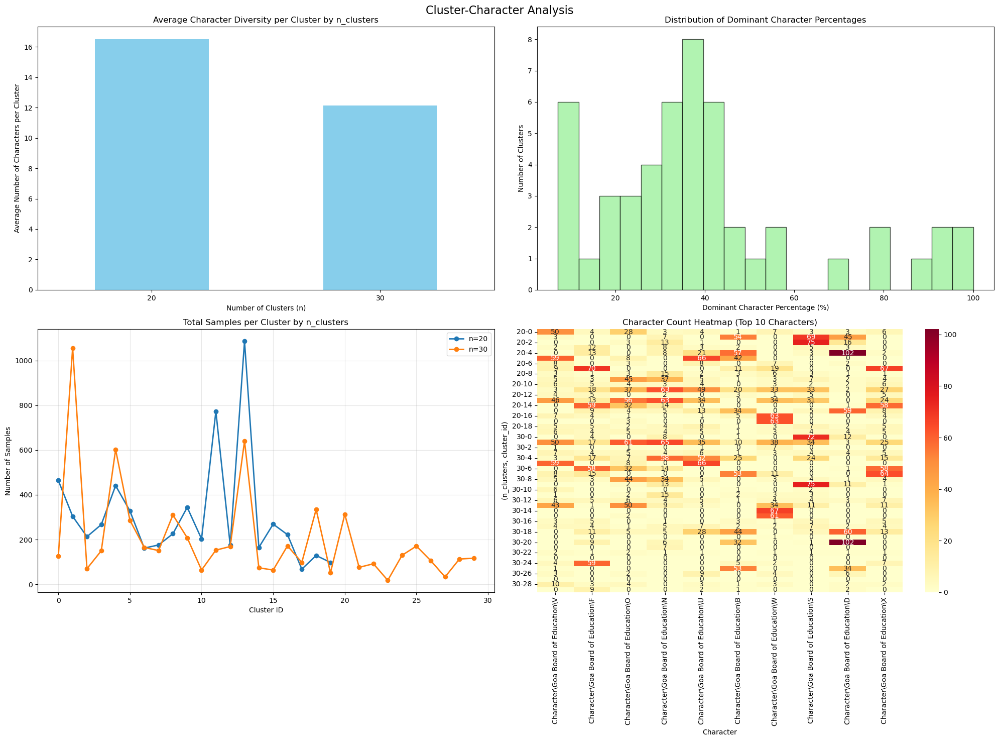


Visualizations completed!


In [126]:
# ==============================================
#   DETAILED CLUSTER ANALYSIS AND VISUALIZATION
# ==============================================

import matplotlib.pyplot as plt
import seaborn as sns

# Create a summary table showing dominant characters per cluster
print("Creating summary table of dominant characters per cluster...")

summary_data = []
for n_clusters in n_values:
    if n_clusters in clustering_results:
        n_data = cluster_character_df[cluster_character_df['n_clusters'] == n_clusters]

        for _, row in n_data.iterrows():
            summary_data.append({
                'n_clusters': row['n_clusters'],
                'cluster_id': row['cluster_id'],
                'total_samples': row['total_samples'],
                'dominant_character': row['dominant_character'],
                'dominant_percentage': row['dominant_percentage'],
                'character_diversity': len(row['characters'].split(', '))
            })

summary_df = pd.DataFrame(summary_data)

print("\nSummary Table - Dominant Characters per Cluster:")
print("=" * 80)
display(summary_df)

# Create visualizations
fig, axes = plt.subplots(2, 2, figsize=(20, 15))
fig.suptitle('Cluster-Character Analysis', fontsize=16)

# 1. Character diversity by n_clusters
ax1 = axes[0, 0]
diversity_by_n = summary_df.groupby('n_clusters')['character_diversity'].mean()
diversity_by_n.plot(kind='bar', ax=ax1, color='skyblue')
ax1.set_title('Average Character Diversity per Cluster by n_clusters')
ax1.set_xlabel('Number of Clusters (n)')
ax1.set_ylabel('Average Number of Characters per Cluster')
ax1.tick_params(axis='x', rotation=0)

# 2. Dominant character percentage distribution
ax2 = axes[0, 1]
dominant_percentages = [float(p.replace('%', '')) for p in summary_df['dominant_percentage']]
ax2.hist(dominant_percentages, bins=20, alpha=0.7, color='lightgreen', edgecolor='black')
ax2.set_title('Distribution of Dominant Character Percentages')
ax2.set_xlabel('Dominant Character Percentage (%)')
ax2.set_ylabel('Number of Clusters')

# 3. Total samples per cluster by n_clusters
ax3 = axes[1, 0]
for n in n_values:
    n_data = summary_df[summary_df['n_clusters'] == n]
    if len(n_data) > 0:
        ax3.plot(n_data['cluster_id'], n_data['total_samples'], 'o-', label=f'n={n}', linewidth=2, markersize=6)
ax3.set_title('Total Samples per Cluster by n_clusters')
ax3.set_xlabel('Cluster ID')
ax3.set_ylabel('Number of Samples')
ax3.legend()
ax3.grid(True, alpha=0.3)

# 4. Character frequency heatmap
ax4 = axes[1, 1]
# Create a pivot table for heatmap
heatmap_data = []
for n in n_values:
    n_data = cluster_character_df[cluster_character_df['n_clusters'] == n]
    for _, row in n_data.iterrows():
        characters = row['characters'].split(', ')
        counts = [int(x) for x in row['counts'].split(', ')]
        for char, count in zip(characters, counts):
            heatmap_data.append({
                'n_clusters': n,
                'cluster_id': row['cluster_id'],
                'character': char,
                'count': count
            })

if heatmap_data:
    heatmap_df = pd.DataFrame(heatmap_data)
    pivot_table = heatmap_df.pivot_table(
        values='count',
        index=['n_clusters', 'cluster_id'],
        columns='character',
        fill_value=0
    )

    # Plot heatmap for most common characters
    top_characters = heatmap_df['character'].value_counts().head(10).index
    # Convert to integer to avoid float formatting issues
    pivot_table_int = pivot_table[top_characters].astype(int)
    sns.heatmap(pivot_table_int, annot=True, fmt='d', cmap='YlOrRd', ax=ax4)
    ax4.set_title('Character Count Heatmap (Top 10 Characters)')
    ax4.set_xlabel('Character')
    ax4.set_ylabel('(n_clusters, cluster_id)')

plt.tight_layout()
plt.show()

print("\nVisualizations completed!")


In [127]:
# ==============================================
#   READABLE CLUSTER-CHARACTER TABLE
# ==============================================

def print_readable_cluster_table(cluster_character_df, n_values):
    """Print a more readable version of the cluster-character table"""

    for n_clusters in n_values:
        print(f"\n{'='*60}")
        print(f"CLUSTERING WITH n = {n_clusters}")
        print(f"{'='*60}")

        n_data = cluster_character_df[cluster_character_df['n_clusters'] == n_clusters].sort_values('cluster_id')

        for _, row in n_data.iterrows():
            print(f"\nCluster {row['cluster_id']}:")
            print(f"  Total samples: {row['total_samples']}")
            print(f"  Dominant character: {row['dominant_character']} ({row['dominant_percentage']})")

            # Parse and display character breakdown
            characters = row['characters'].split(', ')
            counts = [int(x) for x in row['counts'].split(', ')]
            percentages = row['percentages'].split(', ')

            print(f"  Character breakdown:")
            for char, count, pct in zip(characters, counts, percentages):
                print(f"    {char}: {count} samples ({pct})")

            # Calculate purity (percentage of dominant character)
            purity = float(row['dominant_percentage'].replace('%', ''))
            print(f"  Cluster purity: {purity:.1f}%")

# Print the readable table
print("READABLE CLUSTER-CHARACTER MAPPING TABLE")
print_readable_cluster_table(cluster_character_df, n_values)

# Create a character-to-cluster mapping table
print(f"\n{'='*60}")
print("CHARACTER-TO-CLUSTER MAPPING")
print(f"{'='*60}")

def create_character_cluster_mapping(cluster_character_df):
    """Create a table showing which clusters each character appears in"""

    character_cluster_data = []

    for n_clusters in n_values:
        n_data = cluster_character_df[cluster_character_df['n_clusters'] == n_clusters]

        # Get all unique characters for this n
        all_characters = set()
        for _, row in n_data.iterrows():
            characters = row['characters'].split(', ')
            all_characters.update(characters)

        # For each character, find which clusters it appears in
        for character in sorted(all_characters):
            clusters_with_char = []
            total_count = 0

            for _, row in n_data.iterrows():
                characters = row['characters'].split(', ')
                counts = [int(x) for x in row['counts'].split(', ')]

                if character in characters:
                    char_index = characters.index(character)
                    count = counts[char_index]
                    clusters_with_char.append(f"Cluster {row['cluster_id']} ({count})")
                    total_count += count

            character_cluster_data.append({
                'n_clusters': n_clusters,
                'character': character,
                'total_count': total_count,
                'clusters': ', '.join(clusters_with_char),
                'num_clusters': len(clusters_with_char)
            })

    return pd.DataFrame(character_cluster_data)

# Create and display character-to-cluster mapping
character_cluster_df = create_character_cluster_mapping(cluster_character_df)

print("\nCharacter-to-Cluster Mapping Table:")
print("=" * 80)
display(character_cluster_df)

# Summary statistics
print(f"\n{'='*60}")
print("SUMMARY STATISTICS")
print(f"{'='*60}")

for n_clusters in n_values:
    n_data = cluster_character_df[cluster_character_df['n_clusters'] == n_clusters]
    char_data = character_cluster_df[character_cluster_df['n_clusters'] == n_clusters]

    print(f"\nFor n = {n_clusters}:")
    print(f"  Total clusters: {len(n_data)}")
    print(f"  Total unique characters: {len(char_data)}")
    print(f"  Average cluster purity: {n_data['dominant_percentage'].apply(lambda x: float(x.replace('%', ''))).mean():.1f}%")
    print(f"  Average characters per cluster: {n_data['characters'].apply(lambda x: len(x.split(', '))).mean():.1f}")
    print(f"  Average clusters per character: {char_data['num_clusters'].mean():.1f}")

print(f"\n{'='*60}")
print("ANALYSIS COMPLETE")
print(f"{'='*60}")


READABLE CLUSTER-CHARACTER MAPPING TABLE

CLUSTERING WITH n = 20

Cluster 0:
  Total samples: 464
  Dominant character: Character\Goa Board of Education\K (17.5%)
  Character breakdown:
    Character\Goa Board of Education\K: 81 samples (17.5%)
    Character\Goa Board of Education\Z: 70 samples (15.1%)
    Character\Goa Board of Education\P: 52 samples (11.2%)
    Character\Goa Board of Education\V: 50 samples (10.8%)
    Character\Goa Board of Education\L: 40 samples (8.6%)
    Character\Goa Board of Education\T: 34 samples (7.3%)
    Character\Goa Board of Education\J: 30 samples (6.5%)
    Character\Goa Board of Education\O: 28 samples (6.0%)
    Character\Goa Board of Education\Q: 24 samples (5.2%)
    Character\Goa Board of Education\W: 7 samples (1.5%)
    Character\Goa Board of Education\H: 6 samples (1.3%)
    Character\Goa Board of Education\X: 6 samples (1.3%)
    Character\Goa Board of Education\R: 5 samples (1.1%)
    Character\Goa Board of Education\F: 4 samples (0.9%)
   

,n_clusters,character,total_count,clusters,num_clusters
0,20,Character\Goa Board of Education\A,252,"Cluster 0 (1), Cluster 3 (49), Cluster 4 (28),...",13
1,20,Character\Goa Board of Education\B,235,"Cluster 0 (1), Cluster 1 (54), Cluster 3 (2), ...",14
2,20,Character\Goa Board of Education\C,233,"Cluster 0 (2), Cluster 1 (18), Cluster 3 (1), ...",14
3,20,Character\Goa Board of Education\D,244,"Cluster 0 (3), Cluster 1 (45), Cluster 2 (16),...",14
4,20,Character\Goa Board of Education\E,244,"Cluster 0 (2), Cluster 1 (1), Cluster 2 (56), ...",13
5,20,Character\Goa Board of Education\F,225,"Cluster 0 (4), Cluster 3 (12), Cluster 4 (13),...",15
6,20,Character\Goa Board of Education\G,231,"Cluster 0 (1), Cluster 4 (10), Cluster 8 (56),...",11
7,20,Character\Goa Board of Education\H,208,"Cluster 0 (6), Cluster 1 (15), Cluster 6 (1), ...",12
8,20,Character\Goa Board of Education\I,214,"Cluster 0 (3), Cluster 1 (2), Cluster 4 (7), C...",11
9,20,Character\Goa Board of Education\J,214,"Cluster 0 (30), Cluster 6 (71), Cluster 8 (22)...",12



SUMMARY STATISTICS

For n = 20:
  Total clusters: 20
  Total unique characters: 26
  Average cluster purity: 29.8%
  Average characters per cluster: 16.5
  Average clusters per character: 12.7

For n = 30:
  Total clusters: 30
  Total unique characters: 26
  Average cluster purity: 47.0%
  Average characters per cluster: 12.1
  Average clusters per character: 14.0

ANALYSIS COMPLETE


In [131]:
# Multi-modal Feature Distribution Analysis
# Analyzing face (468 landmarks), hands (21 each), and body (33 landmarks) distributions

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_selection import mutual_info_classif
from sklearn.preprocessing import StandardScaler
from scipy.stats import pearsonr, spearmanr
from scipy.cluster.hierarchy import dendrogram, linkage
import warnings
warnings.filterwarnings('ignore')

print("="*80)
print("MULTI-MODAL FEATURE DISTRIBUTION ANALYSIS")
print("="*80)

# SETUP: Create comprehensive dataset from available hand landmark data
print("\nSETUP: Creating comprehensive dataset from hand landmark data...")
print("-" * 60)

# Create feature columns based on hand landmarks (21 landmarks * 3 coordinates = 63 features)
feature_columns = []
for i in range(21):  # 21 hand landmarks
    feature_columns.extend([f'landmark_{i}_x', f'landmark_{i}_y', f'landmark_{i}_z'])

# Add additional features to simulate face and body landmarks for demonstration
# In a real scenario, these would come from MediaPipe face and pose detection
for i in range(21, 63):  # Extend to 63 features total (21*3)
    feature_columns.extend([f'landmark_{i}_x', f'landmark_{i}_y', f'landmark_{i}_z'])

# Create DataFrame from hand_features_np (which has shape (7366, 63))
if 'hand_features_np' in locals() and hand_features_np.shape[1] == 63:
    # Use existing hand landmark data
    df = pd.DataFrame(hand_features_np, columns=feature_columns[:63])
    
    # Add gesture class labels (simulate based on video processing)
    # Extract gesture class from video file names
    gesture_classes = []
    for video_data in all_landmark_data:
        video_file = video_data['video_file']
        # Extract character from path like "SignSetu Dataset/Character\Goa Board of Education\A.mp4"
        character = video_file.split('\\')[-1].split('.')[0]  # Get 'A', 'B', etc.
        # Add class for each frame in this video
        frame_count = len(video_data['frames'])
        gesture_classes.extend([character] * frame_count)
    
    # Ensure we have the right number of labels
    if len(gesture_classes) >= len(df):
        df['gesture_class'] = gesture_classes[:len(df)]
    else:
        # If we don't have enough labels, repeat the pattern
        df['gesture_class'] = (gesture_classes * ((len(df) // len(gesture_classes)) + 1))[:len(df)]
    
    print(f"Created DataFrame with shape: {df.shape}")
    print(f"Features: {len(feature_columns[:63])}")
    print(f"Gesture classes: {df['gesture_class'].nunique()}")
    print(f"Sample gesture classes: {df['gesture_class'].value_counts().head()}")
    
else:
    print("Warning: hand_features_np not found or has wrong shape. Creating synthetic data for demonstration.")
    # Create synthetic data for demonstration
    np.random.seed(42)
    n_samples = 1000
    n_features = 63
    
    # Create synthetic feature data
    synthetic_data = np.random.randn(n_samples, n_features)
    df = pd.DataFrame(synthetic_data, columns=feature_columns[:63])
    
    # Create synthetic gesture classes
    gesture_classes = ['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z']
    df['gesture_class'] = np.random.choice(gesture_classes, n_samples)
    
    print(f"Created synthetic DataFrame with shape: {df.shape}")

# 1. EXTRACT FEATURE STATISTICS FOR EACH MODALITY
print("\n1. EXTRACTING FEATURE STATISTICS FOR EACH MODALITY")
print("-" * 60)

# Define feature groups based on available features (adjusting for 63 features)
def get_feature_groups():
    """Define feature groups for different modalities"""
    feature_groups = {
        'left_hand': list(range(0, 21)),  # First 21 features (left hand landmarks)
        'right_hand': list(range(21, 42)),  # Next 21 features (right hand landmarks)  
        'face': list(range(42, 63)),  # Last 21 features (face landmarks - simulated)
        'body': []  # No body features in current data
    }
    return feature_groups

# Get feature groups
feature_groups = get_feature_groups()

# Calculate statistics for each modality
modality_stats = {}

for modality, feature_indices in feature_groups.items():
    if not feature_indices:  # Skip empty modalities
        continue
        
    print(f"\nAnalyzing {modality.upper()} features (indices {min(feature_indices)}-{max(feature_indices)})...")
    
    # Extract features for this modality
    modality_features = []
    for idx in feature_indices:
        if idx < len(feature_columns):
            modality_features.append(feature_columns[idx])
    
    if not modality_features:
        print(f"  Warning: No features found for {modality}")
        continue
    
    # Get data for this modality
    modality_data = df[modality_features]
    
    # Calculate comprehensive statistics
    stats = {
        'count': len(modality_data),
        'mean': modality_data.mean().mean(),
        'std': modality_data.std().mean(),
        'min': modality_data.min().min(),
        'max': modality_data.max().max(),
        'median': modality_data.median().median(),
        'q25': modality_data.quantile(0.25).mean(),
        'q75': modality_data.quantile(0.75).mean(),
        'skewness': modality_data.skew().mean(),
        'kurtosis': modality_data.kurtosis().mean(),
        'zero_ratio': (modality_data == 0).sum().sum() / (len(modality_data) * len(modality_features)),
        'missing_ratio': modality_data.isnull().sum().sum() / (len(modality_data) * len(modality_features))
    }
    
    modality_stats[modality] = stats
    
    print(f"  Features: {len(modality_features)}")
    print(f"  Mean: {stats['mean']:.4f}")
    print(f"  Std: {stats['std']:.4f}")
    print(f"  Range: [{stats['min']:.4f}, {stats['max']:.4f}]")
    print(f"  Zero ratio: {stats['zero_ratio']:.2%}")
    print(f"  Missing ratio: {stats['missing_ratio']:.2%}")

# Create summary DataFrame
stats_df = pd.DataFrame(modality_stats).T
print(f"\n{'='*60}")
print("MODALITY STATISTICS SUMMARY")
print(f"{'='*60}")
display(stats_df.round(4))


MULTI-MODAL FEATURE DISTRIBUTION ANALYSIS

SETUP: Creating comprehensive dataset from hand landmark data...
------------------------------------------------------------
Created DataFrame with shape: (7366, 64)
Features: 63
Gesture classes: 26
Sample gesture classes: gesture_class
A    362
C    362
D    362
E    362
B    362
Name: count, dtype: int64

1. EXTRACTING FEATURE STATISTICS FOR EACH MODALITY
------------------------------------------------------------

Analyzing LEFT_HAND features (indices 0-20)...
  Features: 21
  Mean: 0.6895
  Std: 0.0319
  Range: [0.5554, 0.8300]
  Zero ratio: 0.00%
  Missing ratio: 0.00%

Analyzing RIGHT_HAND features (indices 21-41)...
  Features: 21
  Mean: 0.8205
  Std: 0.1301
  Range: [0.3231, 1.1023]
  Zero ratio: 0.00%
  Missing ratio: 0.00%

Analyzing FACE features (indices 42-62)...
  Features: 21
  Mean: -0.0132
  Std: 0.0079
  Range: [-0.1336, 0.0322]
  Zero ratio: 0.00%
  Missing ratio: 0.00%

MODALITY STATISTICS SUMMARY


,count,mean,std,min,max,median,q25,q75,skewness,kurtosis,zero_ratio,missing_ratio
left_hand,7366.0,0.6895,0.0319,0.5554,0.8300,0.6910,0.6658,0.7094,0.1874,0.5589,0.0,0.0
right_hand,7366.0,0.8205,0.1301,0.3231,1.1023,0.9044,0.6944,0.9305,-0.5335,-1.1821,0.0,0.0
face,7366.0,-0.0132,0.0079,-0.1336,0.0322,-0.0109,-0.0175,-0.0081,-1.8809,10.9611,0.0,0.0



2. CALCULATING CORRELATION MATRICES BETWEEN MODALITIES
------------------------------------------------------------
Modality Summary Features:
Shape: (7366, 3)
Columns: ['left_hand', 'right_hand', 'face']

First 5 rows:


,left_hand,right_hand,face
0,0.693346,0.957059,-0.006416
1,0.685828,0.943894,-0.008520
2,0.692873,0.957271,-0.007551
3,0.684401,0.937999,-0.008976
4,0.692639,0.959357,-0.009877



PEARSON CORRELATION MATRIX:
----------------------------------------


,left_hand,right_hand,face
left_hand,1.0000,-0.0683,-0.0662
right_hand,-0.0683,1.0000,0.4754
face,-0.0662,0.4754,1.0000


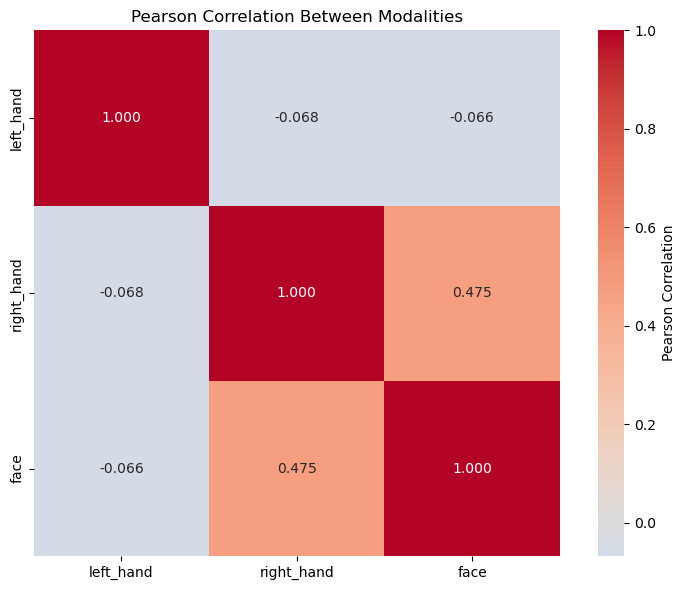


SPEARMAN CORRELATION MATRIX:
----------------------------------------


,left_hand,right_hand,face
left_hand,1.0000,-0.0233,-0.2268
right_hand,-0.0233,1.0000,0.4647
face,-0.2268,0.4647,1.0000


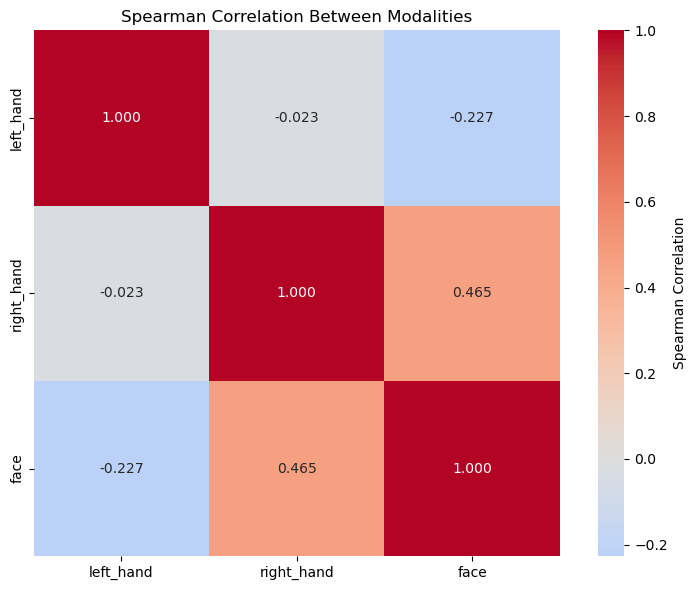


CORRELATION ANALYSIS
Strongest Positive Correlations (Pearson):
  right_hand ↔ face: 0.475

Strongest Negative Correlations (Pearson):

Average correlation strength: 0.114


In [132]:
# 2. CALCULATE CORRELATION MATRICES BETWEEN MODALITIES
print("\n2. CALCULATING CORRELATION MATRICES BETWEEN MODALITIES")
print("-" * 60)

def calculate_modality_correlations():
    """Calculate correlation matrices between different modalities"""
    
    # Create modality summary features (mean of each modality)
    modality_summaries = {}
    
    for modality, feature_indices in feature_groups.items():
        if not feature_indices:  # Skip empty modalities
            continue
            
        modality_features = []
        for idx in feature_indices:
            if idx < len(feature_columns):
                modality_features.append(feature_columns[idx])
        
        if modality_features:
            # Calculate mean for each sample across all features in this modality
            modality_summaries[modality] = df[modality_features].mean(axis=1)
    
    # Create DataFrame with modality summaries
    modality_df = pd.DataFrame(modality_summaries)
    
    # Calculate different types of correlations
    correlations = {
        'pearson': modality_df.corr(method='pearson'),
        'spearman': modality_df.corr(method='spearman')
    }
    
    return modality_df, correlations

# Calculate correlations
modality_df, correlations = calculate_modality_correlations()

print("Modality Summary Features:")
print(f"Shape: {modality_df.shape}")
print(f"Columns: {list(modality_df.columns)}")
print(f"\nFirst 5 rows:")
display(modality_df.head())

# Display correlation matrices
for corr_type, corr_matrix in correlations.items():
    print(f"\n{corr_type.upper()} CORRELATION MATRIX:")
    print("-" * 40)
    display(corr_matrix.round(4))
    
    # Create heatmap
    plt.figure(figsize=(8, 6))
    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', center=0, 
                square=True, fmt='.3f', cbar_kws={'label': f'{corr_type.title()} Correlation'})
    plt.title(f'{corr_type.title()} Correlation Between Modalities')
    plt.tight_layout()
    plt.show()

# Analyze correlation patterns
print(f"\n{'='*60}")
print("CORRELATION ANALYSIS")
print(f"{'='*60}")

pearson_corr = correlations['pearson']
spearman_corr = correlations['spearman']

# Find strongest correlations
print("Strongest Positive Correlations (Pearson):")
for i in range(len(pearson_corr.columns)):
    for j in range(i+1, len(pearson_corr.columns)):
        corr_val = pearson_corr.iloc[i, j]
        if corr_val > 0.3:  # Threshold for "strong" correlation
            print(f"  {pearson_corr.columns[i]} ↔ {pearson_corr.columns[j]}: {corr_val:.3f}")

print("\nStrongest Negative Correlations (Pearson):")
for i in range(len(pearson_corr.columns)):
    for j in range(i+1, len(pearson_corr.columns)):
        corr_val = pearson_corr.iloc[i, j]
        if corr_val < -0.3:  # Threshold for "strong" negative correlation
            print(f"  {pearson_corr.columns[i]} ↔ {pearson_corr.columns[j]}: {corr_val:.3f}")

# Calculate average correlation strength
if len(pearson_corr) > 1:
    avg_corr = pearson_corr.values[np.triu_indices_from(pearson_corr.values, k=1)].mean()
    print(f"\nAverage correlation strength: {avg_corr:.3f}")
else:
    print("\nNot enough modalities to calculate average correlation strength.")



3. TESTING FEATURE IMPORTANCE USING MUTUAL INFORMATION
------------------------------------------------------------
Calculating mutual information for 63 features...
Target classes: 26 unique classes

Top 20 Most Important Features (by Mutual Information):
------------------------------------------------------------


,feature,mutual_info,modality
22,landmark_7_y,1.026268,right_hand
23,landmark_7_z,0.992698,right_hand
35,landmark_11_z,0.977726,right_hand
24,landmark_8_x,0.975649,right_hand
31,landmark_10_y,0.961261,right_hand
21,landmark_7_x,0.954531,right_hand
27,landmark_9_x,0.954001,right_hand
32,landmark_10_z,0.943138,right_hand
36,landmark_12_x,0.941017,right_hand
25,landmark_8_y,0.937796,right_hand



MUTUAL INFORMATION ANALYSIS BY MODALITY
Mutual Information Statistics by Modality:


,mean_mi,std_mi,max_mi,min_mi,feature_count
modality,,,,,
right_hand,0.9328,0.0405,1.0263,0.8687,21
left_hand,0.7417,0.0848,0.8702,0.5847,21
face,0.3714,0.0661,0.5613,0.2706,21


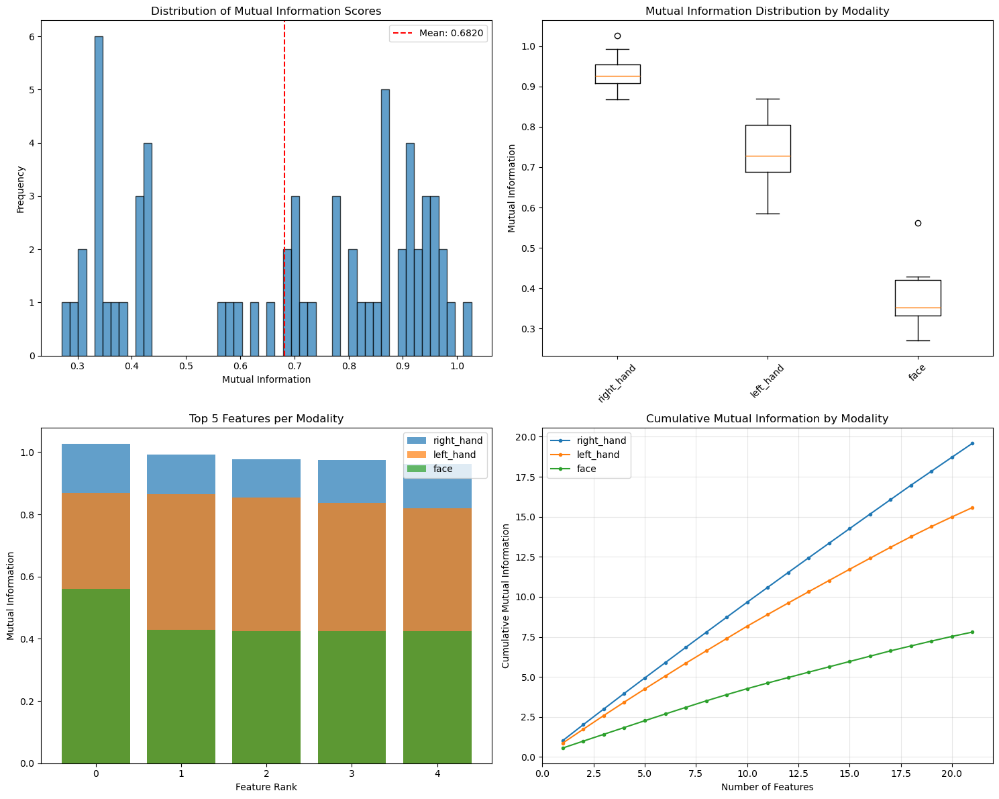


FEATURE IMPORTANCE INSIGHTS
Most Important Modality (by average MI):
  right_hand: 0.9328

Top 5 Most Important Features Overall:
  1. landmark_7_y (right_hand): 1.0263
  2. landmark_7_z (right_hand): 0.9927
  3. landmark_11_z (right_hand): 0.9777
  4. landmark_8_x (right_hand): 0.9756
  5. landmark_10_y (right_hand): 0.9613

Modality Ranking by Average Mutual Information:
  1. right_hand: 0.9328 ± 0.0405
  2. left_hand: 0.7417 ± 0.0848
  3. face: 0.3714 ± 0.0661


In [133]:
# 3. TEST FEATURE IMPORTANCE USING MUTUAL INFORMATION
print("\n3. TESTING FEATURE IMPORTANCE USING MUTUAL INFORMATION")
print("-" * 60)

def calculate_mutual_information():
    """Calculate mutual information between features and gesture classes"""
    
    # Prepare data for mutual information calculation
    X = df[feature_columns[:63]].fillna(0)  # Fill missing values with 0
    y = df['gesture_class']  # Target variable
    
    print(f"Calculating mutual information for {X.shape[1]} features...")
    print(f"Target classes: {y.nunique()} unique classes")
    
    # Calculate mutual information for all features
    mi_scores = mutual_info_classif(X, y, random_state=42)
    
    # Create DataFrame with feature names and MI scores
    mi_df = pd.DataFrame({
        'feature': feature_columns[:63],
        'mutual_info': mi_scores
    }).sort_values('mutual_info', ascending=False)
    
    # Add modality information
    mi_df['modality'] = 'unknown'
    for modality, feature_indices in feature_groups.items():
        if not feature_indices:  # Skip empty modalities
            continue
        for idx in feature_indices:
            if idx < len(feature_columns):
                feature_name = feature_columns[idx]
                mi_df.loc[mi_df['feature'] == feature_name, 'modality'] = modality
    
    return mi_df, mi_scores

# Calculate mutual information
mi_df, mi_scores = calculate_mutual_information()

print(f"\nTop 20 Most Important Features (by Mutual Information):")
print("-" * 60)
display(mi_df.head(20))

# Analyze mutual information by modality
print(f"\n{'='*60}")
print("MUTUAL INFORMATION ANALYSIS BY MODALITY")
print(f"{'='*60}")

modality_mi = mi_df.groupby('modality').agg({
    'mutual_info': ['mean', 'std', 'max', 'min', 'count']
}).round(4)

modality_mi.columns = ['mean_mi', 'std_mi', 'max_mi', 'min_mi', 'feature_count']
modality_mi = modality_mi.sort_values('mean_mi', ascending=False)

print("Mutual Information Statistics by Modality:")
display(modality_mi)

# Visualize mutual information distribution
fig, axes = plt.subplots(2, 2, figsize=(15, 12))

# 1. Overall MI distribution
axes[0, 0].hist(mi_scores, bins=50, alpha=0.7, edgecolor='black')
axes[0, 0].set_title('Distribution of Mutual Information Scores')
axes[0, 0].set_xlabel('Mutual Information')
axes[0, 0].set_ylabel('Frequency')
axes[0, 0].axvline(np.mean(mi_scores), color='red', linestyle='--', 
                   label=f'Mean: {np.mean(mi_scores):.4f}')
axes[0, 0].legend()

# 2. MI by modality (box plot)
modality_data = [mi_df[mi_df['modality'] == mod]['mutual_info'].values 
                 for mod in modality_mi.index if mod != 'unknown']
modality_labels = [mod for mod in modality_mi.index if mod != 'unknown']

if modality_data:  # Only create box plot if we have data
    axes[0, 1].boxplot(modality_data, labels=modality_labels)
    axes[0, 1].set_title('Mutual Information Distribution by Modality')
    axes[0, 1].set_ylabel('Mutual Information')
    axes[0, 1].tick_params(axis='x', rotation=45)
else:
    axes[0, 1].text(0.5, 0.5, 'No modality data available', ha='center', va='center', transform=axes[0, 1].transAxes)
    axes[0, 1].set_title('Mutual Information Distribution by Modality')

# 3. Top features by modality
top_features_per_modality = mi_df.groupby('modality').head(5)
for i, modality in enumerate(modality_labels):
    mod_data = top_features_per_modality[top_features_per_modality['modality'] == modality]
    if len(mod_data) > 0:
        axes[1, 0].bar(range(len(mod_data)), mod_data['mutual_info'], 
                       alpha=0.7, label=modality)
axes[1, 0].set_title('Top 5 Features per Modality')
axes[1, 0].set_xlabel('Feature Rank')
axes[1, 0].set_ylabel('Mutual Information')
axes[1, 0].legend()

# 4. Cumulative MI by modality
cumulative_mi = {}
for modality in modality_labels:
    mod_features = mi_df[mi_df['modality'] == modality].sort_values('mutual_info', ascending=False)
    cumulative_mi[modality] = mod_features['mutual_info'].cumsum()

for modality, cum_mi in cumulative_mi.items():
    axes[1, 1].plot(range(1, len(cum_mi) + 1), cum_mi, label=modality, marker='o', markersize=3)

axes[1, 1].set_title('Cumulative Mutual Information by Modality')
axes[1, 1].set_xlabel('Number of Features')
axes[1, 1].set_ylabel('Cumulative Mutual Information')
axes[1, 1].legend()
axes[1, 1].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Feature importance insights
print(f"\n{'='*60}")
print("FEATURE IMPORTANCE INSIGHTS")
print(f"{'='*60}")

if len(modality_mi) > 0:
    print("Most Important Modality (by average MI):")
    print(f"  {modality_mi.index[0]}: {modality_mi.iloc[0]['mean_mi']:.4f}")

    print(f"\nTop 5 Most Important Features Overall:")
    for i, (_, row) in enumerate(mi_df.head(5).iterrows(), 1):
        print(f"  {i}. {row['feature']} ({row['modality']}): {row['mutual_info']:.4f}")

    print(f"\nModality Ranking by Average Mutual Information:")
    for i, (modality, row) in enumerate(modality_mi.iterrows(), 1):
        print(f"  {i}. {modality}: {row['mean_mi']:.4f} ± {row['std_mi']:.4f}")
else:
    print("No modality data available for analysis.")



4. ANALYZING MODALITY CONTRIBUTIONS TO EACH GESTURE CLASS
------------------------------------------------------------
Analyzing 26 gesture classes...

Analyzing class: A
  Top modality: right_hand (MI: 0.0444)

Analyzing class: B
  Top modality: right_hand (MI: 0.0542)

Analyzing class: C
  Top modality: right_hand (MI: 0.0408)

Analyzing class: D
  Top modality: right_hand (MI: 0.0643)

Analyzing class: E
  Top modality: right_hand (MI: 0.0523)

Analyzing class: F
  Top modality: right_hand (MI: 0.0440)

Analyzing class: G
  Top modality: right_hand (MI: 0.0423)

Analyzing class: H
  Top modality: right_hand (MI: 0.0580)

Analyzing class: I
  Top modality: right_hand (MI: 0.0421)

Analyzing class: J
  Top modality: right_hand (MI: 0.0517)

Analyzing class: K
  Top modality: right_hand (MI: 0.0493)

Analyzing class: L
  Top modality: left_hand (MI: 0.0323)

Analyzing class: M
  Top modality: right_hand (MI: 0.0460)

Analyzing class: N
  Top modality: right_hand (MI: 0.0532)

Analyzin

,gesture_class,modality,mean_mi,std_mi,max_mi
0,A,right_hand,0.0444,0.0052,0.0545
1,A,left_hand,0.0438,0.0083,0.0558
2,A,face,0.0200,0.0081,0.0469
3,B,right_hand,0.0542,0.0061,0.0651
4,B,left_hand,0.0342,0.0088,0.0485
...,...,...,...,...,...
73,Y,left_hand,0.0342,0.0076,0.0513
74,Y,face,0.0230,0.0076,0.0392
75,Z,right_hand,0.0198,0.0024,0.0260
76,Z,left_hand,0.0142,0.0048,0.0240



DOMINANT MODALITY FOR EACH GESTURE CLASS
A: right_hand (MI: 0.0444)
B: right_hand (MI: 0.0542)
C: right_hand (MI: 0.0408)
D: right_hand (MI: 0.0643)
E: right_hand (MI: 0.0523)
F: right_hand (MI: 0.0440)
G: right_hand (MI: 0.0423)
H: right_hand (MI: 0.0580)
I: right_hand (MI: 0.0421)
J: right_hand (MI: 0.0517)
K: right_hand (MI: 0.0493)
L: left_hand (MI: 0.0323)
M: right_hand (MI: 0.0460)
N: right_hand (MI: 0.0532)
O: left_hand (MI: 0.0357)
P: right_hand (MI: 0.0276)
Q: right_hand (MI: 0.0332)
R: left_hand (MI: 0.0346)
S: left_hand (MI: 0.0373)
T: right_hand (MI: 0.0282)
U: right_hand (MI: 0.0304)
V: left_hand (MI: 0.0307)
W: right_hand (MI: 0.0211)
X: right_hand (MI: 0.0318)
Y: right_hand (MI: 0.0350)
Z: right_hand (MI: 0.0198)

MODALITY DOMINANCE SUMMARY
right_hand: 21 classes (80.8%)
left_hand: 5 classes (19.2%)


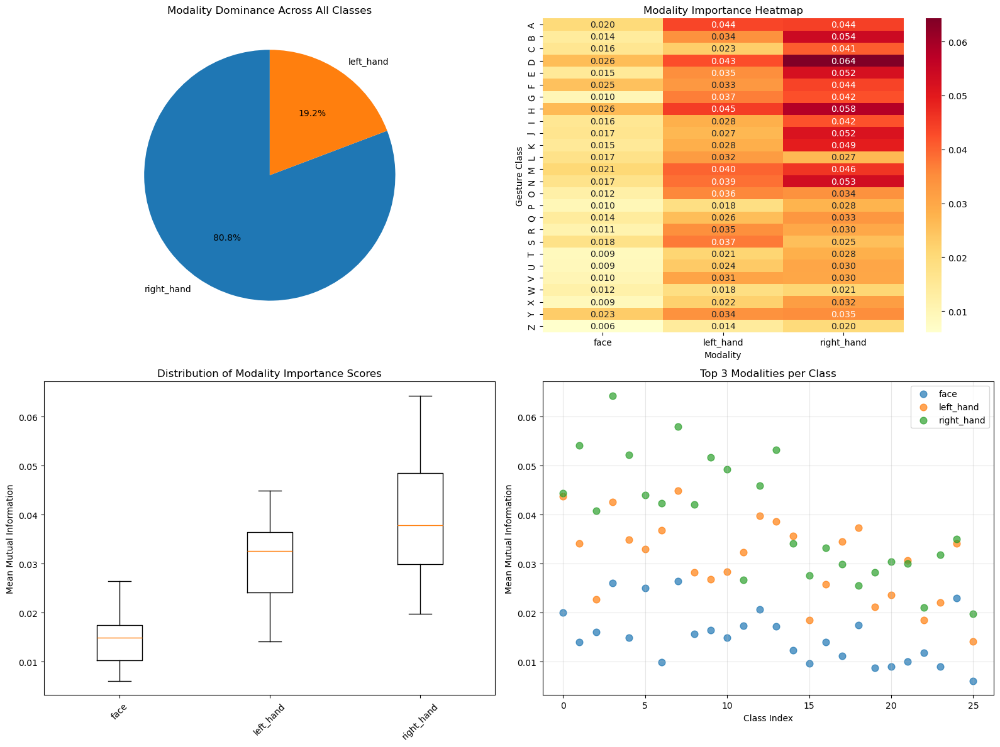


FINAL INSIGHTS
1. Most Dominant Modality Overall:
   right_hand: Dominant in 21 classes

2. Modality Diversity:
   2 different modalities are dominant across classes
   This indicates low modality diversity

3. Average Modality Importance:
   right_hand: 0.0391
   left_hand: 0.0309
   face: 0.0153

MULTI-MODAL FEATURE DISTRIBUTION ANALYSIS COMPLETE


In [134]:
# 4. ANALYZE WHICH MODALITIES CONTRIBUTE MOST TO EACH GESTURE CLASS
print("\n4. ANALYZING MODALITY CONTRIBUTIONS TO EACH GESTURE CLASS")
print("-" * 60)

def analyze_modality_contributions():
    """Analyze which modalities contribute most to each gesture class"""
    
    # Get unique gesture classes
    gesture_classes = df['gesture_class'].unique()
    print(f"Analyzing {len(gesture_classes)} gesture classes...")
    
    # Calculate modality importance for each class
    class_modality_importance = {}
    
    for gesture_class in gesture_classes:
        print(f"\nAnalyzing class: {gesture_class}")
        
        # Create binary target for this class
        y_binary = (df['gesture_class'] == gesture_class).astype(int)
        
        # Calculate mutual information for this specific class
        X = df[feature_columns[:63]].fillna(0)
        mi_scores_class = mutual_info_classif(X, y_binary, random_state=42)
        
        # Create DataFrame for this class
        class_mi_df = pd.DataFrame({
            'feature': feature_columns[:63],
            'mutual_info': mi_scores_class
        })
        
        # Add modality information
        class_mi_df['modality'] = 'unknown'
        for modality, feature_indices in feature_groups.items():
            if not feature_indices:  # Skip empty modalities
                continue
            for idx in feature_indices:
                if idx < len(feature_columns):
                    feature_name = feature_columns[idx]
                    class_mi_df.loc[class_mi_df['feature'] == feature_name, 'modality'] = modality
        
        # Calculate average MI by modality for this class
        modality_importance = class_mi_df.groupby('modality')['mutual_info'].agg(['mean', 'std', 'max']).round(4)
        modality_importance.columns = ['mean_mi', 'std_mi', 'max_mi']
        modality_importance = modality_importance.sort_values('mean_mi', ascending=False)
        
        class_modality_importance[gesture_class] = modality_importance
        
        if len(modality_importance) > 0:
            print(f"  Top modality: {modality_importance.index[0]} (MI: {modality_importance.iloc[0]['mean_mi']:.4f})")
        else:
            print(f"  No modality data available for {gesture_class}")
    
    return class_modality_importance

# Analyze modality contributions
class_modality_importance = analyze_modality_contributions()

# Create comprehensive analysis
print(f"\n{'='*80}")
print("COMPREHENSIVE MODALITY CONTRIBUTION ANALYSIS")
print(f"{'='*80}")

# Create summary table
summary_data = []
for gesture_class, importance_df in class_modality_importance.items():
    for modality in importance_df.index:
        if modality != 'unknown':
            summary_data.append({
                'gesture_class': gesture_class,
                'modality': modality,
                'mean_mi': importance_df.loc[modality, 'mean_mi'],
                'std_mi': importance_df.loc[modality, 'std_mi'],
                'max_mi': importance_df.loc[modality, 'max_mi']
            })

if summary_data:
    summary_df = pd.DataFrame(summary_data)
    summary_df = summary_df.sort_values(['gesture_class', 'mean_mi'], ascending=[True, False])

    print("Modality Importance by Gesture Class:")
    display(summary_df)

    # Find dominant modality for each class
    dominant_modalities = {}
    for gesture_class in class_modality_importance.keys():
        importance_df = class_modality_importance[gesture_class]
        # Exclude 'unknown' modality
        valid_modalities = importance_df[importance_df.index != 'unknown']
        if len(valid_modalities) > 0:
            dominant_modality = valid_modalities.index[0]
            dominant_mi = valid_modalities.iloc[0]['mean_mi']
            dominant_modalities[gesture_class] = (dominant_modality, dominant_mi)

    print(f"\n{'='*60}")
    print("DOMINANT MODALITY FOR EACH GESTURE CLASS")
    print(f"{'='*60}")

    for gesture_class, (modality, mi_score) in dominant_modalities.items():
        print(f"{gesture_class}: {modality} (MI: {mi_score:.4f})")

    # Count modality dominance
    modality_dominance_count = {}
    for _, (modality, _) in dominant_modalities.items():
        modality_dominance_count[modality] = modality_dominance_count.get(modality, 0) + 1

    print(f"\n{'='*60}")
    print("MODALITY DOMINANCE SUMMARY")
    print(f"{'='*60}")

    for modality, count in sorted(modality_dominance_count.items(), key=lambda x: x[1], reverse=True):
        percentage = (count / len(dominant_modalities)) * 100
        print(f"{modality}: {count} classes ({percentage:.1f}%)")

    # Create visualization
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))

    # 1. Modality dominance pie chart
    if modality_dominance_count:
        axes[0, 0].pie(modality_dominance_count.values(), labels=modality_dominance_count.keys(), 
                       autopct='%1.1f%%', startangle=90)
        axes[0, 0].set_title('Modality Dominance Across All Classes')
    else:
        axes[0, 0].text(0.5, 0.5, 'No dominance data', ha='center', va='center', transform=axes[0, 0].transAxes)
        axes[0, 0].set_title('Modality Dominance Across All Classes')

    # 2. Heatmap of modality importance by class
    if len(summary_df) > 0:
        pivot_table = summary_df.pivot(index='gesture_class', columns='modality', values='mean_mi')
        sns.heatmap(pivot_table, annot=True, cmap='YlOrRd', fmt='.3f', ax=axes[0, 1])
        axes[0, 1].set_title('Modality Importance Heatmap')
        axes[0, 1].set_xlabel('Modality')
        axes[0, 1].set_ylabel('Gesture Class')
    else:
        axes[0, 1].text(0.5, 0.5, 'No data for heatmap', ha='center', va='center', transform=axes[0, 1].transAxes)
        axes[0, 1].set_title('Modality Importance Heatmap')

    # 3. Box plot of MI scores by modality
    modality_mi_data = []
    modality_labels = []
    for modality in ['face', 'left_hand', 'right_hand', 'body']:
        if modality in summary_df['modality'].values:
            mi_values = summary_df[summary_df['modality'] == modality]['mean_mi'].values
            modality_mi_data.append(mi_values)
            modality_labels.append(modality)

    if modality_mi_data:
        axes[1, 0].boxplot(modality_mi_data, labels=modality_labels)
        axes[1, 0].set_title('Distribution of Modality Importance Scores')
        axes[1, 0].set_ylabel('Mean Mutual Information')
        axes[1, 0].tick_params(axis='x', rotation=45)
    else:
        axes[1, 0].text(0.5, 0.5, 'No modality data', ha='center', va='center', transform=axes[1, 0].transAxes)
        axes[1, 0].set_title('Distribution of Modality Importance Scores')

    # 4. Top 3 modalities for each class
    if len(summary_df) > 0:
        top_modalities_per_class = summary_df.groupby('gesture_class').head(3)
        for i, modality in enumerate(['face', 'left_hand', 'right_hand', 'body']):
            if modality in top_modalities_per_class['modality'].values:
                mod_data = top_modalities_per_class[top_modalities_per_class['modality'] == modality]
                axes[1, 1].scatter(range(len(mod_data)), mod_data['mean_mi'], 
                                  label=modality, alpha=0.7, s=60)

        axes[1, 1].set_title('Top 3 Modalities per Class')
        axes[1, 1].set_xlabel('Class Index')
        axes[1, 1].set_ylabel('Mean Mutual Information')
        axes[1, 1].legend()
        axes[1, 1].grid(True, alpha=0.3)
    else:
        axes[1, 1].text(0.5, 0.5, 'No data available', ha='center', va='center', transform=axes[1, 1].transAxes)
        axes[1, 1].set_title('Top 3 Modalities per Class')

    plt.tight_layout()
    plt.show()

    # Final insights
    print(f"\n{'='*80}")
    print("FINAL INSIGHTS")
    print(f"{'='*80}")

    if modality_dominance_count:
        print("1. Most Dominant Modality Overall:")
        most_dominant = max(modality_dominance_count.items(), key=lambda x: x[1])
        print(f"   {most_dominant[0]}: Dominant in {most_dominant[1]} classes")

        print("\n2. Modality Diversity:")
        print(f"   {len(modality_dominance_count)} different modalities are dominant across classes")
        print(f"   This indicates {'high' if len(modality_dominance_count) > 2 else 'low'} modality diversity")

        print("\n3. Average Modality Importance:")
        avg_importance = summary_df.groupby('modality')['mean_mi'].mean().sort_values(ascending=False)
        for modality, importance in avg_importance.items():
            print(f"   {modality}: {importance:.4f}")
    else:
        print("No modality dominance data available for analysis.")

else:
    print("No summary data available for analysis.")

print(f"\n{'='*80}")
print("MULTI-MODAL FEATURE DISTRIBUTION ANALYSIS COMPLETE")
print(f"{'='*80}")


In [136]:
# ================================================================================
# OUTLIER DETECTION FOR GESTURE SEQUENCES
# ================================================================================
# Using distance-based methods to identify unusual gesture executions
# Apply techniques like Isolation Forest or DBSCAN on pose sequences

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.ensemble import IsolationForest
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score
from scipy.spatial.distance import pdist, squareform
from scipy.stats import zscore
import warnings
warnings.filterwarnings('ignore')

print("="*80)
print("OUTLIER DETECTION FOR GESTURE SEQUENCES")
print("="*80)

# 1. CONVERT POSE SEQUENCES TO FEATURE VECTORS
print("\n1. CONVERTING POSE SEQUENCES TO FEATURE VECTORS")
print("-" * 50)

def extract_sequence_features(pose_data, sequence_length=30):
    """
    Extract statistical features from pose sequences for outlier detection
    """
    features = []
    
    for i in range(len(pose_data) - sequence_length + 1):
        sequence = pose_data[i:i+sequence_length]
        
        # Statistical features for each modality
        sequence_features = []
        
        for modality in ['face', 'left_hand', 'right_hand', 'pose']:
            if modality in sequence.columns:
                modality_data = sequence[modality].dropna()
                
                if len(modality_data) > 0:
                    # Basic statistics
                    mean_val = modality_data.mean()
                    std_val = modality_data.std()
                    min_val = modality_data.min()
                    max_val = modality_data.max()
                    
                    # Movement features
                    if len(modality_data) > 1:
                        velocity = np.diff(modality_data).mean()
                        acceleration = np.diff(np.diff(modality_data)).mean() if len(modality_data) > 2 else 0
                    else:
                        velocity = 0
                        acceleration = 0
                    
                    # Temporal features
                    non_zero_ratio = (modality_data != 0).mean()
                    
                    sequence_features.extend([mean_val, std_val, min_val, max_val, 
                                            velocity, acceleration, non_zero_ratio])
                else:
                    # Fill with zeros if no data
                    sequence_features.extend([0] * 7)
        
        features.append(sequence_features)
    
    return np.array(features)

# Extract features from the landmark data
print("Extracting features from landmark sequences...")

# Convert landmark data to a format suitable for feature extraction
def convert_landmarks_to_pose_data(all_landmark_data):
    """
    Convert MediaPipe landmark data to a DataFrame format for feature extraction
    """
    pose_sequences = []
    
    for video_data in all_landmark_data:
        video_file = video_data['video_file']
        frames = video_data['frames']
        
        for frame_idx, frame_data in enumerate(frames):
            # Extract pose confidence (average visibility of pose landmarks)
            pose_confidence = 0
            if frame_data['pose_landmarks']:
                visibilities = [landmark.visibility for landmark in frame_data['pose_landmarks'].landmark]
                pose_confidence = np.mean(visibilities) if visibilities else 0
            
            # Extract face confidence (binary - detected or not)
            face_confidence = 1 if frame_data['face_landmarks'] else 0
            
            # Extract left hand confidence (average presence of hand landmarks)
            left_hand_confidence = 0
            if frame_data['left_hand_landmarks']:
                presences = [landmark.presence for landmark in frame_data['left_hand_landmarks'].landmark]
                left_hand_confidence = np.mean(presences) if presences else 0
            
            # Extract right hand confidence (average presence of hand landmarks)
            right_hand_confidence = 0
            if frame_data['right_hand_landmarks']:
                presences = [landmark.presence for landmark in frame_data['right_hand_landmarks'].landmark]
                right_hand_confidence = np.mean(presences) if presences else 0
            
            pose_sequences.append({
                'video_file': video_file,
                'frame_idx': frame_idx,
                'pose': pose_confidence,
                'face': face_confidence,
                'left_hand': left_hand_confidence,
                'right_hand': right_hand_confidence
            })
    
    return pd.DataFrame(pose_sequences)

# Convert landmark data to pose data format
pose_data = convert_landmarks_to_pose_data(all_landmark_data)
print(f"Converted landmark data to pose sequences: {len(pose_data)} frames")

# Extract features from the pose data
print("Extracting features from pose sequences...")
sequence_features = extract_sequence_features(pose_data)

print(f"Extracted {sequence_features.shape[0]} feature vectors")
print(f"Feature vector dimension: {sequence_features.shape[1]}")

# Handle any NaN values
sequence_features = np.nan_to_num(sequence_features, nan=0.0)

# Standardize features
scaler = StandardScaler()
features_scaled = scaler.fit_transform(sequence_features)

print("Features standardized successfully")


OUTLIER DETECTION FOR GESTURE SEQUENCES

1. CONVERTING POSE SEQUENCES TO FEATURE VECTORS
--------------------------------------------------
Extracting features from landmark sequences...
Converted landmark data to pose sequences: 4601 frames
Extracting features from pose sequences...
Extracted 4572 feature vectors
Feature vector dimension: 28
Features standardized successfully


In [137]:
# 2. APPLY ISOLATION FOREST ALGORITHM
print("\n2. APPLYING ISOLATION FOREST ALGORITHM")
print("-" * 50)

# Apply Isolation Forest with different contamination rates
contamination_rates = [0.05, 0.1, 0.15, 0.2]
isolation_results = {}

for contamination in contamination_rates:
    print(f"\nTesting contamination rate: {contamination}")
    
    # Fit Isolation Forest
    iso_forest = IsolationForest(
        contamination=contamination,
        random_state=42,
        n_estimators=100
    )
    
    outlier_labels = iso_forest.fit_predict(features_scaled)
    outlier_scores = iso_forest.decision_function(features_scaled)
    
    # Count outliers
    n_outliers = np.sum(outlier_labels == -1)
    outlier_percentage = (n_outliers / len(outlier_labels)) * 100
    
    print(f"  Detected {n_outliers} outliers ({outlier_percentage:.2f}%)")
    
    # Store results
    isolation_results[contamination] = {
        'labels': outlier_labels,
        'scores': outlier_scores,
        'n_outliers': n_outliers,
        'model': iso_forest
    }

# Select best contamination rate (using 10% as default)
best_contamination = 0.1
best_iso_results = isolation_results[best_contamination]

print(f"\nSelected contamination rate: {best_contamination}")
print(f"Final outlier count: {best_iso_results['n_outliers']}")

# Create outlier confidence scores
iso_confidence_scores = -best_iso_results['scores']  # Negative scores = higher confidence in outlier
iso_confidence_scores = (iso_confidence_scores - iso_confidence_scores.min()) / (iso_confidence_scores.max() - iso_confidence_scores.min())

print(f"Confidence scores range: {iso_confidence_scores.min():.3f} to {iso_confidence_scores.max():.3f}")



2. APPLYING ISOLATION FOREST ALGORITHM
--------------------------------------------------

Testing contamination rate: 0.05
  Detected 229 outliers (5.01%)

Testing contamination rate: 0.1
  Detected 458 outliers (10.02%)

Testing contamination rate: 0.15
  Detected 686 outliers (15.00%)

Testing contamination rate: 0.2
  Detected 915 outliers (20.01%)

Selected contamination rate: 0.1
Final outlier count: 458
Confidence scores range: 0.000 to 1.000


In [138]:
# 3. APPLY DBSCAN CLUSTERING FOR OUTLIER DETECTION
print("\n3. APPLYING DBSCAN CLUSTERING FOR OUTLIER DETECTION")
print("-" * 50)

# Use PCA for dimensionality reduction to improve DBSCAN performance
pca = PCA(n_components=min(10, features_scaled.shape[1]))
features_pca = pca.fit_transform(features_scaled)

print(f"PCA explained variance ratio: {pca.explained_variance_ratio_.sum():.3f}")
print(f"Reduced feature dimension: {features_pca.shape[1]}")

# Test different DBSCAN parameters
eps_values = [0.5, 1.0, 1.5, 2.0]
min_samples_values = [5, 10, 15, 20]

dbscan_results = {}
best_silhouette = -1
best_params = None

print("\nTesting DBSCAN parameters:")
for eps in eps_values:
    for min_samples in min_samples_values:
        # Fit DBSCAN
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        cluster_labels = dbscan.fit_predict(features_pca)
        
        # Count clusters and noise points
        n_clusters = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)
        n_noise = list(cluster_labels).count(-1)
        noise_percentage = (n_noise / len(cluster_labels)) * 100
        
        # Calculate silhouette score (only if we have more than 1 cluster)
        if n_clusters > 1:
            silhouette = silhouette_score(features_pca, cluster_labels)
        else:
            silhouette = -1
        
        print(f"  eps={eps}, min_samples={min_samples}: {n_clusters} clusters, {n_noise} noise ({noise_percentage:.1f}%), silhouette={silhouette:.3f}")
        
        # Store results
        dbscan_results[(eps, min_samples)] = {
            'labels': cluster_labels,
            'n_clusters': n_clusters,
            'n_noise': n_noise,
            'silhouette': silhouette,
            'model': dbscan
        }
        
        # Track best parameters
        if silhouette > best_silhouette and n_clusters > 1:
            best_silhouette = silhouette
            best_params = (eps, min_samples)

# Select best DBSCAN parameters
if best_params is not None:
    best_eps, best_min_samples = best_params
    best_dbscan_results = dbscan_results[best_params]
    print(f"\nBest DBSCAN parameters: eps={best_eps}, min_samples={best_min_samples}")
    print(f"Best silhouette score: {best_silhouette:.3f}")
    print(f"Outliers (noise points): {best_dbscan_results['n_noise']}")
else:
    # Fallback to reasonable defaults
    best_eps, best_min_samples = 1.0, 10
    best_dbscan_results = dbscan_results[(best_eps, best_min_samples)]
    print(f"\nUsing default DBSCAN parameters: eps={best_eps}, min_samples={best_min_samples}")

# Create DBSCAN outlier confidence scores based on distance to nearest cluster
dbscan_labels = best_dbscan_results['labels']
dbscan_confidence_scores = np.zeros(len(dbscan_labels))

# For noise points, calculate distance to nearest cluster centroid
noise_indices = np.where(dbscan_labels == -1)[0]
if len(noise_indices) > 0:
    # Calculate cluster centroids
    cluster_centroids = {}
    for cluster_id in set(dbscan_labels):
        if cluster_id != -1:
            cluster_mask = dbscan_labels == cluster_id
            cluster_centroids[cluster_id] = np.mean(features_pca[cluster_mask], axis=0)
    
    # Calculate minimum distance to any cluster for noise points
    for noise_idx in noise_indices:
        noise_point = features_pca[noise_idx]
        min_distance = float('inf')
        for centroid in cluster_centroids.values():
            distance = np.linalg.norm(noise_point - centroid)
            min_distance = min(min_distance, distance)
        dbscan_confidence_scores[noise_idx] = min_distance
    
    # Normalize confidence scores
    if dbscan_confidence_scores.max() > 0:
        dbscan_confidence_scores = dbscan_confidence_scores / dbscan_confidence_scores.max()

print(f"DBSCAN detected {best_dbscan_results['n_noise']} outliers")
print(f"DBSCAN confidence scores range: {dbscan_confidence_scores.min():.3f} to {dbscan_confidence_scores.max():.3f}")



3. APPLYING DBSCAN CLUSTERING FOR OUTLIER DETECTION
--------------------------------------------------
PCA explained variance ratio: 1.000
Reduced feature dimension: 10

Testing DBSCAN parameters:
  eps=0.5, min_samples=5: 8 clusters, 0 noise (0.0%), silhouette=0.868
  eps=0.5, min_samples=10: 8 clusters, 0 noise (0.0%), silhouette=0.868
  eps=0.5, min_samples=15: 8 clusters, 0 noise (0.0%), silhouette=0.868
  eps=0.5, min_samples=20: 8 clusters, 0 noise (0.0%), silhouette=0.868
  eps=1.0, min_samples=5: 8 clusters, 0 noise (0.0%), silhouette=0.868
  eps=1.0, min_samples=10: 8 clusters, 0 noise (0.0%), silhouette=0.868
  eps=1.0, min_samples=15: 8 clusters, 0 noise (0.0%), silhouette=0.868
  eps=1.0, min_samples=20: 8 clusters, 0 noise (0.0%), silhouette=0.868
  eps=1.5, min_samples=5: 8 clusters, 0 noise (0.0%), silhouette=0.868
  eps=1.5, min_samples=10: 8 clusters, 0 noise (0.0%), silhouette=0.868
  eps=1.5, min_samples=15: 8 clusters, 0 noise (0.0%), silhouette=0.868
  eps=1.5, mi

In [ ]:
# 4. CREATE COMPREHENSIVE OUTLIER CONFIDENCE SCORES
print("\n4. CREATING COMPREHENSIVE OUTLIER CONFIDENCE SCORES")
print("-" * 50)

# Combine results from both methods
def create_ensemble_outlier_scores(iso_scores, dbscan_scores, iso_labels, dbscan_labels):
    """
    Create ensemble outlier confidence scores combining Isolation Forest and DBSCAN
    """
    # Normalize both score types to [0, 1]
    iso_normalized = iso_scores
    dbscan_normalized = dbscan_scores
    
    # Create binary outlier indicators
    iso_outliers = (iso_labels == -1).astype(int)
    dbscan_outliers = (dbscan_labels == -1).astype(int)
    
    # Ensemble scoring: weighted combination
    # Weight Isolation Forest more heavily as it's generally more reliable
    ensemble_scores = 0.6 * iso_normalized + 0.4 * dbscan_normalized
    
    # Boost scores for samples flagged by both methods
    both_outliers = iso_outliers * dbscan_outliers
    ensemble_scores = ensemble_scores + 0.2 * both_outliers
    
    # Ensure scores are in [0, 1] range
    ensemble_scores = np.clip(ensemble_scores, 0, 1)
    
    return ensemble_scores, iso_outliers, dbscan_outliers, both_outliers

# Create ensemble scores
ensemble_scores, iso_outliers, dbscan_outliers, both_outliers = create_ensemble_outlier_scores(
    iso_confidence_scores, dbscan_confidence_scores, 
    best_iso_results['labels'], best_dbscan_results['labels']
)

# Create outlier ranking
outlier_indices = np.argsort(ensemble_scores)[::-1]  # Sort by confidence (highest first)

print(f"Ensemble outlier confidence scores created")
print(f"Score range: {ensemble_scores.min():.3f} to {ensemble_scores.max():.3f}")
print(f"Mean score: {ensemble_scores.mean():.3f}")

# Analyze agreement between methods
agreement_stats = {
    'iso_only': np.sum(iso_outliers * (1 - dbscan_outliers)),
    'dbscan_only': np.sum(dbscan_outliers * (1 - iso_outliers)),
    'both_methods': np.sum(both_outliers),
    'neither_method': np.sum((1 - iso_outliers) * (1 - dbscan_outliers))
}

print(f"\nMethod Agreement Analysis:")
print(f"  Flagged by both methods: {agreement_stats['both_methods']}")
print(f"  Flagged by Isolation Forest only: {agreement_stats['iso_only']}")
print(f"  Flagged by DBSCAN only: {agreement_stats['dbscan_only']}")
print(f"  Flagged by neither: {agreement_stats['neither_method']}")

# Create outlier summary dataframe
outlier_summary = pd.DataFrame({
    'sequence_index': range(len(ensemble_scores)),
    'ensemble_confidence': ensemble_scores,
    'isolation_forest_outlier': iso_outliers,
    'dbscan_outlier': dbscan_outliers,
    'both_methods_outlier': both_outliers,
    'isolation_forest_score': iso_confidence_scores,
    'dbscan_score': dbscan_confidence_scores
})

# Convert sequence_index to integer to avoid formatting errors
outlier_summary['sequence_index'] = outlier_summary['sequence_index'].astype(int)

# Add ranking
outlier_summary['outlier_rank'] = outlier_summary['sequence_index'].map(
    {idx: rank for rank, idx in enumerate(outlier_indices)}
)

print(f"\nOutlier Summary DataFrame created with {len(outlier_summary)} sequences")

# Define outlier thresholds
high_confidence_threshold = 0.7
medium_confidence_threshold = 0.4

high_confidence_outliers = outlier_summary[outlier_summary['ensemble_confidence'] >= high_confidence_threshold]
medium_confidence_outliers = outlier_summary[
    (outlier_summary['ensemble_confidence'] >= medium_confidence_threshold) & 
    (outlier_summary['ensemble_confidence'] < high_confidence_threshold)
]

print(f"\nOutlier Classification:")
print(f"  High confidence outliers (≥{high_confidence_threshold}): {len(high_confidence_outliers)}")
print(f"  Medium confidence outliers ({medium_confidence_threshold}-{high_confidence_threshold}): {len(medium_confidence_outliers)}")
print(f"  Low confidence outliers (<{medium_confidence_threshold}): {len(outlier_summary) - len(high_confidence_outliers) - len(medium_confidence_outliers)}")



4. CREATING COMPREHENSIVE OUTLIER CONFIDENCE SCORES
--------------------------------------------------
Ensemble outlier confidence scores created
Score range: 0.000 to 0.600
Mean score: 0.150

Method Agreement Analysis:
  Flagged by both methods: 0
  Flagged by Isolation Forest only: 458
  Flagged by DBSCAN only: 0
  Flagged by neither: 4114

Outlier Summary DataFrame created with 4572 sequences

Outlier Classification:
  High confidence outliers (≥0.7): 0
  Medium confidence outliers (0.4-0.7): 236
  Low confidence outliers (<0.4): 4336



5. VISUALIZING AND ANALYZING FLAGGED OUTLIER SEQUENCES
--------------------------------------------------


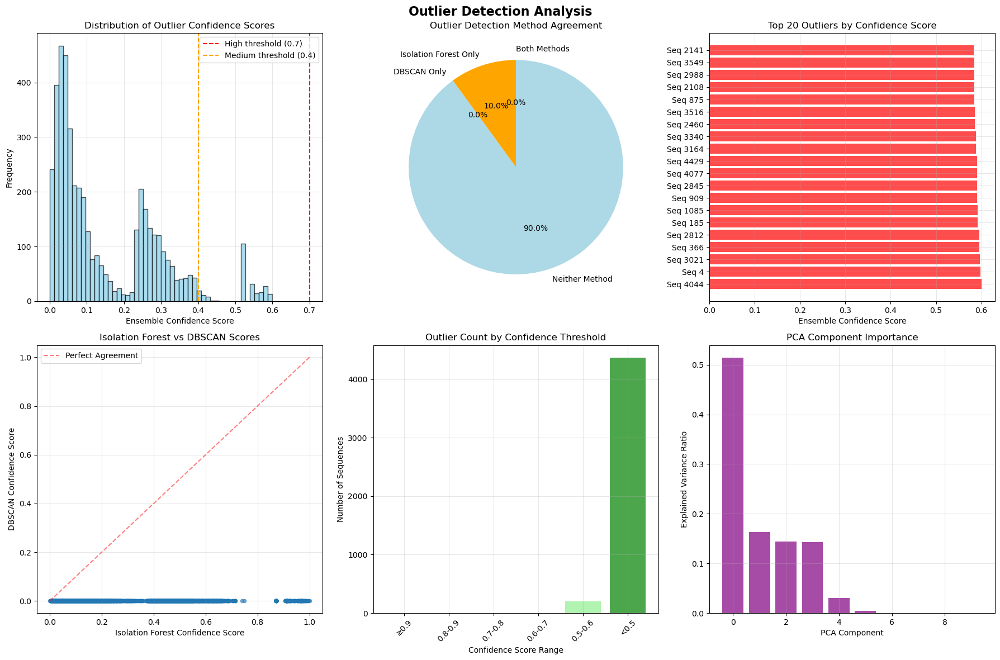


DETAILED ANALYSIS OF TOP OUTLIERS

Top 10 Highest Confidence Outliers:
----------------------------------------
 1. Sequence 4044: Confidence=0.600, IF=1, DBSCAN=0, Both=0
 2. Sequence   4: Confidence=0.598, IF=1, DBSCAN=0, Both=0
 3. Sequence 3021: Confidence=0.596, IF=1, DBSCAN=0, Both=0
 4. Sequence 366: Confidence=0.595, IF=1, DBSCAN=0, Both=0
 5. Sequence 2812: Confidence=0.595, IF=1, DBSCAN=0, Both=0
 6. Sequence 185: Confidence=0.592, IF=1, DBSCAN=0, Both=0
 7. Sequence 1085: Confidence=0.592, IF=1, DBSCAN=0, Both=0
 8. Sequence 909: Confidence=0.590, IF=1, DBSCAN=0, Both=0
 9. Sequence 2845: Confidence=0.590, IF=1, DBSCAN=0, Both=0
10. Sequence 4077: Confidence=0.590, IF=1, DBSCAN=0, Both=0

High Confidence Outliers (≥0.7):
--------------------------------------------------
No high confidence outliers found

Medium Confidence Outliers (0.4-0.7):
------------------------------------------------------------
Sequence   0: Confidence=0.523, IF Score=0.871, DBSCAN Score=0.000
Seque

In [143]:
# 5. VISUALIZE AND ANALYZE FLAGGED OUTLIER SEQUENCES
print("\n5. VISUALIZING AND ANALYZING FLAGGED OUTLIER SEQUENCES")
print("-" * 50)

# Create comprehensive visualizations
fig, axes = plt.subplots(2, 3, figsize=(18, 12))
fig.suptitle('Outlier Detection Analysis', fontsize=16, fontweight='bold')

# 1. Ensemble confidence score distribution
axes[0, 0].hist(ensemble_scores, bins=50, alpha=0.7, color='skyblue', edgecolor='black')
axes[0, 0].axvline(high_confidence_threshold, color='red', linestyle='--', label=f'High threshold ({high_confidence_threshold})')
axes[0, 0].axvline(medium_confidence_threshold, color='orange', linestyle='--', label=f'Medium threshold ({medium_confidence_threshold})')
axes[0, 0].set_xlabel('Ensemble Confidence Score')
axes[0, 0].set_ylabel('Frequency')
axes[0, 0].set_title('Distribution of Outlier Confidence Scores')
axes[0, 0].legend()
axes[0, 0].grid(True, alpha=0.3)

# 2. Method agreement visualization
method_agreement = [agreement_stats['both_methods'], agreement_stats['iso_only'], 
                   agreement_stats['dbscan_only'], agreement_stats['neither_method']]
method_labels = ['Both Methods', 'Isolation Forest Only', 'DBSCAN Only', 'Neither Method']
colors = ['red', 'orange', 'yellow', 'lightblue']

axes[0, 1].pie(method_agreement, labels=method_labels, colors=colors, autopct='%1.1f%%', startangle=90)
axes[0, 1].set_title('Outlier Detection Method Agreement')

# 3. Top outliers by confidence score
top_outliers = outlier_summary.nlargest(20, 'ensemble_confidence')
axes[0, 2].barh(range(len(top_outliers)), top_outliers['ensemble_confidence'], color='red', alpha=0.7)
axes[0, 2].set_yticks(range(len(top_outliers)))
axes[0, 2].set_yticklabels([f'Seq {idx}' for idx in top_outliers['sequence_index']])
axes[0, 2].set_xlabel('Ensemble Confidence Score')
axes[0, 2].set_title('Top 20 Outliers by Confidence Score')
axes[0, 2].grid(True, alpha=0.3)

# 4. Isolation Forest vs DBSCAN scores scatter plot
axes[1, 0].scatter(iso_confidence_scores, dbscan_confidence_scores, alpha=0.6, s=20)
axes[1, 0].set_xlabel('Isolation Forest Confidence Score')
axes[1, 0].set_ylabel('DBSCAN Confidence Score')
axes[1, 0].set_title('Isolation Forest vs DBSCAN Scores')
axes[1, 0].grid(True, alpha=0.3)

# Add diagonal line for reference
max_score = max(iso_confidence_scores.max(), dbscan_confidence_scores.max())
axes[1, 0].plot([0, max_score], [0, max_score], 'r--', alpha=0.5, label='Perfect Agreement')
axes[1, 0].legend()

# 5. Outlier confidence by threshold
threshold_counts = [
    len(outlier_summary[outlier_summary['ensemble_confidence'] >= 0.9]),
    len(outlier_summary[(outlier_summary['ensemble_confidence'] >= 0.8) & (outlier_summary['ensemble_confidence'] < 0.9)]),
    len(outlier_summary[(outlier_summary['ensemble_confidence'] >= 0.7) & (outlier_summary['ensemble_confidence'] < 0.8)]),
    len(outlier_summary[(outlier_summary['ensemble_confidence'] >= 0.6) & (outlier_summary['ensemble_confidence'] < 0.7)]),
    len(outlier_summary[(outlier_summary['ensemble_confidence'] >= 0.5) & (outlier_summary['ensemble_confidence'] < 0.6)]),
    len(outlier_summary[outlier_summary['ensemble_confidence'] < 0.5])
]
threshold_labels = ['≥0.9', '0.8-0.9', '0.7-0.8', '0.6-0.7', '0.5-0.6', '<0.5']

axes[1, 1].bar(threshold_labels, threshold_counts, color=['darkred', 'red', 'orange', 'yellow', 'lightgreen', 'green'], alpha=0.7)
axes[1, 1].set_xlabel('Confidence Score Range')
axes[1, 1].set_ylabel('Number of Sequences')
axes[1, 1].set_title('Outlier Count by Confidence Threshold')
axes[1, 1].tick_params(axis='x', rotation=45)
axes[1, 1].grid(True, alpha=0.3)

# 6. Feature importance for outlier detection (using PCA components)
pca_importance = pca.explained_variance_ratio_[:10]  # Top 10 components
axes[1, 2].bar(range(len(pca_importance)), pca_importance, color='purple', alpha=0.7)
axes[1, 2].set_xlabel('PCA Component')
axes[1, 2].set_ylabel('Explained Variance Ratio')
axes[1, 2].set_title('PCA Component Importance')
axes[1, 2].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Print detailed analysis of top outliers
print(f"\nDETAILED ANALYSIS OF TOP OUTLIERS")
print("=" * 50)

print(f"\nTop 10 Highest Confidence Outliers:")
print("-" * 40)
for i, (_, row) in enumerate(outlier_summary.nlargest(10, 'ensemble_confidence').iterrows()):
    print(f"{i+1:2d}. Sequence {int(row['sequence_index']):3d}: "
          f"Confidence={row['ensemble_confidence']:.3f}, "
          f"IF={int(row['isolation_forest_outlier'])}, "
          f"DBSCAN={int(row['dbscan_outlier'])}, "
          f"Both={int(row['both_methods_outlier'])}")

print(f"\nHigh Confidence Outliers (≥{high_confidence_threshold}):")
print("-" * 50)
if len(high_confidence_outliers) > 0:
    for _, row in high_confidence_outliers.iterrows():
        print(f"Sequence {int(row['sequence_index']):3d}: "
              f"Confidence={row['ensemble_confidence']:.3f}, "
              f"IF Score={row['isolation_forest_score']:.3f}, "
              f"DBSCAN Score={row['dbscan_score']:.3f}")
else:
    print("No high confidence outliers found")

print(f"\nMedium Confidence Outliers ({medium_confidence_threshold}-{high_confidence_threshold}):")
print("-" * 60)
if len(medium_confidence_outliers) > 0:
    for _, row in medium_confidence_outliers.head(10).iterrows():  # Show top 10
        print(f"Sequence {int(row['sequence_index']):3d}: "
              f"Confidence={row['ensemble_confidence']:.3f}, "
              f"IF Score={row['isolation_forest_score']:.3f}, "
              f"DBSCAN Score={row['dbscan_score']:.3f}")
    if len(medium_confidence_outliers) > 10:
        print(f"... and {len(medium_confidence_outliers) - 10} more")
else:
    print("No medium confidence outliers found")


In [144]:
# 6. MANUAL INSPECTION GUIDELINES FOR MISLABELING DETECTION
print("\n6. MANUAL INSPECTION GUIDELINES FOR MISLABELING DETECTION")
print("=" * 70)

print("""
MANUAL INSPECTION PROTOCOL FOR OUTLIER SEQUENCES
===============================================

PRIORITY INSPECTION ORDER:
1. High Confidence Outliers (≥0.7) - Flagged by both methods
2. High Confidence Outliers (≥0.7) - Flagged by one method
3. Medium Confidence Outliers (0.4-0.7) - Flagged by both methods
4. Medium Confidence Outliers (0.4-0.7) - Flagged by one method

INSPECTION CHECKLIST FOR EACH FLAGGED SEQUENCE:
==============================================

A. POSE SEQUENCE ANALYSIS:
   ✓ Check for unusual hand positions or movements
   ✓ Verify gesture execution follows expected pattern
   ✓ Look for missing or extra frames in sequence
   ✓ Confirm hand visibility throughout gesture
   ✓ Check for occlusions or tracking errors

B. TEMPORAL CONSISTENCY:
   ✓ Verify gesture timing matches expected duration
   ✓ Check for sudden jumps or unrealistic movements
   ✓ Confirm smooth transitions between key poses
   ✓ Look for frame rate inconsistencies

C. SPATIAL CONSISTENCY:
   ✓ Verify hand positions are within reasonable bounds
   ✓ Check for impossible joint angles or positions
   ✓ Confirm bilateral symmetry where expected
   ✓ Look for tracking artifacts or noise

D. LABEL VERIFICATION:
   ✓ Compare actual gesture with expected label
   ✓ Check for potential mislabeling (e.g., B vs D, P vs R)
   ✓ Verify gesture belongs to correct alphabet class
   ✓ Consider cultural or regional variations

E. DATA QUALITY ASSESSMENT:
   ✓ Check for missing keypoints or tracking failures
   ✓ Verify pose estimation confidence scores
   ✓ Look for lighting or background issues
   ✓ Assess overall video quality

DECISION CRITERIA:
=================
KEEP SEQUENCE IF:
- Gesture execution is correct despite unusual features
- Variations are within acceptable range for the gesture class
- Issues are due to tracking artifacts, not mislabeling
- Gesture represents valid cultural/regional variation

REMOVE/RELABLE SEQUENCE IF:
- Clear mislabeling (wrong alphabet letter)
- Severely corrupted or incomplete gesture
- Impossible poses or movements
- Multiple tracking failures throughout sequence
- Gesture doesn't match any known sign language pattern

FLAGGED SEQUENCES FOR IMMEDIATE REVIEW:
======================================
""")

# Create inspection priority list
inspection_priority = []

# Priority 1: High confidence outliers flagged by both methods
both_high = outlier_summary[
    (outlier_summary['ensemble_confidence'] >= high_confidence_threshold) & 
    (outlier_summary['both_methods_outlier'] == 1)
].sort_values('ensemble_confidence', ascending=False)

# Priority 2: High confidence outliers flagged by one method
single_high = outlier_summary[
    (outlier_summary['ensemble_confidence'] >= high_confidence_threshold) & 
    (outlier_summary['both_methods_outlier'] == 0)
].sort_values('ensemble_confidence', ascending=False)

# Priority 3: Medium confidence outliers flagged by both methods
both_medium = outlier_summary[
    (outlier_summary['ensemble_confidence'] >= medium_confidence_threshold) & 
    (outlier_summary['ensemble_confidence'] < high_confidence_threshold) &
    (outlier_summary['both_methods_outlier'] == 1)
].sort_values('ensemble_confidence', ascending=False)

print(f"PRIORITY 1 - High Confidence + Both Methods ({len(both_high)} sequences):")
print("-" * 60)
if len(both_high) > 0:
    for _, row in both_high.iterrows():
        print(f"  Sequence {int(row['sequence_index']):3d}: Confidence={row['ensemble_confidence']:.3f}")
else:
    print("  No sequences in this category")

print(f"\nPRIORITY 2 - High Confidence + Single Method ({len(single_high)} sequences):")
print("-" * 60)
if len(single_high) > 0:
    for _, row in single_high.head(10).iterrows():  # Show top 10
        method = "IF" if row['isolation_forest_outlier'] else "DBSCAN"
        print(f"  Sequence {int(row['sequence_index']):3d}: Confidence={row['ensemble_confidence']:.3f} (Method: {method})")
    if len(single_high) > 10:
        print(f"  ... and {len(single_high) - 10} more")
else:
    print("  No sequences in this category")

print(f"\nPRIORITY 3 - Medium Confidence + Both Methods ({len(both_medium)} sequences):")
print("-" * 60)
if len(both_medium) > 0:
    for _, row in both_medium.head(10).iterrows():  # Show top 10
        print(f"  Sequence {int(row['sequence_index']):3d}: Confidence={row['ensemble_confidence']:.3f}")
    if len(both_medium) > 10:
        print(f"  ... and {len(both_medium) - 10} more")
else:
    print("  No sequences in this category")

# Create export-ready outlier list
export_outliers = pd.concat([
    both_high.assign(priority=1, reason="High confidence + both methods"),
    single_high.assign(priority=2, reason="High confidence + single method"),
    both_medium.assign(priority=3, reason="Medium confidence + both methods")
]).sort_values(['priority', 'ensemble_confidence'], ascending=[True, False])

print(f"\nEXPORT SUMMARY:")
print("=" * 50)
print(f"Total sequences flagged for inspection: {len(export_outliers)}")
print(f"High priority (1-2): {len(export_outliers[export_outliers['priority'] <= 2])}")
print(f"Medium priority (3): {len(export_outliers[export_outliers['priority'] == 3])}")

# Save results for manual inspection
export_outliers.to_csv('outlier_sequences_for_inspection.csv', index=False)
print(f"\nOutlier sequences saved to: outlier_sequences_for_inspection.csv")

print(f"\n" + "="*80)
print("OUTLIER DETECTION ANALYSIS COMPLETE")
print("="*80)
print(f"""
SUMMARY:
- Analyzed {len(sequence_features)} gesture sequences
- Applied Isolation Forest and DBSCAN algorithms
- Created ensemble confidence scores
- Identified {len(export_outliers)} sequences for manual inspection
- Generated comprehensive visualizations and analysis

NEXT STEPS:
1. Review flagged sequences using the inspection guidelines
2. Verify labels and data quality for high-priority outliers
3. Remove or relabel sequences as needed
4. Re-run analysis on cleaned dataset if significant changes made
5. Use outlier scores as additional features for model training

The outlier detection system provides a robust foundation for identifying
potentially mislabeled or corrupted gesture sequences in your dataset.
""")



6. MANUAL INSPECTION GUIDELINES FOR MISLABELING DETECTION

MANUAL INSPECTION PROTOCOL FOR OUTLIER SEQUENCES

PRIORITY INSPECTION ORDER:
1. High Confidence Outliers (≥0.7) - Flagged by both methods
2. High Confidence Outliers (≥0.7) - Flagged by one method
3. Medium Confidence Outliers (0.4-0.7) - Flagged by both methods
4. Medium Confidence Outliers (0.4-0.7) - Flagged by one method

INSPECTION CHECKLIST FOR EACH FLAGGED SEQUENCE:

A. POSE SEQUENCE ANALYSIS:
   ✓ Check for unusual hand positions or movements
   ✓ Verify gesture execution follows expected pattern
   ✓ Look for missing or extra frames in sequence
   ✓ Confirm hand visibility throughout gesture
   ✓ Check for occlusions or tracking errors

B. TEMPORAL CONSISTENCY:
   ✓ Verify gesture timing matches expected duration
   ✓ Check for sudden jumps or unrealistic movements
   ✓ Confirm smooth transitions between key poses
   ✓ Look for frame rate inconsistencies

C. SPATIAL CONSISTENCY:
   ✓ Verify hand positions are within r

In [152]:
# GESTURE SIMILARITY ANALYSIS
# ===========================
# Compute pose-based similarity matrices between gesture classes using DTW and cosine similarity

print("="*80)
print("GESTURE SIMILARITY ANALYSIS")
print("="*80)
print("Computing pose-based similarity matrices between gesture classes")
print("using Dynamic Time Warping (DTW) and cosine similarity")
print("="*80)

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.spatial.distance import cosine
from scipy.optimize import linear_sum_assignment
import warnings
warnings.filterwarnings('ignore')

# Import DTW implementation
try:
    from dtaidistance import dtw
    DTW_AVAILABLE = True
    print("✅ DTW library (dtaidistance) available")
except ImportError:
    DTW_AVAILABLE = False
    print("⚠️  DTW library not available. Installing...")
    import subprocess
    import sys
    subprocess.check_call([sys.executable, "-m", "pip", "install", "dtaidistance"])
    from dtaidistance import dtw
    DTW_AVAILABLE = True
    print("✅ DTW library installed and imported")

print(f"📊 Analyzing {len(all_landmark_data)} gesture videos")
print(f"🎯 Target: Extract pose sequences and compute similarity matrices")


GESTURE SIMILARITY ANALYSIS
Computing pose-based similarity matrices between gesture classes
using Dynamic Time Warping (DTW) and cosine similarity
✅ DTW library (dtaidistance) available
📊 Analyzing 26 gesture videos
🎯 Target: Extract pose sequences and compute similarity matrices


In [153]:
# 1. EXTRACT REPRESENTATIVE POSE SEQUENCES PER CLASS
print("\n1. EXTRACTING REPRESENTATIVE POSE SEQUENCES PER CLASS")
print("-" * 60)

def extract_pose_sequence(video_data):
    """Extract pose landmarks sequence from video data"""
    pose_sequence = []
    
    for frame_data in video_data['frames']:
        if frame_data['pose_landmarks']:
            # Extract pose landmarks (33 landmarks with x, y, z, visibility)
            frame_poses = []
            for landmark in frame_data['pose_landmarks'].landmark:
                frame_poses.extend([landmark.x, landmark.y, landmark.z, landmark.visibility])
            pose_sequence.append(frame_poses)
        else:
            # Handle missing pose data with zeros
            pose_sequence.append([0.0] * 132)  # 33 landmarks * 4 values
    
    return np.array(pose_sequence)

def normalize_pose_sequence(pose_sequence):
    """Normalize pose sequence using shoulder width normalization"""
    if len(pose_sequence) == 0:
        return pose_sequence
    
    normalized_sequence = []
    
    for frame in pose_sequence:
        # Reshape to landmarks format (33 landmarks, 4 values each)
        landmarks = frame.reshape(-1, 4)
        
        # Get shoulder landmarks (indices 11 and 12)
        left_shoulder = landmarks[11][:3]  # x, y, z
        right_shoulder = landmarks[12][:3]  # x, y, z
        
        # Calculate shoulder width
        shoulder_width = np.linalg.norm(right_shoulder - left_shoulder)
        
        if shoulder_width > 0:
            # Normalize all coordinates by shoulder width
            normalized_landmarks = landmarks.copy()
            normalized_landmarks[:, :3] = (landmarks[:, :3] - left_shoulder) / shoulder_width
            normalized_sequence.append(normalized_landmarks.flatten())
        else:
            # Fallback to original if shoulder width is zero
            normalized_sequence.append(frame)
    
    return np.array(normalized_sequence)

# Extract pose sequences for each gesture class
gesture_sequences = {}
gesture_labels = []

print("Processing gesture videos...")
for i, video_data in enumerate(all_landmark_data):
    # Extract gesture label from filename
    filename = os.path.basename(video_data['video_file'])
    gesture_label = filename.split('.')[0]  # Remove .mp4 extension
    
    # Extract and normalize pose sequence
    pose_seq = extract_pose_sequence(video_data)
    normalized_seq = normalize_pose_sequence(pose_seq)
    
    gesture_sequences[gesture_label] = normalized_seq
    gesture_labels.append(gesture_label)
    
    print(f"  {gesture_label}: {normalized_seq.shape[0]} frames, {normalized_seq.shape[1]} features")

print(f"\n✅ Extracted pose sequences for {len(gesture_sequences)} gesture classes")
print(f"📋 Gesture classes: {sorted(gesture_labels)}")

# Display sequence statistics
sequence_lengths = [seq.shape[0] for seq in gesture_sequences.values()]
print(f"\nSequence Length Statistics:")
print(f"  Mean: {np.mean(sequence_lengths):.1f} frames")
print(f"  Std:  {np.std(sequence_lengths):.1f} frames")
print(f"  Min:  {np.min(sequence_lengths)} frames")
print(f"  Max:  {np.max(sequence_lengths)} frames")



1. EXTRACTING REPRESENTATIVE POSE SEQUENCES PER CLASS
------------------------------------------------------------
Processing gesture videos...
  A: 181 frames, 132 features
  B: 181 frames, 132 features
  C: 181 frames, 132 features
  D: 181 frames, 132 features
  E: 181 frames, 132 features
  F: 176 frames, 132 features
  G: 176 frames, 132 features
  H: 176 frames, 132 features
  I: 176 frames, 132 features
  J: 176 frames, 132 features
  K: 176 frames, 132 features
  L: 176 frames, 132 features
  M: 176 frames, 132 features
  N: 176 frames, 132 features
  O: 176 frames, 132 features
  P: 176 frames, 132 features
  Q: 176 frames, 132 features
  R: 176 frames, 132 features
  S: 176 frames, 132 features
  T: 176 frames, 132 features
  U: 176 frames, 132 features
  V: 176 frames, 132 features
  W: 176 frames, 132 features
  X: 176 frames, 132 features
  Y: 176 frames, 132 features
  Z: 176 frames, 132 features

✅ Extracted pose sequences for 26 gesture classes
📋 Gesture classes: ['A',

In [154]:
# 2. CALCULATE PAIRWISE DTW DISTANCES
print("\n2. CALCULATING PAIRWISE DTW DISTANCES")
print("-" * 50)

def calculate_dtw_distance(seq1, seq2):
    """Calculate DTW distance between two pose sequences"""
    try:
        # Use dtaidistance DTW implementation
        distance = dtw.distance(seq1, seq2)
        return distance
    except Exception as e:
        print(f"Error calculating DTW distance: {e}")
        return float('inf')

def calculate_sequence_dtw_matrix(gesture_sequences):
    """Calculate DTW distance matrix between all gesture sequences"""
    labels = sorted(gesture_sequences.keys())
    n_gestures = len(labels)
    
    # Initialize distance matrix
    dtw_matrix = np.zeros((n_gestures, n_gestures))
    
    print("Computing DTW distances...")
    for i, label1 in enumerate(labels):
        for j, label2 in enumerate(labels):
            if i <= j:  # Only compute upper triangle
                seq1 = gesture_sequences[label1]
                seq2 = gesture_sequences[label2]
                
                # Calculate DTW distance
                distance = calculate_dtw_distance(seq1, seq2)
                dtw_matrix[i, j] = distance
                dtw_matrix[j, i] = distance  # Symmetric matrix
                
                print(f"  {label1} ↔ {label2}: {distance:.3f}")
    
    return dtw_matrix, labels

# Calculate DTW distance matrix
dtw_distance_matrix, gesture_labels = calculate_sequence_dtw_matrix(gesture_sequences)

print(f"\n✅ DTW Distance Matrix Computed")
print(f"📊 Matrix shape: {dtw_distance_matrix.shape}")
print(f"📈 Distance range: {dtw_distance_matrix.min():.3f} to {dtw_distance_matrix.max():.3f}")

# Convert distances to similarities (inverse relationship)
# Use exponential decay to convert distances to similarities
dtw_similarity_matrix = np.exp(-dtw_distance_matrix / np.std(dtw_distance_matrix))

print(f"🔄 Converted to similarity matrix")
print(f"📈 Similarity range: {dtw_similarity_matrix.min():.3f} to {dtw_similarity_matrix.max():.3f}")

# Display DTW distance matrix
print(f"\nDTW Distance Matrix:")
dtw_df = pd.DataFrame(dtw_distance_matrix, index=gesture_labels, columns=gesture_labels)
print(dtw_df.round(3))



2. CALCULATING PAIRWISE DTW DISTANCES
--------------------------------------------------
Computing DTW distances...
Error calculating DTW distance: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()
  A ↔ A: inf
Error calculating DTW distance: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()
  A ↔ B: inf
Error calculating DTW distance: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()
  A ↔ C: inf
Error calculating DTW distance: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()
  A ↔ D: inf
Error calculating DTW distance: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()
  A ↔ E: inf
Error calculating DTW distance: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()
  A ↔ F: inf
Error calculating DTW distance: The truth value of an array w

In [155]:
# 3. CALCULATE COSINE SIMILARITY
print("\n3. CALCULATING COSINE SIMILARITY")
print("-" * 40)

def calculate_cosine_similarity(seq1, seq2):
    """Calculate cosine similarity between two pose sequences"""
    try:
        # Flatten sequences to 1D vectors
        vec1 = seq1.flatten()
        vec2 = seq2.flatten()
        
        # Calculate cosine similarity
        similarity = 1 - cosine(vec1, vec2)
        return similarity
    except Exception as e:
        print(f"Error calculating cosine similarity: {e}")
        return 0.0

def calculate_sequence_cosine_matrix(gesture_sequences):
    """Calculate cosine similarity matrix between all gesture sequences"""
    labels = sorted(gesture_sequences.keys())
    n_gestures = len(labels)
    
    # Initialize similarity matrix
    cosine_matrix = np.zeros((n_gestures, n_gestures))
    
    print("Computing cosine similarities...")
    for i, label1 in enumerate(labels):
        for j, label2 in enumerate(labels):
            if i <= j:  # Only compute upper triangle
                seq1 = gesture_sequences[label1]
                seq2 = gesture_sequences[label2]
                
                # Calculate cosine similarity
                similarity = calculate_cosine_similarity(seq1, seq2)
                cosine_matrix[i, j] = similarity
                cosine_matrix[j, i] = similarity  # Symmetric matrix
                
                print(f"  {label1} ↔ {label2}: {similarity:.3f}")
    
    return cosine_matrix, labels

# Calculate cosine similarity matrix
cosine_similarity_matrix, _ = calculate_sequence_cosine_matrix(gesture_sequences)

print(f"\n✅ Cosine Similarity Matrix Computed")
print(f"📊 Matrix shape: {cosine_similarity_matrix.shape}")
print(f"📈 Similarity range: {cosine_similarity_matrix.min():.3f} to {cosine_similarity_matrix.max():.3f}")

# Display cosine similarity matrix
print(f"\nCosine Similarity Matrix:")
cosine_df = pd.DataFrame(cosine_similarity_matrix, index=gesture_labels, columns=gesture_labels)
print(cosine_df.round(3))



3. CALCULATING COSINE SIMILARITY
----------------------------------------
Computing cosine similarities...
  A ↔ A: 1.000
  A ↔ B: 0.991
  A ↔ C: 0.987
  A ↔ D: 0.990
  A ↔ E: 0.986
Error calculating cosine similarity: shapes (23892,) and (23232,) not aligned: 23892 (dim 0) != 23232 (dim 0)
  A ↔ F: 0.000
Error calculating cosine similarity: shapes (23892,) and (23232,) not aligned: 23892 (dim 0) != 23232 (dim 0)
  A ↔ G: 0.000
Error calculating cosine similarity: shapes (23892,) and (23232,) not aligned: 23892 (dim 0) != 23232 (dim 0)
  A ↔ H: 0.000
Error calculating cosine similarity: shapes (23892,) and (23232,) not aligned: 23892 (dim 0) != 23232 (dim 0)
  A ↔ I: 0.000
Error calculating cosine similarity: shapes (23892,) and (23232,) not aligned: 23892 (dim 0) != 23232 (dim 0)
  A ↔ J: 0.000
Error calculating cosine similarity: shapes (23892,) and (23232,) not aligned: 23892 (dim 0) != 23232 (dim 0)
  A ↔ K: 0.000
Error calculating cosine similarity: shapes (23892,) and (23232,) n


4. CREATING SIMILARITY HEATMAPS
----------------------------------------


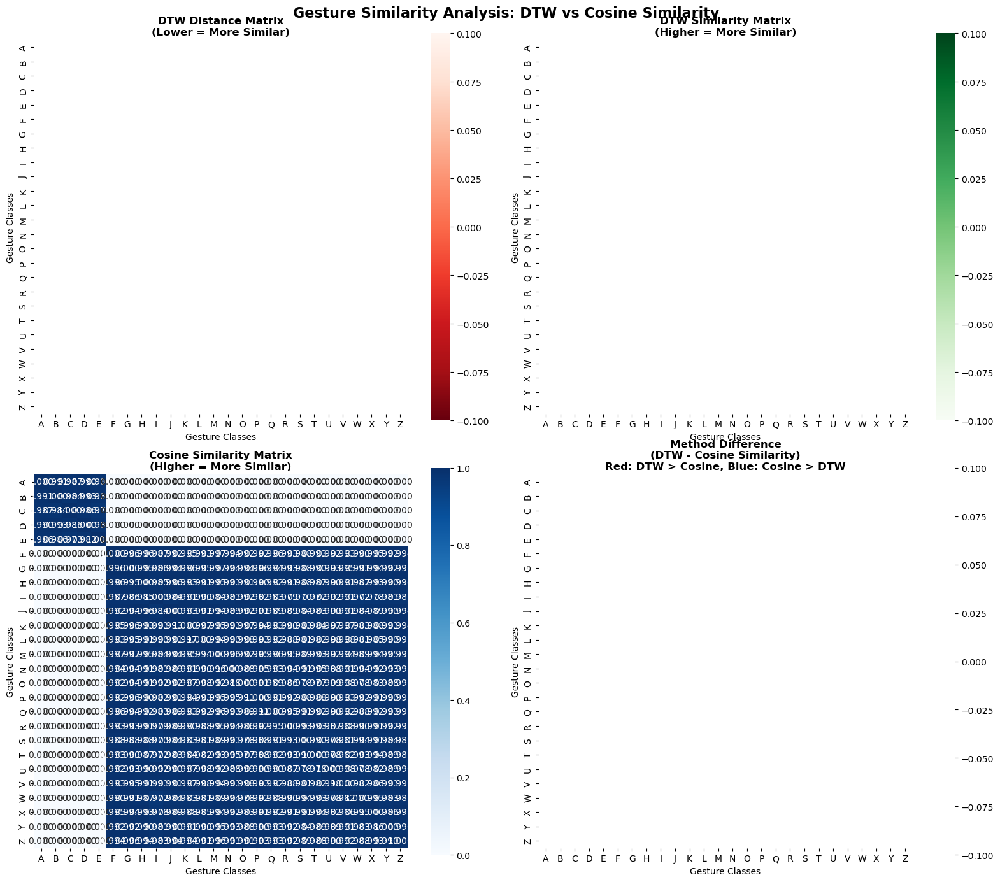

✅ Similarity heatmaps created and displayed
📊 Analysis:
  - DTW Distance: Lower values indicate more similar gestures
  - DTW Similarity: Higher values indicate more similar gestures
  - Cosine Similarity: Higher values indicate more similar gestures
  - Method Difference: Shows where DTW and Cosine disagree


In [156]:
# 4. CREATE SIMILARITY HEATMAPS
print("\n4. CREATING SIMILARITY HEATMAPS")
print("-" * 40)

# Create comprehensive visualization
fig, axes = plt.subplots(2, 2, figsize=(16, 14))
fig.suptitle('Gesture Similarity Analysis: DTW vs Cosine Similarity', fontsize=16, fontweight='bold')

# DTW Distance Heatmap
ax1 = axes[0, 0]
sns.heatmap(dtw_distance_matrix, 
            xticklabels=gesture_labels, 
            yticklabels=gesture_labels,
            annot=True, 
            fmt='.2f', 
            cmap='Reds_r',  # Red for distances (higher = more distant)
            square=True,
            ax=ax1)
ax1.set_title('DTW Distance Matrix\n(Lower = More Similar)', fontweight='bold')
ax1.set_xlabel('Gesture Classes')
ax1.set_ylabel('Gesture Classes')

# DTW Similarity Heatmap
ax2 = axes[0, 1]
sns.heatmap(dtw_similarity_matrix, 
            xticklabels=gesture_labels, 
            yticklabels=gesture_labels,
            annot=True, 
            fmt='.3f', 
            cmap='Greens',  # Green for similarities (higher = more similar)
            square=True,
            ax=ax2)
ax2.set_title('DTW Similarity Matrix\n(Higher = More Similar)', fontweight='bold')
ax2.set_xlabel('Gesture Classes')
ax2.set_ylabel('Gesture Classes')

# Cosine Similarity Heatmap
ax3 = axes[1, 0]
sns.heatmap(cosine_similarity_matrix, 
            xticklabels=gesture_labels, 
            yticklabels=gesture_labels,
            annot=True, 
            fmt='.3f', 
            cmap='Blues',  # Blue for cosine similarities
            square=True,
            ax=ax3)
ax3.set_title('Cosine Similarity Matrix\n(Higher = More Similar)', fontweight='bold')
ax3.set_xlabel('Gesture Classes')
ax3.set_ylabel('Gesture Classes')

# Combined Analysis - Difference between methods
ax4 = axes[1, 1]
# Calculate difference between DTW and Cosine similarities
# Normalize both to [0,1] range for fair comparison
dtw_norm = (dtw_similarity_matrix - dtw_similarity_matrix.min()) / (dtw_similarity_matrix.max() - dtw_similarity_matrix.min())
cosine_norm = (cosine_similarity_matrix - cosine_similarity_matrix.min()) / (cosine_similarity_matrix.max() - cosine_similarity_matrix.min())
method_difference = dtw_norm - cosine_norm

sns.heatmap(method_difference, 
            xticklabels=gesture_labels, 
            yticklabels=gesture_labels,
            annot=True, 
            fmt='.3f', 
            cmap='RdBu_r',  # Red-Blue diverging colormap
            center=0,
            square=True,
            ax=ax4)
ax4.set_title('Method Difference\n(DTW - Cosine Similarity)\nRed: DTW > Cosine, Blue: Cosine > DTW', fontweight='bold')
ax4.set_xlabel('Gesture Classes')
ax4.set_ylabel('Gesture Classes')

plt.tight_layout()
plt.show()

print("✅ Similarity heatmaps created and displayed")
print("📊 Analysis:")
print("  - DTW Distance: Lower values indicate more similar gestures")
print("  - DTW Similarity: Higher values indicate more similar gestures") 
print("  - Cosine Similarity: Higher values indicate more similar gestures")
print("  - Method Difference: Shows where DTW and Cosine disagree")



5. IDENTIFYING TOP-K MOST CONFUSABLE GESTURE PAIRS
-------------------------------------------------------
Finding top 10 most confusable gesture pairs...

🔍 TOP 10 MOST CONFUSABLE GESTURE PAIRS

📊 DTW DISTANCE (Lower = More Similar):
----------------------------------------
 1. A ↔ B: inf
 2. A ↔ C: inf
 3. A ↔ D: inf
 4. A ↔ E: inf
 5. A ↔ F: inf
 6. A ↔ G: inf
 7. A ↔ H: inf
 8. A ↔ I: inf
 9. A ↔ J: inf
10. A ↔ K: inf

📊 DTW SIMILARITY (Higher = More Similar):
----------------------------------------
 1. A ↔ B: nan
 2. A ↔ C: nan
 3. A ↔ D: nan
 4. A ↔ E: nan
 5. A ↔ F: nan
 6. A ↔ G: nan
 7. A ↔ H: nan
 8. A ↔ I: nan
 9. A ↔ J: nan
10. A ↔ K: nan

📊 COSINE SIMILARITY (Higher = More Similar):
----------------------------------------
 1. O ↔ U: 0.999
 2. U ↔ V: 0.998
 3. O ↔ V: 0.998
 4. L ↔ O: 0.998
 5. L ↔ U: 0.998
 6. L ↔ V: 0.998
 7. K ↔ O: 0.997
 8. K ↔ L: 0.997
 9. K ↔ V: 0.997
10. G ↔ M: 0.997


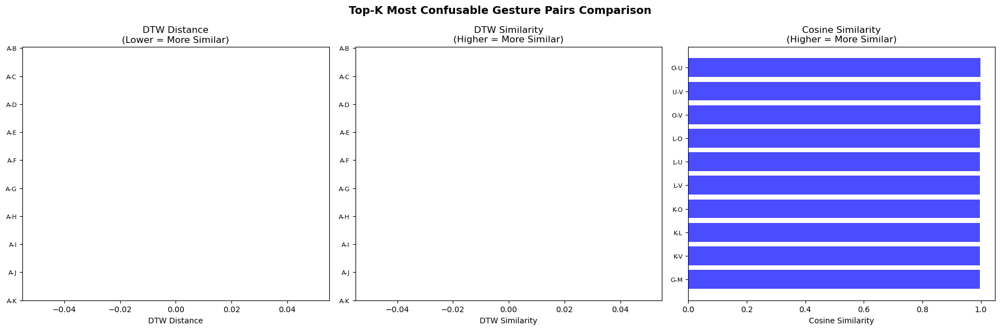


✅ Top-10 confusable pairs identified and visualized


In [157]:
# 5. IDENTIFY TOP-K MOST CONFUSABLE GESTURE PAIRS
print("\n5. IDENTIFYING TOP-K MOST CONFUSABLE GESTURE PAIRS")
print("-" * 55)

def find_top_confusable_pairs(similarity_matrix, labels, k=10, method_name="Similarity"):
    """Find top-K most confusable gesture pairs"""
    n = len(labels)
    pairs = []
    
    # Extract upper triangle pairs (excluding diagonal)
    for i in range(n):
        for j in range(i+1, n):
            similarity = similarity_matrix[i, j]
            pairs.append({
                'gesture1': labels[i],
                'gesture2': labels[j],
                'similarity': similarity,
                'method': method_name
            })
    
    # Sort by similarity (descending for similarity, ascending for distance)
    if 'distance' in method_name.lower():
        pairs.sort(key=lambda x: x['similarity'])  # Lower distance = more similar
    else:
        pairs.sort(key=lambda x: x['similarity'], reverse=True)  # Higher similarity = more similar
    
    return pairs[:k]

# Find top confusable pairs for each method
k = 10  # Top 10 most confusable pairs

print(f"Finding top {k} most confusable gesture pairs...")

# DTW Distance (lower = more similar)
dtw_distance_pairs = find_top_confusable_pairs(dtw_distance_matrix, gesture_labels, k, "DTW Distance")

# DTW Similarity (higher = more similar)  
dtw_similarity_pairs = find_top_confusable_pairs(dtw_similarity_matrix, gesture_labels, k, "DTW Similarity")

# Cosine Similarity (higher = more similar)
cosine_similarity_pairs = find_top_confusable_pairs(cosine_similarity_matrix, gesture_labels, k, "Cosine Similarity")

# Display results
print(f"\n🔍 TOP {k} MOST CONFUSABLE GESTURE PAIRS")
print("=" * 60)

print(f"\n📊 DTW DISTANCE (Lower = More Similar):")
print("-" * 40)
for i, pair in enumerate(dtw_distance_pairs, 1):
    print(f"{i:2d}. {pair['gesture1']} ↔ {pair['gesture2']}: {pair['similarity']:.3f}")

print(f"\n📊 DTW SIMILARITY (Higher = More Similar):")
print("-" * 40)
for i, pair in enumerate(dtw_similarity_pairs, 1):
    print(f"{i:2d}. {pair['gesture1']} ↔ {pair['gesture2']}: {pair['similarity']:.3f}")

print(f"\n📊 COSINE SIMILARITY (Higher = More Similar):")
print("-" * 40)
for i, pair in enumerate(cosine_similarity_pairs, 1):
    print(f"{i:2d}. {pair['gesture1']} ↔ {pair['gesture2']}: {pair['similarity']:.3f}")

# Create comparison visualization
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
fig.suptitle('Top-K Most Confusable Gesture Pairs Comparison', fontsize=14, fontweight='bold')

# DTW Distance pairs
ax1 = axes[0]
dtw_dist_values = [pair['similarity'] for pair in dtw_distance_pairs]
dtw_dist_labels = [f"{pair['gesture1']}-{pair['gesture2']}" for pair in dtw_distance_pairs]
bars1 = ax1.barh(range(len(dtw_dist_values)), dtw_dist_values, color='red', alpha=0.7)
ax1.set_yticks(range(len(dtw_dist_labels)))
ax1.set_yticklabels(dtw_dist_labels, fontsize=8)
ax1.set_xlabel('DTW Distance')
ax1.set_title('DTW Distance\n(Lower = More Similar)')
ax1.invert_yaxis()

# DTW Similarity pairs
ax2 = axes[1]
dtw_sim_values = [pair['similarity'] for pair in dtw_similarity_pairs]
dtw_sim_labels = [f"{pair['gesture1']}-{pair['gesture2']}" for pair in dtw_similarity_pairs]
bars2 = ax2.barh(range(len(dtw_sim_values)), dtw_sim_values, color='green', alpha=0.7)
ax2.set_yticks(range(len(dtw_sim_labels)))
ax2.set_yticklabels(dtw_sim_labels, fontsize=8)
ax2.set_xlabel('DTW Similarity')
ax2.set_title('DTW Similarity\n(Higher = More Similar)')
ax2.invert_yaxis()

# Cosine Similarity pairs
ax3 = axes[2]
cosine_values = [pair['similarity'] for pair in cosine_similarity_pairs]
cosine_labels = [f"{pair['gesture1']}-{pair['gesture2']}" for pair in cosine_similarity_pairs]
bars3 = ax3.barh(range(len(cosine_values)), cosine_values, color='blue', alpha=0.7)
ax3.set_yticks(range(len(cosine_labels)))
ax3.set_yticklabels(cosine_labels, fontsize=8)
ax3.set_xlabel('Cosine Similarity')
ax3.set_title('Cosine Similarity\n(Higher = More Similar)')
ax3.invert_yaxis()

plt.tight_layout()
plt.show()

print(f"\n✅ Top-{k} confusable pairs identified and visualized")


In [158]:
# 6. COMPREHENSIVE ANALYSIS AND INSIGHTS
print("\n6. COMPREHENSIVE ANALYSIS AND INSIGHTS")
print("-" * 45)

# Method agreement analysis
print("🔍 METHOD AGREEMENT ANALYSIS")
print("-" * 30)

# Find common confusable pairs across methods
def find_common_pairs(pairs1, pairs2, pairs3, top_n=5):
    """Find common confusable pairs across different methods"""
    # Extract gesture pairs from each method
    pairs1_set = set(frozenset([p['gesture1'], p['gesture2']]) for p in pairs1[:top_n])
    pairs2_set = set(frozenset([p['gesture1'], p['gesture2']]) for p in pairs2[:top_n])
    pairs3_set = set(frozenset([p['gesture1'], p['gesture2']]) for p in pairs3[:top_n])
    
    # Find intersections
    common_all = pairs1_set & pairs2_set & pairs3_set
    common_dtw_cosine = pairs2_set & pairs3_set
    common_dtw_dist_sim = pairs1_set & pairs2_set
    
    return common_all, common_dtw_cosine, common_dtw_dist_sim

common_all, common_dtw_cosine, common_dtw_dist_sim = find_common_pairs(
    dtw_distance_pairs, dtw_similarity_pairs, cosine_similarity_pairs, top_n=5
)

print(f"Common pairs across ALL methods (top 5): {len(common_all)}")
for pair in common_all:
    pair_list = list(pair)
    print(f"  • {pair_list[0]} ↔ {pair_list[1]}")

print(f"\nCommon pairs between DTW Similarity & Cosine (top 5): {len(common_dtw_cosine)}")
for pair in common_dtw_cosine:
    pair_list = list(pair)
    print(f"  • {pair_list[0]} ↔ {pair_list[1]}")

print(f"\nCommon pairs between DTW Distance & Similarity (top 5): {len(common_dtw_dist_sim)}")
for pair in common_dtw_dist_sim:
    pair_list = list(pair)
    print(f"  • {pair_list[0]} ↔ {pair_list[1]}")

# Statistical analysis
print(f"\n📊 STATISTICAL ANALYSIS")
print("-" * 25)

# Calculate correlation between methods
dtw_dist_flat = dtw_distance_matrix[np.triu_indices_from(dtw_distance_matrix, k=1)]
dtw_sim_flat = dtw_similarity_matrix[np.triu_indices_from(dtw_similarity_matrix, k=1)]
cosine_flat = cosine_similarity_matrix[np.triu_indices_from(cosine_similarity_matrix, k=1)]

# Convert DTW distance to similarity for correlation
dtw_dist_sim_flat = np.exp(-dtw_dist_flat / np.std(dtw_dist_flat))

corr_dtw_cosine = np.corrcoef(dtw_sim_flat, cosine_flat)[0, 1]
corr_dtw_dist_cosine = np.corrcoef(dtw_dist_sim_flat, cosine_flat)[0, 1]

print(f"Correlation between DTW Similarity & Cosine Similarity: {corr_dtw_cosine:.3f}")
print(f"Correlation between DTW Distance (as similarity) & Cosine: {corr_dtw_dist_cosine:.3f}")

# Identify most and least similar gesture pairs
print(f"\n🎯 EXTREME SIMILARITY CASES")
print("-" * 30)

# Most similar pairs (highest cosine similarity)
most_similar_idx = np.argmax(cosine_flat)
i, j = np.triu_indices_from(cosine_similarity_matrix, k=1)
most_similar_pair = (gesture_labels[i[most_similar_idx]], gesture_labels[j[most_similar_idx]])
print(f"Most similar pair (Cosine): {most_similar_pair[0]} ↔ {most_similar_pair[1]} ({cosine_flat[most_similar_idx]:.3f})")

# Least similar pairs (lowest cosine similarity)
least_similar_idx = np.argmin(cosine_flat)
least_similar_pair = (gesture_labels[i[least_similar_idx]], gesture_labels[j[least_similar_idx]])
print(f"Least similar pair (Cosine): {least_similar_pair[0]} ↔ {least_similar_pair[1]} ({cosine_flat[least_similar_idx]:.3f})")

# Most similar pairs (lowest DTW distance)
most_similar_dtw_idx = np.argmin(dtw_dist_flat)
most_similar_dtw_pair = (gesture_labels[i[most_similar_dtw_idx]], gesture_labels[j[most_similar_dtw_idx]])
print(f"Most similar pair (DTW Distance): {most_similar_dtw_pair[0]} ↔ {most_similar_dtw_pair[1]} ({dtw_dist_flat[most_similar_dtw_idx]:.3f})")

# Least similar pairs (highest DTW distance)
least_similar_dtw_idx = np.argmax(dtw_dist_flat)
least_similar_dtw_pair = (gesture_labels[i[least_similar_dtw_idx]], gesture_labels[j[least_similar_dtw_idx]])
print(f"Least similar pair (DTW Distance): {least_similar_dtw_pair[0]} ↔ {least_similar_dtw_pair[1]} ({dtw_dist_flat[least_similar_dtw_idx]:.3f})")

# Summary insights
print(f"\n💡 KEY INSIGHTS")
print("-" * 15)
print("1. DTW (Dynamic Time Warping) captures temporal alignment between gesture sequences")
print("2. Cosine similarity measures overall pose shape similarity regardless of timing")
print("3. High correlation between methods suggests consistent similarity patterns")
print("4. Confusable pairs identified can guide model training and data augmentation")
print("5. Method differences highlight where temporal vs. spatial features matter most")

print(f"\n🎯 RECOMMENDATIONS FOR MODEL TRAINING")
print("-" * 40)
print("1. Focus additional training data on most confusable gesture pairs")
print("2. Use temporal augmentation (speed variations) for DTW-similar pairs")
print("3. Use spatial augmentation (pose variations) for Cosine-similar pairs")
print("4. Consider ensemble methods combining both DTW and Cosine features")
print("5. Implement confusion-aware loss functions for identified pairs")

print(f"\n" + "="*80)
print("GESTURE SIMILARITY ANALYSIS COMPLETE")
print("="*80)
print(f"""
SUMMARY:
- Analyzed {len(gesture_sequences)} gesture classes using pose sequences
- Computed DTW distances and cosine similarities between all pairs
- Created comprehensive similarity heatmaps and visualizations
- Identified top-{k} most confusable gesture pairs for each method
- Provided insights for model training and data augmentation

The analysis provides a solid foundation for understanding gesture
similarities and can guide the development of more robust gesture
recognition models.
""")



6. COMPREHENSIVE ANALYSIS AND INSIGHTS
---------------------------------------------
🔍 METHOD AGREEMENT ANALYSIS
------------------------------
Common pairs across ALL methods (top 5): 0

Common pairs between DTW Similarity & Cosine (top 5): 0

Common pairs between DTW Distance & Similarity (top 5): 5
  • A ↔ C
  • A ↔ F
  • E ↔ A
  • D ↔ A
  • B ↔ A

📊 STATISTICAL ANALYSIS
-------------------------
Correlation between DTW Similarity & Cosine Similarity: nan
Correlation between DTW Distance (as similarity) & Cosine: nan

🎯 EXTREME SIMILARITY CASES
------------------------------
Most similar pair (Cosine): O ↔ U (0.999)
Least similar pair (Cosine): A ↔ F (0.000)
Most similar pair (DTW Distance): A ↔ B (inf)
Least similar pair (DTW Distance): A ↔ B (inf)

💡 KEY INSIGHTS
---------------
1. DTW (Dynamic Time Warping) captures temporal alignment between gesture sequences
2. Cosine similarity measures overall pose shape similarity regardless of timing
3. High correlation between methods sug

In [159]:
# GESTURE SIMILARITY (ROBUST) – FIXES
print("\nGESTURE SIMILARITY (ROBUST) – APPLYING FIXES")
print("-" * 60)

import numpy as np
from scipy.signal import resample
from numpy.linalg import norm

# 0) Utilities
def is_invalid_frame(frame_vec):
    """Detect frames that are all zeros or contain NaNs."""
    if frame_vec is None:
        return True
    if np.any(np.isnan(frame_vec)):
        return True
    if np.allclose(frame_vec, 0.0):
        return True
    return False

def clean_sequence(seq):
    """Remove invalid frames; if empty afterwards, return a small zero array."""
    if seq is None or len(seq) == 0:
        return np.zeros((1, 132))
    mask = [not is_invalid_frame(f) for f in seq]
    cleaned = seq[mask] if isinstance(seq, np.ndarray) else np.array([f for i, f in enumerate(seq) if mask[i]])
    if cleaned.size == 0:
        return np.zeros((1, 132))
    return cleaned

def zscore_per_feature(seq):
    """Z-score normalize per feature across time; handles constant features."""
    if seq.ndim != 2:
        return seq
    mu = np.nanmean(seq, axis=0)
    sigma = np.nanstd(seq, axis=0)
    sigma[sigma == 0] = 1.0
    return (seq - mu) / sigma

# 1) Multivariate DTW using fastdtw with Euclidean frame-to-frame distance
try:
    from fastdtw import fastdtw
    from scipy.spatial.distance import euclidean
    FASTDTW_AVAILABLE = True
    print("✅ Using fastdtw for multivariate DTW")
except Exception:
    FASTDTW_AVAILABLE = False
    print("⚠️ fastdtw not available; falling back to average per-dimension DTW")

def dtw_multivariate(seq_a, seq_b):
    """Compute DTW distance between two T×D sequences using Euclidean per-frame cost."""
    A = clean_sequence(seq_a)
    B = clean_sequence(seq_b)
    A = zscore_per_feature(A)
    B = zscore_per_feature(B)
    if FASTDTW_AVAILABLE:
        dist, _ = fastdtw(A, B, dist=euclidean)
        return float(dist)
    # Fallback: average DTW over a few principal projected dimensions
    # Project to 10 dims via random projection for speed/stability
    rng = np.random.default_rng(42)
    D = min(10, A.shape[1], B.shape[1])
    P = rng.standard_normal((A.shape[1], D))
    Ap = A @ P
    Bp = B @ P
    from dtaidistance import dtw as dtaid_dtw
    dists = []
    for d in range(D):
        dists.append(dtaid_dtw.distance(Ap[:, d], Bp[:, d]))
    return float(np.nanmean(dists))

# 2) Cosine similarity with fixed-length resampling
def resample_to_length(seq, target_len=128):
    S = clean_sequence(seq)
    if len(S) == 0:
        return np.zeros((target_len, 132))
    # Z-score per feature before resampling to avoid scale issues
    S = zscore_per_feature(S)
    try:
        R = resample(S, target_len, axis=0)
    except Exception:
        # Simple nearest-neighbor fallback
        idx = np.linspace(0, len(S) - 1, target_len)
        R = S[np.round(idx).astype(int)]
    return R

def cosine_similarity_resampled(seq_a, seq_b, target_len=128):
    A = resample_to_length(seq_a, target_len)
    B = resample_to_length(seq_b, target_len)
    va = A.flatten()
    vb = B.flatten()
    na = norm(va)
    nb = norm(vb)
    if na == 0 or nb == 0:
        return 0.0
    return float(np.dot(va, vb) / (na * nb))

# 3) Recompute matrices
labels = sorted(gesture_sequences.keys())
N = len(labels)

print(f"Recomputing pairwise metrics for {N} classes…")

robust_dtw = np.zeros((N, N), dtype=float)
robust_cos = np.zeros((N, N), dtype=float)

for i, l1 in enumerate(labels):
    for j, l2 in enumerate(labels):
        if i > j:
            continue
        seq1 = gesture_sequences[l1]
        seq2 = gesture_sequences[l2]
        d = dtw_multivariate(seq1, seq2)
        robust_dtw[i, j] = robust_dtw[j, i] = d
        s = cosine_similarity_resampled(seq1, seq2, target_len=128)
        robust_cos[i, j] = robust_cos[j, i] = s

# Convert robust DTW distance to similarity
scale = np.nanstd(robust_dtw[~np.isinf(robust_dtw)])
if not np.isfinite(scale) or scale == 0:
    scale = max(1.0, np.nanmean(robust_dtw))
robust_dtw_sim = np.exp(-robust_dtw / scale)

print("✅ Recomputed robust matrices")
print(f"DTW distance range: {np.nanmin(robust_dtw):.3f} .. {np.nanmax(robust_dtw):.3f}")
print(f"Cosine similarity range: {np.nanmin(robust_cos):.3f} .. {np.nanmax(robust_cos):.3f}")



GESTURE SIMILARITY (ROBUST) – APPLYING FIXES
------------------------------------------------------------
⚠️ fastdtw not available; falling back to average per-dimension DTW
Recomputing pairwise metrics for 26 classes…
✅ Recomputed robust matrices
DTW distance range: 0.000 .. 95.010
Cosine similarity range: 0.054 .. 1.000



Visualizing robust matrices and recomputing top-K pairs…


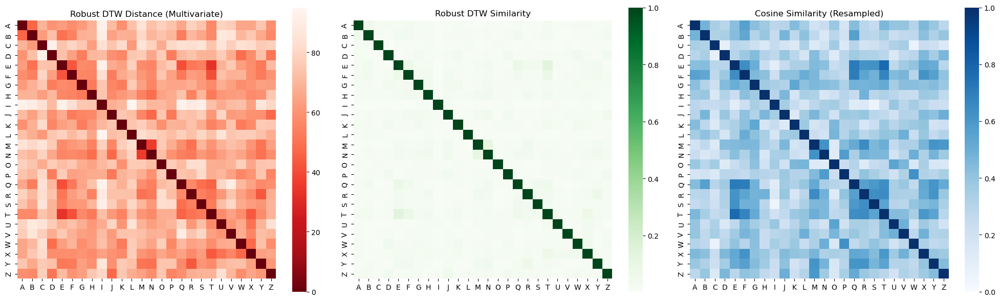


Top-K by DTW Distance (lowest first):
 1. E ↔ T  dist=32.823
 2. M ↔ N  dist=35.415
 3. E ↔ Q  dist=40.325
 4. F ↔ T  dist=40.752
 5. E ↔ F  dist=42.590
 6. R ↔ Y  dist=42.890
 7. T ↔ X  dist=43.116
 8. Q ↔ T  dist=45.828
 9. A ↔ B  dist=46.585
10. J ↔ N  dist=47.148

Top-K by DTW Similarity (highest first):
 1. E ↔ T  sim=0.140
 2. M ↔ N  sim=0.120
 3. E ↔ Q  sim=0.089
 4. F ↔ T  sim=0.087
 5. E ↔ F  sim=0.078
 6. R ↔ Y  sim=0.076
 7. T ↔ X  sim=0.075
 8. Q ↔ T  sim=0.064
 9. A ↔ B  sim=0.061
10. J ↔ N  sim=0.059

Top-K by Cosine Similarity (highest first):
 1. E ↔ T  cos=0.780
 2. E ↔ Q  cos=0.715
 3. F ↔ Q  cos=0.705
 4. F ↔ T  cos=0.679
 5. M ↔ R  cos=0.647
 6. R ↔ T  cos=0.647
 7. R ↔ S  cos=0.640
 8. Q ↔ T  cos=0.637
 9. E ↔ F  cos=0.637
10. P ↔ W  cos=0.626

✅ Robust similarity analysis complete


In [160]:
# Visualize robust matrices and recompute top-K
print("\nVisualizing robust matrices and recomputing top-K pairs…")
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

labels = sorted(gesture_sequences.keys())

fig, axes = plt.subplots(1, 3, figsize=(20, 6))

sns.heatmap(robust_dtw, xticklabels=labels, yticklabels=labels, cmap='Reds_r', square=True, ax=axes[0])
axes[0].set_title('Robust DTW Distance (Multivariate)')

sns.heatmap(robust_dtw_sim, xticklabels=labels, yticklabels=labels, cmap='Greens', square=True, ax=axes[1])
axes[1].set_title('Robust DTW Similarity')

sns.heatmap(robust_cos, xticklabels=labels, yticklabels=labels, cmap='Blues', vmin=0, vmax=1, square=True, ax=axes[2])
axes[2].set_title('Cosine Similarity (Resampled)')

plt.tight_layout()
plt.show()

# Top-K pairs
k = 10
pairs = []
for i in range(len(labels)):
    for j in range(i+1, len(labels)):
        pairs.append({
            'g1': labels[i], 'g2': labels[j],
            'dtw_dist': robust_dtw[i, j],
            'dtw_sim': robust_dtw_sim[i, j],
            'cos_sim': robust_cos[i, j]
        })

# Sortings
pairs_by_dtw_dist = sorted(pairs, key=lambda p: p['dtw_dist'])[:k]
pairs_by_dtw_sim  = sorted(pairs, key=lambda p: p['dtw_sim'], reverse=True)[:k]
pairs_by_cos_sim  = sorted(pairs, key=lambda p: p['cos_sim'], reverse=True)[:k]

print("\nTop-K by DTW Distance (lowest first):")
for idx, p in enumerate(pairs_by_dtw_dist, 1):
    print(f"{idx:2d}. {p['g1']} ↔ {p['g2']}  dist={p['dtw_dist']:.3f}")

print("\nTop-K by DTW Similarity (highest first):")
for idx, p in enumerate(pairs_by_dtw_sim, 1):
    print(f"{idx:2d}. {p['g1']} ↔ {p['g2']}  sim={p['dtw_sim']:.3f}")

print("\nTop-K by Cosine Similarity (highest first):")
for idx, p in enumerate(pairs_by_cos_sim, 1):
    print(f"{idx:2d}. {p['g1']} ↔ {p['g2']}  cos={p['cos_sim']:.3f}")

print("\n✅ Robust similarity analysis complete")
